### Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import umap
from sklearn.cluster import HDBSCAN
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import math
import os
import cv2
from tqdm import tqdm
import ipywidgets as widgets
from IPython.display import display
import joblib
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import holoviews as hv
from holoviews import opts, dim
from statesegmentation import GSBS
from matplotlib import patches
%matplotlib inline

### Functions

#### Data transformation

In [2]:
def transform_mousecentric(df, main_dir, mouse):
    '''
    Transforms data into mouse-centric version.

    Parameters:
    df (pd.DataFrame): The input data.
    main_dir (str): The main directory containing transformation results.
    mouse (str): Mouse identifier.

    Returns:
    pd.DataFrame: Transformed data in mouse-centric version.
    '''
    
    folder_path = main_dir + "/Datasets/MouseCentric"
    file_path = f'/{mouse}_MouseCentric_data.csv'
    if not os.path.exists(folder_path + file_path):
    
        mc_df = df.copy()
        mc_df = mc_df.iloc[:, 1:-1]
        mc_df = mc_df.astype(float)

        s1_x = mc_df.iloc[:,39].copy()
        s1_y = mc_df.iloc[:,40].copy()

        for column_index in range(0, len(mc_df.columns), 3):
            x_column = mc_df.columns[column_index]
            y_column = mc_df.columns[column_index+1]

            x = mc_df[x_column]
            y = mc_df[y_column]

            transformed_x = x - s1_x
            transformed_y = y - s1_y

            mc_df[x_column] = transformed_x
            mc_df[y_column] = transformed_y

        mc_df.iloc[:,39]=s1_x
        mc_df.iloc[:,40]=s1_y
        mc_df.insert(0, 'frame_number', df['frame_number'])
        mc_df['mouse_no'] = float(mouse)

        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        mc_df.to_csv(folder_path + file_path, index=False)
        
    else:
        mc_df = pd.read_csv(folder_path + file_path)
        
    return mc_df
    
def transform_changecoord(df, main_dir, mouse):
    '''
    Transforms data into change coordinate version.

    Parameters:
    df (pd.DataFrame): The input data.
    main_dir (str): The main directory containing transformation results.
    mouse (str): Mouse identifier.

    Returns:
    pd.DataFrame: Transformed data in change coordinate version.
    '''
    folder_path = main_dir + "/Datasets/ChangeCoords"
    file_path = f'/{mouse}_ChangeCoords_data.csv'
    if not os.path.exists(folder_path + file_path):
    
        cc_df = df.copy()
        cc_df = cc_df.iloc[:, 1:-1]
        cc_df = cc_df.astype(float)

        for column_index in range(0, len(cc_df.columns), 3):
            x_column = cc_df.columns[column_index]
            y_column = cc_df.columns[column_index+1]

            cc_df[x_column] = cc_df[x_column] - cc_df[x_column].shift(1)
            cc_df[y_column] = cc_df[y_column] - cc_df[y_column].shift(1)

            cc_df[x_column] = cc_df[x_column].fillna(0)
            cc_df[y_column] = cc_df[y_column].fillna(0)

        cc_df.insert(0, 'frame_number', df['frame_number'])
        cc_df['mouse_no'] = float(mouse)
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        cc_df.to_csv(folder_path + file_path, index=False)
        
    else:
        cc_df = pd.read_csv(folder_path + file_path)
    return cc_df
    
def transform_mcpolar(mc_df, main_dir, mouse):
    '''
    Transforms data into mouse-centric polar coordinates version.

    Parameters:
    mc_df (pd.DataFrame): The input data in mouse-centric coordinates.
    main_dir (str): The main directory containing transformation results.
    mouse (str): Mouse identifier.

    Returns:
    pd.DataFrame: Transformed data in mouse-centric polar coordinates.
    '''
    folder_path = main_dir + "/Datasets/MouseCentricPolar"
    file_path = f'/{mouse}_MouseCentricPolar_data.csv'
    if not os.path.exists(folder_path + file_path):
    
        mcp_df = mc_df.copy()
        mcp_df = mcp_df.iloc[:,1:-1]
        mcp_df = mcp_df.astype(float)

        for col_x, col_y in zip(coordinates_columns[::2], coordinates_columns[1::2]):
            x = mcp_df[col_x]
            y = mcp_df[col_y]

            r = np.sqrt(x**2 + y**2)
            theta = np.arctan2(y, x)

            mcp_df[col_x] = r
            mcp_df[col_y] = theta

        mcp_df.insert(0, 'frame_number', df['frame_number'])
        mcp_df['mouse_no'] = float(mouse)
        
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        mcp_df.to_csv(folder_path + file_path, index=False)
    
    else:
        mcp_df = pd.read_csv(folder_path + file_path)
    
    return mcp_df
    
def transform_mcdirectional(mc_df, mcp_df, main_dir, mouse):
    '''
    Transforms data into mouse-centric directional coordinates version.

    Parameters:
    mc_df (pd.DataFrame): The input data in mouse-centric coordinates.
    mcp_df (pd.DataFrame): The data in mouse-centric polar coordinates for reference.
    main_dir (str): The main directory containing transformation results.
    mouse (str): Mouse identifier.

    Returns:
    pd.DataFrame: Transformed data in mouse-centric directional coordinates.
    '''
    folder_path = main_dir + "/Datasets/MouseDirectional"
    file_path = f'/{mouse}_MouseDirectional_data.csv'
    if not os.path.exists(folder_path + file_path):
    
        md_df = mc_df.copy()
        md_df = md_df.iloc[:,1:-1]
        md_df = md_df.astype(float)

        coordinates_columns = [col for col in md_df.columns if 'x' in col or 'y' in col]

        for frame_number, frame_data_polar in mcp_df.groupby('frame_number'):

            rotation_angle = frame_data_polar.at[frame_data_polar.index[0], "('S2', 'y')"]
            affine_matrix = np.array([[np.cos(rotation_angle), -np.sin(rotation_angle)],
                                      [np.sin(rotation_angle), np.cos(rotation_angle)]])

            for col_x, col_y in zip(coordinates_columns[::2], coordinates_columns[1::2]):

                x = md_df[col_x]
                y = md_df[col_y]

                points = np.column_stack((x, y))
                transformed_points = np.dot(points[frame_number], affine_matrix)

                md_df.at[frame_number, col_x] = transformed_points[0]
                md_df.at[frame_number, col_y] = transformed_points[1]

        md_df.insert(0, 'frame_number', mc_df['frame_number'])
        md_df['mouse_no'] = float(mouse)
        
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        md_df.to_csv(folder_path + file_path, index=False)
    
    else:
        md_df = pd.read_csv(folder_path + file_path)
    
    return md_df

def transform_mcdirectionalpolar(md_df, main_dir, mouse):
    '''
    Transforms data into mouse-centric directional polar coordinates version.

    Parameters:
    md_df (pd.DataFrame): The input data in mouse-centric directional coordinates.
    main_dir (str): The main directory containing transformation results.
    mouse (str): Mouse identifier.

    Returns:
    pd.DataFrame: Transformed data in mouse-centric directional polar coordinates.
    '''
    folder_path = main_dir + "/Datasets/MouseDirectionalPolar"
    file_path = f'/{mouse}_MouseDirectionalPolar_data.csv'
    if not os.path.exists(folder_path + file_path):
        
        mdp_df = md_df.copy()
        mdp_df = mdp_df.iloc[:,1:-1]
        mdp_df = mdp_df.astype(float)
        
        coordinates_columns = [col for col in md_df.columns if 'x' in col or 'y' in col]
        
        for col_x, col_y in zip(coordinates_columns[::2], coordinates_columns[1::2]):
            x = mdp_df[col_x]
            y = mdp_df[col_y]
            
            r = np.sqrt(x**2, y**2)
            theta = np.arctan2(y, x)
            
            mdp_df[col_x] = r
            mdp_df[col_y] = theta
            
        mdp_df.insert(0, 'frame_number', md_df['frame_number'])
        mdp_df['mouse_no'] = float(mouse)
        
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        mdp_df.to_csv(folder_path + file_path, index=False)
    
    else:
        mdp_df = pd.read_csv(folder_path + file_path)
    
    return mdp_df

def create_dataset(main_dir: str, datatype: str):
    '''
    Create data files with the given transformation type from the original data in the given main directory.

    Parameters:
    main_dir (str): The main directory containing the original data and transformation results.
    datatype (str): The type of data transformation to apply.

    Returns:
    pd.DataFrame: The dataset created based on the specified data transformation.

    Supported 'datatype' values:
    - "Original": Original data.
    - "MouseCentric": Mouse-centric data.
    - "MouseCentricPolar": Mouse-centric polar data.
    - "ChangeCoord": Data with changed coordinates.
    - "MouseDirectional": Mouse-centric directional data.
    - "MouseDirectionalPolar": Mouse-centric directional polar data.
    '''
    folder_path = main_dir + "/Datasets/Original"
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    dataframes = []
    
    filtered_dir = os.path.join(main_dir, 'filtered')
    files = os.listdir(filtered_dir)
    
    for file in tqdm(files, desc="Processing Files"):
        mouse=file.split("_")[1]+"."+file.split("_")[2][0:-3]
        file=os.path.join(main_dir+'/filtered/', file)
        
        new_file_path = f'/{mouse}_Original_data.csv'
        if not os.path.exists(folder_path + new_file_path):
            df = pd.read_csv(file,header=[1,2])
            df.columns = ['frame_number'] + list(df.columns[1:])
            df['mouse_no'] = float(mouse)
            df.to_csv(folder_path + new_file_path, index=False)
        else:
            df = pd.read_csv(folder_path + new_file_path)

        if datatype == "Original":
            dataframes.append(df)
        elif datatype == "MouseCentric":
            mc_df = transform_mousecentric(df, main_dir, mouse)
            dataframes.append(mc_df)
        elif datatype == "MouseCentricPolar":
            mc_df = transform_mousecentric(df, main_dir, mouse)
            mcp_df = transform_mcpolar(mc_df, main_dir, mouse)
            dataframes.append(mcp_df)
        elif datatype == "ChangeCoord":
            cc_df = transform_changecoord(df, main_dir, mouse)
            dataframes.append(cc_df)
        elif datatype == "MouseDirectional":
            mc_df = transform_mousecentric(df, main_dir, mouse)
            mcp_df = transform_mcpolar(mc_df, main_dir, mouse)
            mcd_df = transform_mcdirectional(mc_df, mcp_df, main_dir, mouse)
            dataframes.append(mcd_df)
        elif datatype == "MouseDirectionalPolar":
            mc_df = transform_mousecentric(df, main_dir, mouse)
            mcp_df = transform_mcpolar(mc_df, main_dir, mouse)
            md_df = transform_mcdirectional(mc_df, mcp_df, main_dir, mouse)
            mdp_df = transform_mcdirectionalpolar(md_df, main_dir, mouse)
            dataframes.append(mdp_df)
    
    dataset = pd.concat(dataframes, ignore_index=True)
    
    return dataset

#### Selecting subset from data

In [3]:
def generate_sub_dataset(dataset, frames_per_video=11250, mouse_number=None):
    """
    Generate a sub-dataset by selecting random videos or videos from a specific mouse
    from the given dataset.

    Args:
    dataset (pd.DataFrame): The original dataset.
    num_videos (int or None): The number of random videos to select. Set to None if specifying a mouse.
    frames_per_video (int): The number of frames per video.
    mouse_number (int or None): The mouse number to select videos for. Set to None for random selection.

    Returns:
    pd.DataFrame: A sub-dataset containing the selected videos.
    """
    if mouse_number is not None:
        # Select videos for a specific mouse
        sub_dataset = dataset[dataset['mouse_no'] == mouse_number]
        print(f'The data for mouse {mouse_number} was extracted.')
        return sub_dataset.reset_index(drop=True)
    else:
        # Generate random video indices
        selected_video_indices = np.random.choice(range(1, 99), size=1, replace=False)

    selected_videos = []

    # Create slices for each selected video
    for video_index in selected_video_indices:
        # Calculate the starting and ending frame indices for the video
        start_frame = video_index * frames_per_video
        end_frame = (video_index + 1) * frames_per_video
        # Use .loc to create a slice by row index
        video_slice = dataset.loc[start_frame:end_frame - 1]
        selected_videos.append(video_slice)

    # Concatenate the selected videos to create a sub-dataset
    sub_dataset = pd.concat(selected_videos, ignore_index=True)
    print("The following mice were randomly selected: "+ " ".join(map(str, sub_dataset['mouse_no'].unique())))
    return sub_dataset


#### PCA and visualisation

In [4]:
def visualize_pca(data, n_components=2, save_dir=os.getcwd(), rnn_latents = False):
    '''
    Visualize data using PCA with adjustable hyperparameters.

    Parameters:
    data (pd.DataFrame): The data to visualize.
    n_neighbors (int): The number of neighbors for UMAP.
    min_dist (float): The minimum distance between points in UMAP.
    n_components (int): The number of UMAP dimensions to reduce to (2 or 3).
    save_dir (str): Directory to save the fitted UMAP in.

    Returns:
    PCA fit and transform results
    '''
    pca_model = PCA(n_components=n_components)
    pca_result = pca_model.fit_transform(data.iloc[:, 1:-2])
    
    # Save the pca model for later use
    if len(data['mouse_no'].unique()) == 1:
        mouse_no = data['mouse_no'].unique().item()
        joblib.dump(pca_model, save_dir+f"pca_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
    elif rnn_latents == True:
        joblib.dump(pca_model, save_dir+f"RNN-latents_pca_model_{datatype}_data_{n_components}-dimensional.pkl")
    else:
        joblib.dump(pca_model, save_dir+f"pca_model_{datatype}_data_{n_components}-dimensional.pkl")
    
    # Get explained variance
    explained_variance = pca_model.explained_variance_ratio_

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.plot(np.cumsum(explained_variance))
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.title('Explained Variance vs. Number of Components')
    plt.grid(True)
    plt.show()
                                         
    if n_components == 2:
        # 2D plot
        plt.figure(figsize=(8, 6))
        plt.scatter(pca_result[:, 0], pca_result[:, 1], alpha=0.1)
        plt.title("PCA 2D Visualization")
        plt.xlabel("PCA Dimension 1")
        plt.ylabel("PCA Dimension 2")
        plt.show()
    elif n_components == 3:
        # 3D plot
        fig = plt.figure(figsize=(14, 6))
        ax = fig.add_subplot(121, projection='3d')  # 3D plot
        ax.scatter(pca_result[:, 0], pca_result[:, 1], pca_result[:, 2], alpha=0.1)
        ax.set_title("PCA 3D Visualization")
        ax.set_xlabel("PCA Dimension 1")
        ax.set_ylabel("PCA Dimension 2")
        ax.set_zlabel("PCA Dimension 3")

        # 2D plot of first 2 dimensions
        ax2 = fig.add_subplot(122)
        ax2.scatter(pca_result[:, 0], pca_result[:, 1], alpha=0.1)
        ax2.set_title("PCA 2D Visualization (1st and 2nd dimensions)")
        ax2.set_xlabel("PCA Dimension 1")
        ax2.set_ylabel("PCA Dimension 2")
        plt.show()
    
    return pca_result

#### UMAP and visualisation

In [5]:
def visualize_umap(data, n_neighbors=15, min_dist=0.1, n_components=2, save_dir=os.getcwd(), rnn_latents=False, supervised=False):
    '''
    Visualize data using UMAP with adjustable hyperparameters.

    Parameters:
    data (pd.DataFrame): The data to visualize.
    n_neighbors (int): The number of neighbors for UMAP.
    min_dist (float): The minimum distance between points in UMAP.
    n_components (int): The number of UMAP dimensions to reduce to (2 or 3).
    save_dir (str): Directory to save the fitted UMAP in.

    Returns:
    UMAP fit and transform results
    '''
    umap_model = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components)
    if supervised:
        umap_result = umap_model.fit_transform(data.iloc[:, 1:-2], y=data['Freezing_label'])
    else:
        umap_result = umap_model.fit_transform(data.iloc[:, 1:-2])
    
    # Save the umap model for later use
    if len(data['mouse_no'].unique()) == 1:
        mouse_no = data['mouse_no'].unique().item()
        if rnn_latents == False:
            joblib.dump(umap_model, save_dir+f"umap_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
        else:
            joblib.dump(umap_model, save_dir+f"rnn_latents_umap_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
    elif rnn_latents == True:
        joblib.dump(umap_model, save_dir+f"rnn_latents_umap_model_{datatype}_data_{n_components}-dimensional.pkl")
    else:
        joblib.dump(umap_model, save_dir+f"umap_model_{datatype}_data_{n_components}-dimensional.pkl")
    
    if n_components == 2:
        # 2D plot
        plt.figure(figsize=(8, 6))
        plt.scatter(umap_result[:, 0], umap_result[:, 1], alpha=0.1)
        plt.title("UMAP 2D Visualization")
        plt.xlabel("UMAP Dimension 1")
        plt.ylabel("UMAP Dimension 2")
        plt.show()
    elif n_components == 3:
        # 3D plot
        fig = plt.figure(figsize=(14, 6))
        ax = fig.add_subplot(121, projection='3d')  # 3D plot
        ax.scatter(umap_result[:, 0], umap_result[:, 1], umap_result[:, 2], alpha=0.1)
        ax.set_title("UMAP 3D Visualization")
        ax.set_xlabel("UMAP Dimension 1")
        ax.set_ylabel("UMAP Dimension 2")
        ax.set_zlabel("UMAP Dimension 3")

        # 2D plot of first 2 dimensions
        ax2 = fig.add_subplot(122)
        ax2.scatter(umap_result[:, 0], umap_result[:, 1], alpha=0.1)
        ax2.set_title("UMAP 2D Visualization (1st and 2nd dimensions)")
        ax2.set_xlabel("UMAP Dimension 1")
        ax2.set_ylabel("UMAP Dimension 2")
        plt.show()
    
    return umap_result

#### HDBSCAN and visualisation

In [6]:
def cluster_and_visualize_umap(umap_result, data, min_samples=4, min_cluster_size=4, save_dir=os.getcwd(), rnn_latents=False):
    '''
    Cluster UMAP data using HDBSCAN from scikit-learn and visualize the results.

    Parameters:
    umap_result (ndarray): The UMAP data to cluster and visualize.
    min_samples (int): The minimum number of samples in a neighborhood for HDBSCAN.
    min_cluster_size (int): The minimum number of samples in a cluster for HDBSCAN.
    save_dir (str): Directory to save the fitted HDBSCAN clusterer in.

    Returns:
    Fitted hdbscan clusterer
    '''
    # Create an HDBSCAN clusterer with optional parameters
    clusterer = HDBSCAN(min_samples=min_samples, min_cluster_size=min_cluster_size)
    
    # Fit the clusterer to the UMAP data
    cluster_labels = clusterer.fit_predict(umap_result)
    
    # Save the hdbscan model for later use
    n_components = len(umap_result[0])
    if len(data['mouse_no'].unique()) == 1:
        mouse_no = data['mouse_no'].unique().item()
        if rnn_latents == False:
            joblib.dump(clusterer, save_dir+f"hdbscan_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
        else:
            joblib.dump(clusterer, save_dir+f"rnn_latents_hdbscan_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
    elif rnn_latents == True:
        joblib.dump(clusterer, save_dir+f"rnn_latents_hdbscan_model_{datatype}_data_{n_components}-dimensional.pkl")
    else:
        joblib.dump(clusterer, save_dir+f"hdbscan_model_{datatype}_data_{n_components}-dimensional.pkl")
    
    # Extract cluster labels
    cluster_labels = clusterer.labels_
    
    # Number of clusters found (excluding noise points)
    num_clusters = len(np.unique(cluster_labels[cluster_labels != -1]))
    
    # Extract unique cluster labels (excluding noise points)
    unique_clusters = np.unique(cluster_labels[cluster_labels != -1])
    
    # Assign different colors to clusters
    colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_clusters)))
    
    color_mapping = dict(zip(unique_clusters, colors))
    
    # Display the number of clusters
    print(f"Number of clusters: {num_clusters}")
    
    if umap_result.shape[1] == 2:
        # 2D plot
        plt.figure(figsize=(8, 6))        
        
        for cluster_label, color in color_mapping.items():
            cluster_indices = np.where(cluster_labels == cluster_label)
            plt.scatter(
                umap_result[cluster_indices, 0], 
                umap_result[cluster_indices, 1], 
                c=[color], 
                s=50,
                alpha=0.7
            )
        
        # Add labels and title
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.title('HDBSCAN Clustering Results in 2D')
        
        plt.grid(True)
        plt.show()
    elif umap_result.shape[1] == 3:
        # 3D plot
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(121, projection='3d')
        
        for cluster_label, color in color_mapping.items():
            cluster_indices = np.where(cluster_labels == cluster_label)
            ax.scatter(
                umap_result[cluster_indices, 0], 
                umap_result[cluster_indices, 1], 
                umap_result[cluster_indices, 2], 
                c=[color], 
                s=50,
                alpha=0.7
            )
        
        # Add labels and title
        ax.set_xlabel('UMAP Dimension 1')
        ax.set_ylabel('UMAP Dimension 2')
        ax.set_zlabel('UMAP Dimension 3')
        ax.set_title('HDBSCAN Clustering Results in 3D')
        
        ax2 = fig.add_subplot(122)
        for cluster_label, color in color_mapping.items():
            cluster_indices = np.where(cluster_labels == cluster_label)
            ax2.scatter(umap_result[cluster_indices, 0], umap_result[cluster_indices, 1], label=f'Cluster {cluster_label}', c=[color], s=50)
        
        ax2.set_xlabel('UMAP Dimension1')
        ax2.set_ylabel('UMAP Dimension2')
        ax2.set_title('HDBSCAN Clustering Results in 2D')
        
        plt.tight_layout()
        plt.show()
        
    return clusterer, color_mapping

In [7]:
def plot_top_hdbscan_clusters(clusterer, umap_data, num_clusters_to_plot=5, color_mapping=None):
    '''
    Plot the top N largest clusters (excluding noise points) using HDBSCAN results.

    Parameters:
    clusterer: HDBSCAN clusterer.
    umap_data (ndarray): The UMAP data to visualize.
    num_clusters_to_plot (int): The number of largest clusters to plot.

    Returns:
    Top clusters
    '''
    cluster_labels = clusterer.labels_
    
    if umap_data.shape[1] == 2:
        # 2D plot
        plt.figure(figsize=(8, 6))
        
        # Get the cluster labels for the top N largest clusters (excluding noise points)
        unique_clusters, cluster_sizes = np.unique(cluster_labels, return_counts=True)
        cluster_info = list(zip(unique_clusters, cluster_sizes))
        sorted_clusters = sorted(cluster_info, key=lambda x: x[1], reverse=True)
        top_clusters = [label for label, size in sorted_clusters if label != -1][:num_clusters_to_plot]
        
        if color_mapping is None:
            # Assign different colors to clusters
            colors = plt.cm.Spectral(np.linspace(0, 1, len(top_clusters)))

            color_mapping = dict(zip(top_clusters, colors))
        
        for cluster_label in top_clusters:
            cluster_indices = np.where(cluster_labels == cluster_label)
            color = color_mapping.get(cluster_label, 'gray')
            plt.scatter(
                umap_data[cluster_indices, 0],
                umap_data[cluster_indices, 1],
                label=f'Cluster {cluster_label}',
                c=[color],
                s=50,
                alpha=0.7
            )
        
        # Add labels and title
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.title(f'Top {num_clusters_to_plot} Largest Clusters (Excluding Noise) in 2D')
        
        plt.grid(True)
        plt.show()
    elif umap_data.shape[1] == 3:
        # 3D plot
        fig = plt.figure(figsize=(12, 6))
        ax = fig.add_subplot(121, projection='3d')
        
        # Get the cluster labels for the top N largest clusters (excluding noise points)
        unique_clusters, cluster_sizes = np.unique(cluster_labels, return_counts=True)
        cluster_info = list(zip(unique_clusters, cluster_sizes))
        sorted_clusters = sorted(cluster_info, key=lambda x: x[1], reverse=True)
        top_clusters = [label for label, size in sorted_clusters if label != -1][:num_clusters_to_plot]
        
        if color_mapping is None:
            # Assign different colors to clusters
            colors = plt.cm.Spectral(np.linspace(0, 1, len(top_clusters)))

            color_mapping = dict(zip(top_clusters, colors))
        
        for cluster_label in top_clusters:
            cluster_indices = np.where(cluster_labels == cluster_label)
            color = color_mapping.get(cluster_label, 'gray')
            ax.scatter(
                umap_data[cluster_indices, 0],
                umap_data[cluster_indices, 1],
                umap_data[cluster_indices, 2],
                label=f'Cluster {cluster_label}',
                c=[color],
                s=50,
                alpha=0.7
            )
        
        # Add labels and title
        ax.set_xlabel('UMAP Dimension 1')
        ax.set_ylabel('UMAP Dimension 2')
        ax.set_zlabel('UMAP Dimension 3')
        ax.set_title(f'Top {num_clusters_to_plot} Largest Clusters (Excluding Noise) in 3D')
        
        ax2 = fig.add_subplot(122)
        for cluster_label in top_clusters:
            cluster_indices = np.where(cluster_labels == cluster_label)
            color = color_mapping.get(cluster_label, 'gray')
            ax2.scatter(umap_data[cluster_indices, 0], umap_data[cluster_indices, 1], label=f'Cluster {cluster_label}', c=[color], s=50)
        
        ax2.set_xlabel('UMAP Dimension 1')
        ax2.set_ylabel('UMAP Dimension 2')
        ax2.set_title(f'Top {num_clusters_to_plot} Largest Clusters in 2D (Dimension 1 & 2)')
        
        plt.tight_layout()
        plt.legend()
        plt.show()
        
    return top_clusters

In [8]:
def save_frames_for_clusters(input_video_path, output_directory, largest_clusters, frame_data, datatype, n_components):
    '''
    Save frames from the input video for the specified clusters.

    Parameters:
    input_video_path (str): Path to the input video file.
    output_directory (str): Directory where frames will be saved.
    largest_clusters (list): List of cluster labels for which frames should be saved.
    frame_data (pd.DataFrame): DataFrame containing frame data including 'frame_number' and 'cluster_label'.
    datatype (str): The type of data used
    n_components (int): Indicates how many dimensions UMAP has reduced the data to

    Returns:
    None
    '''
    # Extract the mouse number from the data
    mouse_no = subset['mouse_no'].unique().item()
    
    # Set the output to a subfolder for this mouse
    mouse_dir = output_directory + f"/clustered_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}"
    
    # Create the output directory if it doesn't exist
    os.makedirs(mouse_dir, exist_ok=True)
    
    # Open the input video using OpenCV
    video_filename = f"/Animal_{str(mouse_no).replace('.', '_')}DLC_resnet50_Freezing_07-2020Sep29shuffle1_100000_filtered_labeled.mp4"
    video_path = input_video_path + video_filename
    
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video file.")

    # Iterate through the specified clusters
    for cluster_label in largest_clusters:
        # Create a subdirectory for each cluster
        cluster_dir = os.path.join(mouse_dir, f'cluster_{cluster_label}')
        os.makedirs(cluster_dir, exist_ok=True)

        # Filter data points for the current cluster
        cluster_data = frame_data[frame_data['cluster_label'] == cluster_label]

        # Loop through the frame numbers in the cluster and save frames
        for _, row in cluster_data.iterrows():
            frame_number = int(row['frame_number'])
            cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number - 1)
            ret, frame = cap.read()
            if ret:
                frame_filename = os.path.join(cluster_dir, f'frame_{frame_number}.png')
                cv2.imwrite(frame_filename, frame)

    # Release the video capture object
    cap.release()

In [9]:
def plot_trajectories(clusterer, data, limit=None, show_order=False, color_mapping=None):
    '''
    Plots the HDBSCAN clusters but with the frame transition trajectories between the points.
    '''
    # Get cluster labels from clusterer
    cluster_labels = clusterer.labels_
    
    # Limit data based on given amount of seconds
    if limit is not None:
        frames = limit * 25
        data = data[:frames]
        cluster_labels = cluster_labels[:frames]
    
    # 3D plot
    fig = plt.figure(figsize=(12, 6))
    ax = fig.add_subplot(121, projection='3d')

    if color_mapping is None:
        # Extract unique cluster labels (excluding noise points)
        unique_clusters = np.unique(cluster_labels[cluster_labels != -1])

        # Assign different colors to clusters
        colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_clusters)))
        color_mapping = dict(zip(unique_clusters, colors))

    for cluster_label, color in color_mapping.items():
        cluster_indices = np.where(cluster_labels == cluster_label)
        ax.scatter(
            data[cluster_indices, 0], 
            data[cluster_indices, 1], 
            data[cluster_indices, 2], 
            c=[color], 
            s=50,
            alpha=0.7
        )

    for i in range(len(data) - 1):
        ax.plot([data[i, 0], data[i+1, 0]],
                [data[i, 1], data[i+1, 1]],
                [data[i, 2], data[i+1, 2]],
                c='black', linestyle='dashed', linewidth=0.5, alpha=0.5)

    if show_order:
        cmap = cm.get_cmap('viridis', len(data))
        for i in range(0, len(data), 10):
            color = cmap(i / len(data))
            ax.text(data[i, 0], data[i, 1], data[i, 2], f'{i}', color=color)

    # Add labels and title
    ax.set_xlabel('UMAP Dimension 1')
    ax.set_ylabel('UMAP Dimension 2')
    ax.set_zlabel('UMAP Dimension 3')
    ax.set_title('HDBSCAN Clustering Results in 3D with transition trajectories')

    ax2 = fig.add_subplot(122)
    for cluster_label, color in color_mapping.items():
        cluster_indices = np.where(cluster_labels == cluster_label)
        ax2.scatter(data[cluster_indices, 0], data[cluster_indices, 1], label=f'Cluster {cluster_label}', c=[color], s=50)

    for i in range(len(data) - 1):
        ax2.plot([data[i, 0], data[i+1, 0]],
                [data[i, 1], data[i+1, 1]],
                c='black', linestyle='dashed', linewidth=0.5, alpha=0.5)

    if show_order:
        for i in range(0, len(data), 10):
            color = cmap(i / len(data))
            ax2.text(data[i, 0], data[i, 1], f'{i}', color=color)

    ax2.set_xlabel('UMAP Dimension1')
    ax2.set_ylabel('UMAP Dimension2')
    ax2.set_title('HDBSCAN Clustering Results in 2D with transition trajectories')

    plt.tight_layout()
    plt.show()

In [10]:
def plot_timeline_for_largest_clusters(data, largest_clusters, color_mapping=None):
    '''
    Generate a timeline for the largest clusters (excluding noise) in the given data.

    Parameters:
    data (pd.DataFrame): DataFrame containing frame data, including 'frame_number', 'cluster_label', and 'freezing_label'.
    largest_clusters (list): List of cluster labels to include in the timeline.

    Returns:
    None
    '''
    # Filter data to exclude noise cluster (-1)
    filtered_data = data[data['cluster_label'] != -1]
    
    # Extract the number of plots from the given largest clusters
    num_clusters_to_plot = len(largest_clusters)
    
    # Create a figure with subplots for each of the largest clusters
    num_rows = (num_clusters_to_plot + 1) // 2  # Calculate the number of rows for subplots
    fig, axs = plt.subplots(num_rows, 2, figsize=(12, 12))
    fig.suptitle(f'Timeline of the {num_clusters_to_plot} Largest Clusters (Excluding Noise)', fontsize=16)
    x_min = 0
    x_max = len(data)
    
    if color_mapping is None:
        # Assign different colors to clusters
        colors = plt.cm.Spectral(np.linspace(0, 1, len(largest_clusters)))

        color_mapping = dict(zip(largest_clusters, colors))

    # Plot colored indicators for each of the largest clusters
    for idx, cluster_label in enumerate(largest_clusters):
        cluster_indices = filtered_data[filtered_data['cluster_label'] == cluster_label]
        color = color_mapping.get(cluster_label, 'gray')
        frame_numbers = cluster_indices['frame_number'].values
        freezing_frame_numbers = cluster_indices[cluster_indices['Freezing_label'] == 1]['frame_number'].values
        
        percentage_freezing = (len(freezing_frame_numbers) / len(frame_numbers)) * 100
        
        row = idx // 2
        col = idx % 2
        ax = axs[row, col]
        ax.set_title(f'Cluster {cluster_label}, Freezing rate: {percentage_freezing:.2f}%')
        ax.set_xlabel('Frame Number')
        ax.set_xlim(x_min, x_max)
        ax.set_yticks([])

        # Plot freezing points as markers or lines at the top
        ax.scatter(freezing_frame_numbers, [1] * len(freezing_frame_numbers),
                   marker='v', color='black', label='Freezing Point')

        # Plot colored bars for each frame in the cluster
        for frame_number in frame_numbers:
            ax.axvspan(frame_number, frame_number, alpha=0.5, color=color)

    # Hide empty subplots
    for idx in range(num_clusters_to_plot, num_rows * 2):
        row = idx // 2
        col = idx % 2
        axs[row, col].axis('off')

    # Adjust layout and spacing
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Display the timeline
    plt.show()
    
def plot_single_timeline_for_largest_clusters(data, largest_clusters, color_mapping):
    '''
    Generate a single timeline for the largest clusters (excluding noise) in the given data.

    Parameters:
    data (pd.DataFrame): DataFrame containing frame data, including 'frame_number', 'cluster_label', and 'freezing_label'.
    largest_clusters (list): List of the largest cluster labels to include in the timeline.

    Returns:
    None
    '''
    # Filter data to exclude noise cluster (-1)
    filtered_data = data[data['cluster_label'] != -1]
    
    # Create a figure for the merged timeline
    fig, ax = plt.subplots(figsize=(12, 2))
    ax.set_title(f'Timeline of the Largest Clusters (Excluding Noise)', fontsize=16)
    ax.set_xlabel('Frame Number')
    ax.set_yticks([])
    
    if color_mapping is None:
        # Assign different colors to clusters
        colors = plt.cm.Spectral(np.linspace(0, 1, len(largest_clusters)))

        color_mapping = dict(zip(largest_clusters, colors))

    # Plot colored indicators for each of the largest clusters in the same plot
    for idx, cluster_label in enumerate(largest_clusters):
        cluster_indices = filtered_data[filtered_data['cluster_label'] == cluster_label]
        color = color_mapping.get(cluster_label, 'gray')
        frame_numbers = cluster_indices['frame_number'].values
        freezing_frame_numbers = cluster_indices[cluster_indices['Freezing_label'] == 1]['frame_number'].values

        # Plot colored bars for each frame in the cluster
        for frame_number in frame_numbers:
            ax.axvspan(frame_number, frame_number, alpha=0.5, color=color)

        # Plot freezing points as markers or lines at the top
        ax.scatter(freezing_frame_numbers, [1] * len(freezing_frame_numbers),
                   marker='v', color='black', label='Freezing Point')

    # Adjust layout and spacing
    plt.tight_layout()

    # Display the timeline
    plt.show()

In [11]:
def create_chord_diagram(latent_frames):
    """
    Create a Chord diagram to visualize connections between successive frames and cluster labels.

    Parameters:
    - latent_frames (pd.DataFrame): DataFrame containing 'frame_number' and 'cluster_label' columns.

    Returns:
    - hv.Chord: Chord diagram representing connections between clusters.
    """
    # Enable the Bokeh notebook extension
    hv.extension('bokeh')
    hv.output(size=200)

    # Exclude the noise cluster (-1)
    filtered_frames = latent_frames[latent_frames['cluster_label'] != -1]

    # Create a DataFrame to represent the connections between successive frames
    connections = pd.DataFrame({
        'source': filtered_frames['cluster_label'].shift(1),
        'target': filtered_frames['cluster_label']
        
    }).dropna()

    # Count the number of connections between each pair of clusters
    connection_counts = connections.groupby(['source', 'target']).size().reset_index(name='value')

    # Create a Chord diagram using Holoviews
    chord = hv.Chord(connection_counts)

    chord.opts(
        opts.Chord(cmap='Category20', edge_cmap='Category20', edge_color=dim('source').str(), 
                   labels='source', node_color=dim('index').str()))

    return chord

#### RNN functions

In [12]:
class SeqDataset(Dataset):
    def __init__(self, device, dataframe, seq_size, pred_window, shift_size):
        super(SeqDataset, self).__init__()
        self.device = device
        self.seq_size = seq_size  # Input sequence length
        self.shift_size = 25  # Shift for the start of each new sequence
        self.pred_window = pred_window  # Additional frames for prediction
        self.dataframe = dataframe

    def __len__(self):
        # The total number of sequences is adjusted for shifting the sequence start by self.shift_size
        return (len(self.dataframe) - self.seq_size - self.pred_window) // self.shift_size + 1

    def __getitem__(self, idx):
        # Calculate the actual starting index for the sequence based on the shift size
        start_idx = idx * self.shift_size
        end_idx = start_idx + self.seq_size
        target_end_idx = end_idx + self.pred_window

        # Ensure we don't exceed the bounds of the dataframe
        if target_end_idx > len(self.dataframe):
            target_end_idx = len(self.dataframe)
            end_idx = target_end_idx - self.pred_window

        in_seq = torch.tensor(self.dataframe.iloc[start_idx:end_idx].values,
                              dtype=torch.float, device=self.device)
        target_seq = torch.tensor(self.dataframe.iloc[end_idx:target_end_idx].values,
                                  dtype=torch.float, device=self.device)
        return in_seq, target_seq

In [13]:
class Model(nn.Module):
    def __init__(self, dropout_prob, hidden_size, layer_num, input_size, output_size):
        super(Model, self).__init__()
        self.gru       = nn.GRU(input_size, hidden_size, layer_num, batch_first=True, dropout=dropout_prob)
        self.linear    = nn.Linear(hidden_size, output_size)

    def forward(self, in_sequence, hidden_state=None):
        hidden_seq, hidden_state = self.gru(in_sequence, hidden_state)
        out_seq                  = self.linear(hidden_seq)
        return out_seq, hidden_state

In [14]:
def preprocess_data(dataframe, seq_size, pred_window, shift_size, batch_size, device):
    '''
    Processes the data for training a neural network.

    Parameters:
    dataframe (pd.DataFrame): The original dataset.
    seq_size (int): The amount of frames in one input sequence.
    pred_window (int): How many frames into the future should be predicted.
    shift_size (int): The amount of frames to shift by for the next input.
    batch_size (int): Batch size for the dataloaders.
    device: Which device to use (either CPU or CUDA).

    Returns:
    torch DataLoader: Returns dataloader for training the model.
    '''
    # Filter the data by only selecting columns containing 'x' or 'y' in the title
    filtered_data = dataframe.filter(regex='x|y')
    
    # Normalise the data
    scaler = StandardScaler()
    scaler.fit(filtered_data)
    data_scaled = scaler.transform(filtered_data)
    data = pd.DataFrame(data_scaled.reshape(filtered_data.shape), columns=filtered_data.columns)
    
    # Create SeqDataset instances for the train, validation, and test sets
    data.insert(0, 'frame_number', dataframe['frame_number'])
    data['mouse_no'] = dataframe['mouse_no']
    data['Freezing_label'] = dataframe['Freezing_label']
    dataset = SeqDataset(device, data, seq_size, pred_window, shift_size)
    
    # Create DataLoader instances for batching
    data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=False, drop_last=True)
    
    return data_loader

In [15]:
def train_model(model, epoch_num, optimizer, criterion, data_loader, save_dir):
    '''
    Trains a given model using the given parameters
    
    model (nn.Module): A torch model that will be trained.
    epoch_num (int): The amount of epochs (how many times we loop through the data) to train for.
    optimizer (torch.optim): The optimizer used for training the model.
    criterion (nn Loss): The loss function used to calculate the loss of the predictions.
    data_loader (DataLoader): The train dataloader.
    
    Return:
    None
    '''
    min_loss = float("inf")

    for epoch in range(epoch_num):
        model.train()
        train_loss = 0.0

        i = 0
        for in_seq, target_seq in tqdm(data_loader, desc=f"Epoch {epoch}/{epoch_num}"):           
            out_seq, _  = model(in_seq[:, :, 1:-2])
            loss        = criterion(out_seq, target_seq[:, :, 1:-2])
            train_loss += loss.item()
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            i += 1

        train_loss       /= len(data_loader)
        print(f"Train loss: {train_loss:.4f}")
        
    parent_dir = os.path.dirname(save_dir)
    if not os.path.exists(parent_dir):
        os.makedirs(parent_dir)
    torch.save(model.state_dict(), save_dir)
            
    return

In [16]:
def extract_latents(model, data_loader, criterion):
    '''
    Runs the model on the test data and obtains the intermediate layer outputs (latents) and predictions.
    
    '''
    dataframes = []

    for in_seq, target_seq in tqdm(data_loader):        
        # Get intermediate (latent) output
        lat_seq, _ = model.gru(in_seq[:, :, 1:-2])
        
        # Readd identifying labels (frame nr and mouse nr)
        first_col = in_seq[:, :, 0].unsqueeze(2)
        mouse_no_col = in_seq[:, :, -2].unsqueeze(2)
        freezing_label_col = in_seq[:, :, -1].unsqueeze(2)
        new_seq = torch.cat([first_col, lat_seq, mouse_no_col, freezing_label_col], dim=2)

        # Convert the latent and transform to pd
        tensor_np = new_seq.cpu().detach().numpy()
        output = tensor_np.reshape(-1, tensor_np.shape[-1])
        df = pd.DataFrame(output)
        dataframes.append(df)

    latents_df = pd.concat(dataframes, axis=0, ignore_index=True)
    num_identifying_cols = 3  # Assuming 'frame_number' and 'mouse_no' are the first and last columns
    latents_df.columns = ['frame_number'] + list(range(0, len(latents_df.columns) - num_identifying_cols)) + ['mouse_no'] + ['Freezing_label']
    
    return latents_df

In [17]:
def visualise_rnn(data):
    '''
    Visualises 3-dimensional latent space gotten fromthe intermediate RNN layers.
    '''
    if data.iloc[:, 1:-1].shape[-1] != 3:
        print("Your latent data does not have 3 dimensions! \nPlease set the hidden_size variable to 3!")
        return
    
    else:
        latent_data = data.iloc[:, 1:-1]
        
        # 3D plot
        fig = plt.figure(figsize=(14, 6))
        ax = fig.add_subplot(121, projection='3d')  # 3D plot
        ax.scatter(latent_data.iloc[:, 0], latent_data.iloc[:, 1], latent_data.iloc[:, 2], alpha=0.1)
        ax.set_title("RNN Latent space 3D Visualization")
        ax.set_xlabel("Latent Dimension 1")
        ax.set_ylabel("Latent Dimension 2")
        ax.set_zlabel("Latent Dimension 3")

        # 2D plot of first 2 dimensions
        ax2 = fig.add_subplot(122)
        ax2.scatter(latent_data.iloc[:, 0], latent_data.iloc[:, 1], alpha=0.1)
        ax2.set_title("RNN Latent space 2D Visualization (1st and 2nd dimensions)")
        ax2.set_xlabel("Latent Dimension 1")
        ax2.set_ylabel("Latent Dimension 2")
        plt.show()
        
        return

#### GSBS functions

In [18]:
def downsample_data(data, step_size):
    """
    Downsample a time series dataset by taking every step_size'th frame.

    Parameters:
    - data (pd.DataFrame): The input time series dataset.
    - step_size (int): The downsampling factor, indicating how many frames to skip.

    Returns:
    - time_series (numpy.ndarray): The downsampled time series represented as a NumPy array.
    """
    
    # Downsample the data by only taking every step_size'th frame
    downsampled = data[::step_size].copy()
    
    # Ensure the last frame is always included, even if it is skipped by the set step_size
    if len(data) % step_size != 0:
        last_frame = data.iloc[[-1]].copy()
        downsampled = pd.concat([downsampled, last_frame], ignore_index=True)
        
    # Ensure only coordinate columns are used
    coordinates_columns = [col for col in downsampled.columns if 'x' in col or 'y' in col]
    downsampled = downsampled[coordinates_columns]

    # Convert dataset to array
    time_series = downsampled.values
    
    return time_series

In [19]:
def plot_corr_states(gsbs_model, time_series, boundaries):
    """
    Plot the correlation matrix of a time series and highlight state boundaries.

    Parameters:
    - gsbs_model: The GSBS (Global Signal-Based Segmentation) model.
    - time_series (numpy.ndarray): The time series data.

    Returns:
    None
    """
    
    # Calculate the correlation matrix of the time series
    corr = np.corrcoef(time_series)
    
    # Get the state boundaries from the GSBS model
    bounds = np.where(gsbs_model.all_bounds[boundaries] > 0)[0]
    
    # Create a figure and axis for the plot
    fig, ax = plt.subplots()

    # Plot the correlation matrix
    ax.imshow(corr, interpolation='none', vmin=0, vmax=1)

    # Set labels for the axes
    ax.set_xlabel('Timepoint')
    ax.set_ylabel('Timepoint')

    # Highlight state boundaries with red rectangles
    for i in range(len(bounds)-1):
        rect = patches.Rectangle(
            (bounds[i], bounds[i]),
            bounds[i + 1] - bounds[i],
            bounds[i + 1] - bounds[i],
            linewidth=1, edgecolor='r', facecolor='none', alpha=0.5
        )
        ax.add_patch(rect)

    # Display the plot
    plt.show()
    
    return

In [20]:
def merge_similar_states(states, threshold=0.7):
    """
    Merge similar states based on a correlation threshold.

    Parameters:
    - states (list of numpy.ndarray): List of states represented as NumPy arrays.
    - threshold (float): Correlation threshold for merging states. Defaults to 0.7.

    Returns:
    - merged_states (list of numpy.ndarray): List of merged states.
    """

    num_states = len(states)
    merged_states = [state.copy() for state in states]

    # Step 1: Identify groups of similar states
    groups = []
    for i in range(num_states):
        found_group = False
        for group in groups:
            if np.corrcoef(states[i], group[0])[0, 1] > threshold:
                group.append(states[i])
                found_group = True
                break
        if not found_group:
            groups.append([states[i]])

    # Step 2: Calculate the average for each group
    avg_states = []
    for group in groups:
        avg_state = np.mean(group, axis=0)
        avg_states.append(avg_state)

    # Step 3: Set states to their group's average
    for i in range(num_states):
        for avg_state in avg_states:
            if np.corrcoef(states[i], avg_state)[0, 1] > threshold:
                merged_states[i] = avg_state
                break
                
    print(f"Reduced the number of unique states from {len(np.unique(states, axis=0))} to {len(np.unique(merged_states, axis=0))}")

    return merged_states

In [21]:
def plot_barcode(merged_states):
    """
    Plot a barcode representation of indices based on unique arrays.

    Parameters:
    - merged_states (list of numpy.ndarray): List of merged states.

    Returns:
    None
    """

    # Identify unique arrays and their corresponding indices
    unique_arrays, indices = np.unique(merged_states, axis=0, return_inverse=True)

    # Count occurrences of each unique index
    unique_indices, counts = np.unique(indices, return_counts=True)

    # Generate colors for each unique index
    colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_indices)))

    # Create a colormap mapping indices to colors
    colormap = dict(zip(unique_indices, colors))

    # Map indices to colors in an array
    colors_array = np.array([colormap[index] for index in indices])

    # Create a barcode plot
    fig, ax = plt.subplots(figsize=(10, 1))
    ax.imshow([colors_array], aspect='auto', extent=[0, len(indices), 0, 1])

    # Set plot properties
    ax.set_yticks([])
    ax.set_xlabel('Index')
    ax.set_title('Barcode Plot of Indices')

    # Display the plot
    plt.show()

    return

In [22]:
def plot_timeline_for_all_states(data, color_mapping=None):
    '''
    Generate a timeline for all states in the given data.

    Parameters:
    data (pd.DataFrame): DataFrame containing frame data, including 'frame_number', 'state_label', and 'Freezing_label'.
    color_mapping (dict): Dictionary mapping state labels to colors.

    Returns:
    None
    '''
    
    data['frame_number'] = np.arange(len(data))
    
    # Create a figure for the merged timeline
    fig, ax = plt.subplots(figsize=(12, 2))
    ax.set_title('Timeline for All States', fontsize=16)
    ax.set_xlabel('Frame Number')
    ax.set_yticks([])

    if color_mapping is None:
        # Assign different colors to states
        unique_states = data['state_label'].unique()
        colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_states)))

        color_mapping = dict(zip(unique_states, colors))

    # Plot colored indicators for each state in the same plot
    for state_label, color in color_mapping.items():
        state_indices = data[data['state_label'] == state_label]
        frame_numbers = state_indices['frame_number'].values
        freezing_frame_numbers = state_indices[state_indices['Freezing_label'] == 1]['frame_number'].values

        # Plot colored bars for each frame in the state
        for i in range(len(frame_numbers) - 1):
            ax.axvspan(frame_numbers[i], frame_numbers[i + 1], color=color)
        
        # For the last frame, plot a separate span to avoid issues with the loop range
        ax.axvspan(frame_numbers[-1], frame_numbers[-1] + 1, color=color)

        # Plot freezing points as markers or lines at the top
        ax.scatter(freezing_frame_numbers, [1] * len(freezing_frame_numbers),
                   marker='v', color='black', label='Freezing Point')

    # Adjust layout and spacing
    plt.tight_layout()

    # Display the timeline
    plt.show()

In [23]:
def print_frames_per_state(df):
    """
    Prints the start and end frames for consecutive sequences of states in a DataFrame.

    Parameters:
    - df (pd.DataFrame): The DataFrame containing the data.

    Returns:
    None
    """
    # Identify consecutive sequences of states
    state_sequences = {}
    current_state = None
    current_sequence = []

    for index, state in enumerate(df['state_label']):
        if current_state is None or state == current_state:
            current_sequence.append(index)
        else:
            state_sequences.setdefault(current_state, []).append(current_sequence)
            current_sequence = [index]

        current_state = state

    if current_state is not None:
        state_sequences.setdefault(current_state, []).append(current_sequence)

    # Extract and print start and end frames for each state's sequences
    state_data = {}

    for state, sequences in state_sequences.items():
        state_data[state] = []

        for sequence in sequences:
            data_subset = df.loc[sequence, 'frame_number'].tolist()
            state_data[state].append(data_subset)

    for state, data_sequences in state_data.items():
        print(f"Data for state '{state}': ")
        for sequence in data_sequences:
            print(f"Start frame: {sequence[0]}, end frame: {sequence[-1]}")
        print("")

## Start here
This notebook already inlcudes results results of a random mouse. \
If you want to run it for another mouse, ensure to have all necessary data in the correct places and simply follow along the notebook.

### Loading the data

Set a source directory below as `main_folder`

In [24]:
# Set the main folder to work from. This folder should have a subfolder called 'filtered' with all the unedited mouse csv files. 
# The newly transformed data will then be put in corresponding subfolders in this main folder.
main_folder = "C:/Users/Kieran/Documents/Master Thesis Data"

data_options = ["Original", "MouseCentric", "MouseCentricPolar", "ChangeCoord", "MouseDirectional", "MouseDirectionalPolar"]

dropdown = widgets.Dropdown(options=data_options, description='Datatype:')
print("What type of data would you like to work with?")
display(dropdown)

What type of data would you like to work with?


Dropdown(description='Datatype:', options=('Original', 'MouseCentric', 'MouseCentricPolar', 'ChangeCoord', 'Mo…

**Make sure to run all cells above this** \
Select a datatype from the selection box above. Running the cell below will result in generating/transforming that data
and will display it underneath. \
Per type of data, all data is saved in folders separately per mouse, running the below cell will concatenate all mice data into one large dataset in the current working environment. \
Example of how a file is saved: "main_folder/Datasets/Original/2.4_Original_data.csv"

In [25]:
datatype = dropdown.value
dataset = create_dataset(main_folder, datatype)
dataset

Processing Files: 100%|████████████████████████████████████████████████████████████████| 98/98 [00:15<00:00,  6.32it/s]


,frame_number,"('nose', 'x')","('nose', 'y')","('nose', 'likelihood')","('H1R', 'x')","('H1R', 'y')","('H1R', 'likelihood')","('H2R', 'x')","('H2R', 'y')","('H2R', 'likelihood')",...,"('tail', 'y')","('tail', 'likelihood')","('S2', 'x')","('S2', 'y')","('S2', 'likelihood')","('S1', 'x')","('S1', 'y')","('S1', 'likelihood')",mouse_no,Freezing_label
0,0,97.501312,72.446838,0.999969,76.267792,76.465271,0.999760,54.404541,76.934204,0.996968,...,-99.595276,0.998689,-45.061890,-37.560608,0.994912,292.150818,318.674744,0.995648,11.4,0
1,1,94.315247,71.871887,0.999950,73.173645,75.850555,0.999568,55.222382,78.693970,0.997916,...,-101.978439,0.999059,-48.097229,-40.080200,0.996069,295.781158,321.270813,0.993003,11.4,0
2,2,91.164520,73.615448,0.999945,70.528534,77.226471,0.999638,53.560516,77.271362,0.999153,...,-102.734909,0.999419,-49.006653,-42.229187,0.986211,299.371765,323.419800,0.987800,11.4,0
3,3,95.102051,70.977386,0.999765,72.682373,74.588409,0.999534,54.546295,74.633301,0.999468,...,-103.451233,0.999285,-49.794189,-44.825256,0.981083,303.137299,326.057861,0.994152,11.4,0
4,4,110.448181,70.909393,0.999855,91.858368,74.520416,0.999252,70.006622,74.565308,0.998945,...,-98.591965,0.999156,-51.617371,-44.893250,0.983985,304.960480,326.125854,0.995609,11.4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1102495,11245,92.895691,-22.675415,0.999232,85.470825,-11.074768,0.999924,75.502136,-8.060303,0.999492,...,116.388947,0.999563,-33.810913,56.276733,0.998793,525.421082,367.743622,0.998882,88.3,0
1102496,11246,94.005859,-17.802216,0.999680,87.183533,-7.193573,0.999842,75.731262,-6.426147,0.999562,...,116.438507,0.999529,-33.658234,56.326294,0.998716,525.653503,367.694061,0.998840,88.3,0
1102497,11247,106.110474,-17.802216,0.999622,96.254883,-7.193573,0.999950,82.021301,-3.780365,0.999656,...,115.177551,0.999215,-33.469727,56.024719,0.999035,525.961548,367.694061,0.998980,88.3,0
1102498,11248,106.110474,-17.802216,0.999570,96.254883,-7.193573,0.999939,82.021301,-3.780365,0.999616,...,114.962799,0.999225,-33.469727,55.950989,0.998865,525.961548,367.694061,0.998603,88.3,0


#### Extracting subset from the data

Above you can see the concatenated data of all mice. \
Use the cell below to select a subset, namely the data of a single mouse, from the data. \
You can specify a specific mouse number to get only the frames from that video, or choose to extract a random
video from the data.

In [26]:
mouse_number = None # Change this to a specific mouse number to extract that data. Set to None when extracting random videos.

subset = generate_sub_dataset(dataset, mouse_number = mouse_number)
subset

The following mice were randomly selected: 129.1


,frame_number,"('nose', 'x')","('nose', 'y')","('nose', 'likelihood')","('H1R', 'x')","('H1R', 'y')","('H1R', 'likelihood')","('H2R', 'x')","('H2R', 'y')","('H2R', 'likelihood')",...,"('tail', 'y')","('tail', 'likelihood')","('S2', 'x')","('S2', 'y')","('S2', 'likelihood')","('S1', 'x')","('S1', 'y')","('S1', 'likelihood')",mouse_no,Freezing_label
0,0,-60.650085,-96.285652,0.999875,-41.893127,-98.675598,0.999838,-28.042816,-89.572052,0.999895,...,83.937469,0.955343,-12.096863,71.001434,0.999882,498.389801,197.902527,0.999708,129.1,0
1,1,-60.650085,-94.090401,0.999673,-41.893127,-94.137871,0.999776,-28.042816,-89.451248,0.999935,...,80.623795,0.663790,-11.199127,68.224838,0.999684,498.389801,207.277969,0.999727,129.1,0
2,2,-60.650085,-82.448471,0.999553,-41.893127,-84.396423,0.999725,-28.042816,-86.101334,0.999913,...,74.839981,0.636120,-10.718719,69.655289,0.999213,498.389801,214.901108,0.999499,129.1,0
3,3,-60.906250,-73.651306,0.999489,-42.745514,-76.756012,0.999592,-30.723755,-79.355545,0.999846,...,74.840744,0.805338,-7.214600,70.459946,0.999341,495.305054,215.715988,0.998740,129.1,0
4,4,-63.699799,-66.430191,0.999289,-48.087494,-71.127365,0.998641,-33.944763,-75.158066,0.999745,...,73.584259,0.742645,-4.814209,70.102661,0.999150,492.927460,216.972473,0.999445,129.1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11245,11245,-99.667358,-6.670181,0.999882,-84.522461,-19.897385,0.999882,-64.854126,-31.086464,0.999693,...,93.057022,0.999929,43.071350,39.466187,0.999499,458.626617,137.136368,0.999382,129.1,1
11246,11246,-99.391663,-6.719208,0.999885,-84.218231,-19.891167,0.999879,-64.519073,-31.416298,0.999748,...,93.065887,0.999916,43.227692,39.190598,0.999572,458.350922,137.118271,0.999357,129.1,1
11247,11247,-99.494873,-6.645966,0.999888,-84.246765,-19.817924,0.999875,-64.519073,-31.343056,0.999771,...,93.107727,0.999912,43.227692,39.359436,0.999522,458.350922,137.045029,0.999351,129.1,1
11248,11248,-99.610962,-6.477173,0.999896,-84.277069,-19.727890,0.999868,-64.557281,-31.268509,0.999763,...,93.195969,0.999889,43.095978,39.428680,0.999370,458.329773,136.876236,0.999408,129.1,1


### Analysing the data

#### Dimensionality reduction with UMAP
The following function will apply UMAP dimensionality reduction on the data. \
The hyperparameters can be adjusted as desired. \
When using a 3-dimensional UMAP space, the function below will plot both a 3D plot of the results and a 2D plot of these results. Using a 2-dimensional UMAP will only plot a 2D result.

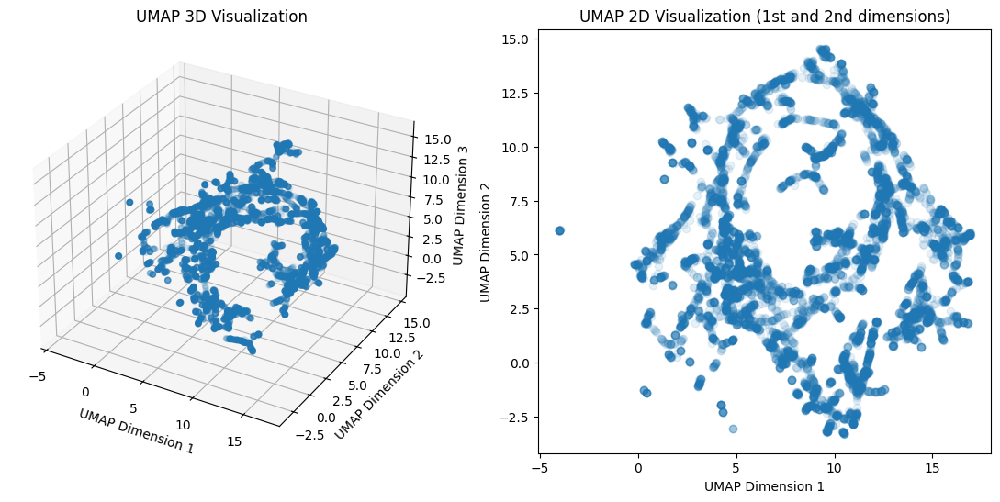

In [21]:
n_neighbors  = 15
min_dist     = 0.1
n_components = 3 # Set this to either 2 or 3 to create 2D or 3D UMAP and cluster plots

# Set a directory to save the fitted UMAP model for later use
save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"

umap_result = visualize_umap(subset, n_neighbors, min_dist, n_components, save_dir)

#### Clustering with HDBSCAN
The following function will cluster the UMAP results. \
The hyperparameters can be adjusted to optimise the clustering results.

Number of clusters: 26


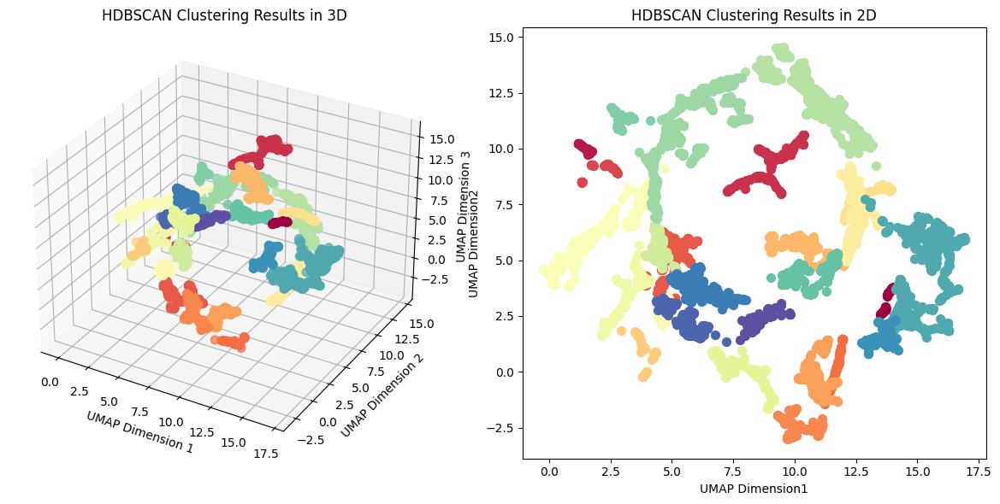

In [22]:
min_samples      = 70 # The amount of neighbors a point needs to be a 'core point'. Set higher to get less clusters but too high will cluster everything together
min_cluster_size = 70 # The minimum amount needed to form a cluster. Set this higher to get less clusters but too high will cluster everything together

# Set a directory to save the fitted UMAP model for later use
save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"

clusterer = cluster_and_visualize_umap(umap_result, subset, min_samples, min_cluster_size, save_dir)

The following function will plot only the largest clusters. \
You can set the amount of largest clusters you want to plot below.

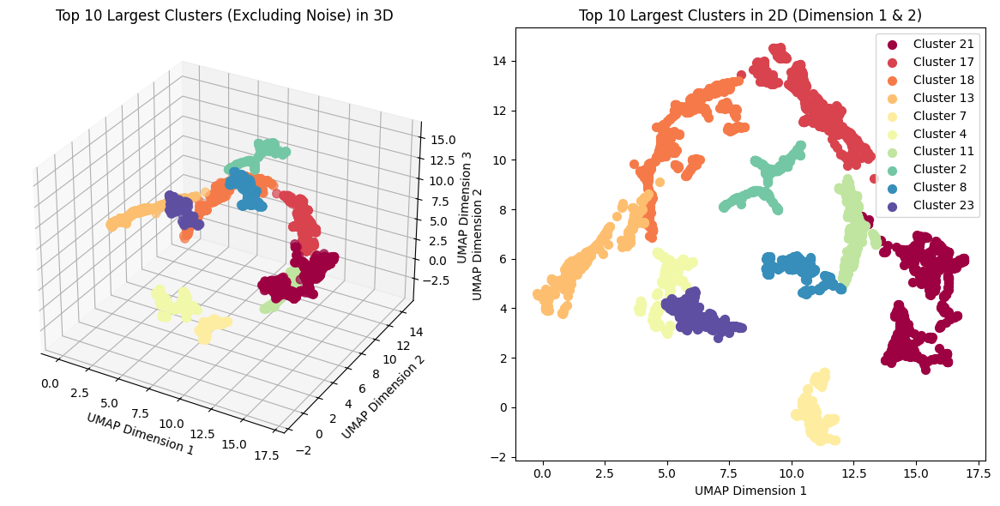

In [23]:
num_clusters_to_plot = 10 # Change this to choose how many of the largest clusters you want to show.

largest_clusters = plot_top_hdbscan_clusters(clusterer, umap_result, num_clusters_to_plot)

The following function will select the frames of each of the largest clusters from the video and save them by their cluster. \
You can set the input and output directory as desired.

In [24]:
# Add the cluster labels to our data
subset['cluster_label'] = clusterer.labels_

# Set parameters for saving frames
 # Input path, this should point to the directory containing all the mouse videos (the filtered_labeled videos).
input_video_path = "C:/Users/Kieran/Documents/Master Thesis Data/labelled_videos"
 # Output path, this is the path where you want to save the frames. Subfolders will be made for each cluster.
output_directory = "C:/Users/Kieran/Documents/Master Thesis Data/Frames"

# Saves the frames to the specified directory
save_frames_for_clusters(input_video_path, output_directory, largest_clusters, subset, datatype, n_components)

This will plot a timeline for each cluster, indicating where in the video the frames of the cluster belongs:

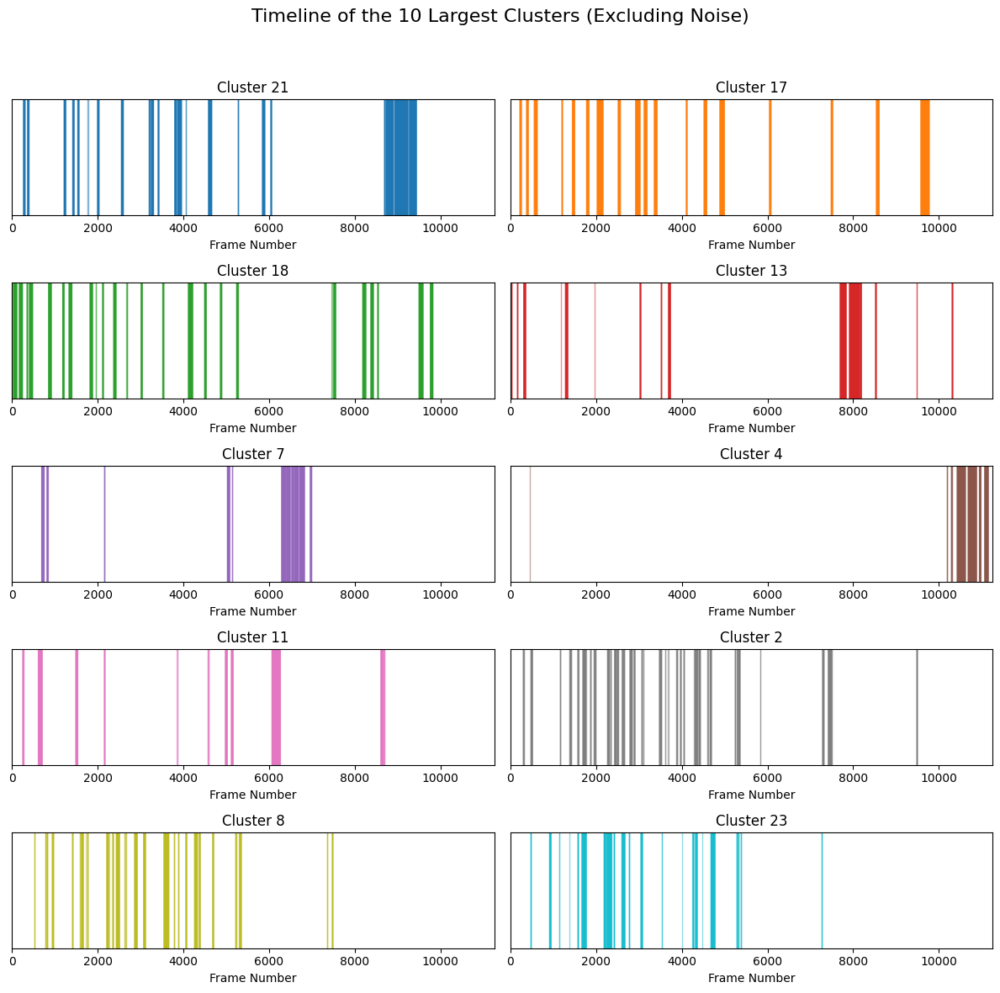

In [25]:
plot_timeline_for_largest_clusters(subset, largest_clusters)

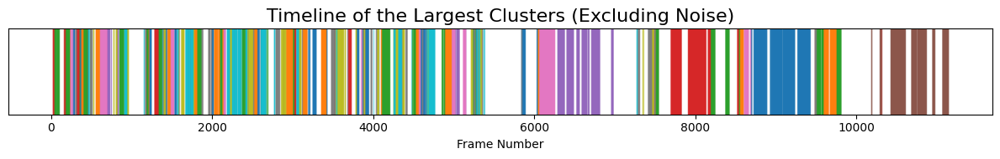

In [26]:
plot_single_timeline_for_largest_clusters(subset, largest_clusters)

The frames of each cluster are saved in corresponding folders, but to visualise them in a GIF run the code below

C:\Users\Kieran\AppData\Local\Temp\ipykernel_4648\2938635374.py:23: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(img_path))


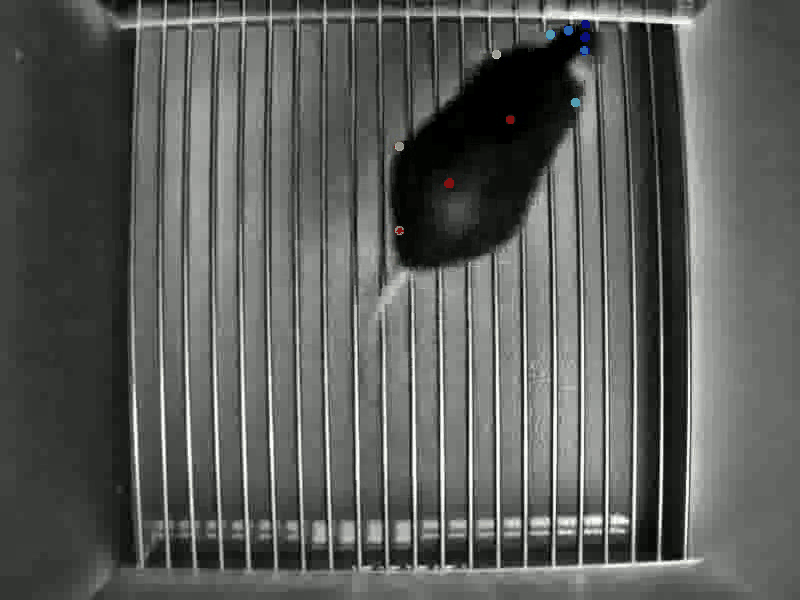

In [27]:
import imageio
import random
import os
 
# Define the directory where your images are stored
mouse_no = subset['mouse_no'].unique().item()
image_folder = main_folder + f"/Frames/clustered_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}/cluster_21"
 

    
# Get a list of image file names
image_files = [img for img in os.listdir(image_folder) if img.endswith(('.png', '.jpg', '.jpeg'))]
 
# Randomly select 20 images
selected_images = random.sample(image_files, 50)
 
# Create a list to hold the images
images = []
 
# Read each image file and append to the images list
for filename in selected_images:
    img_path = os.path.join(image_folder, filename)
    images.append(imageio.imread(img_path))
    
# Save the images as a GIF
gif_path = os.path.join(image_folder, 'my_animated.gif')
imageio.mimsave(gif_path, images, duration=0.2)  # duration controls the time between frames in seconds
 
# Display the GIF in Jupyter Notebook
from IPython.display import Image
Image(url=gif_path)

from IPython.display import Image, display
 
# Assuming gif_path contains the path to the saved GIF
gif_path = os.path.join(image_folder, 'my_animated.gif')
 
# Use the Image function to display the GIF
display(Image(filename=gif_path))

### RNN 

#### Training the RNN
The below functions will train an RNN model on the full (chosen) dataset. \
The model will take 25 frames as input sequence, and attempt to predict the next 25 frames. \
The next input sequence is shifted by 25 frames from the last.

In [58]:
# This cell sets which device to use. If a GPU is available it will choose that, otherwise it will select CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using", device)

Using cuda


In [59]:
# Parameters for training the RNN
dropout_prob   = 0.5
epoch_num      = 10
hidden_size    = 16 # This defines the size of the latent values
layer_num      = 2
learning_rate  = 1e-3
seq_size       = 25 # The amount of frames inputted as one sequence, 25 frames is 1 second of video
pred_window    = 25 # The amount of frames (after the input) the model predicts, 25 frames is 1 second of video
shift_size     = 25 # By how many frames each new input for the model is shifted
batch_size     = 64 # The batch size for the dataloaders

# This function processes the data, splits it into train, test, and validation, normalizes it, and creates DataLoaders
data_loader = preprocess_data(subset, seq_size, pred_window, shift_size, batch_size, device)

In [60]:
# Get the input and output size of our data
input_size = next(iter(data_loader))[0][:, :, 1:-2].size(-1)
output_size = next(iter(data_loader))[1][:, :, 1:-2].size(-1)

# Create our model with our parameters and data sizes
model = Model(dropout_prob, hidden_size, layer_num, input_size, output_size).to(device)

# Create a loss function and optimizer for the model
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), learning_rate)
print(model)

Model(
  (gru): GRU(28, 16, num_layers=2, batch_first=True, dropout=0.5)
  (linear): Linear(in_features=16, out_features=28, bias=True)
)


In [61]:
# Set a save location for the model (including filename for the model)
mouse_no = subset['mouse_no'].unique().item()
save_dir = f"../Models/rnn_{datatype}_data_1l_mouse_nr_{str(mouse_no)}_hidden_size_{str(hidden_size)}.pt"

train_model(model, epoch_num, optimizer, criterion, data_loader, save_dir)

Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00,  7.75it/s]


Train loss: 1.0210


Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 29.59it/s]


Train loss: 0.9736


Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 34.86it/s]


Train loss: 0.9345


Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 34.85it/s]


Train loss: 0.8979


Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 29.98it/s]


Train loss: 0.8592


Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 33.37it/s]


Train loss: 0.8198


Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.19it/s]


Train loss: 0.7774


Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.35it/s]


Train loss: 0.7398


Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 36.72it/s]


Train loss: 0.7041


Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.49it/s]

Train loss: 0.6738


#### Extract latent values
The below functions will load in the saved model and run the full dataset through it. \
Instead of the output (predictions for future sequences) it will collect the intermediate layer outputs. \
This is what we call the latent space and where we will hopefully see (after dimensionality reduction and clustering) learned behaviours (or sequences).

In [62]:
# Load the saved model
model.load_state_dict(torch.load(save_dir))
model.eval()

Model(
  (gru): GRU(28, 16, num_layers=2, batch_first=True, dropout=0.5)
  (linear): Linear(in_features=16, out_features=28, bias=True)
)

In [63]:
# Analyses the model using the test data, and obtains the performance (loss) and latent values for all sequences
latents_df = extract_latents(model, data_loader, criterion)

100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 25.22it/s]


#### Dimensionality reduction
In order to visualise and cluster the latent space properly, we have to reduce the amount of dimensions. We can do this using PCA, UMAP, or by setting the `hidden_size` variable of the RNN to 3. This last one ensures that the latent dimensions of the RNN are already small enough to cluster directly.

In [27]:
dim_red_options = ['PCA', 'UMAP', 'RNN']
dropdown2 = widgets.Dropdown(options=dim_red_options, description='Dimensionality reduction:')
print("What type of dimensionality reduction would you like to work with?")
display(dropdown2)

What type of dimensionality reduction would you like to work with?


Dropdown(description='Dimensionality reduction:', options=('PCA', 'UMAP', 'RNN'), value='PCA')

**Make sure to run the cell above to be able to choose the dimensionality reduction method!** \
To use the RNN model by itself as dimensionality reduction method, ensure that the `hidden_size` variable is set to `3`.

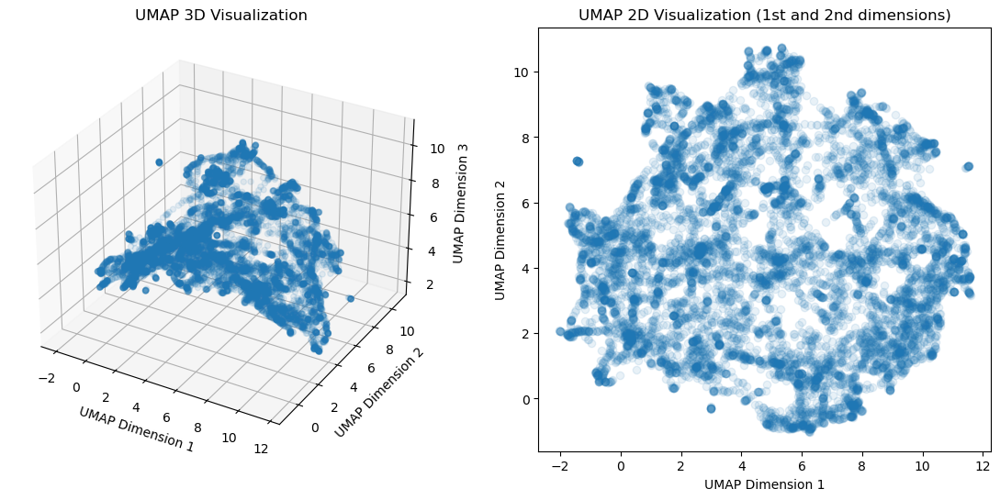

CPU times: total: 19.9 s
Wall time: 23.3 s


In [28]:
%%time
dim_red_type = dropdown2.value

n_neighbors  = 15
min_dist     = 0.1
n_components = 3 # Set this to either 2 or 3 to create 2D or 3D UMAP and cluster plots

# Set a directory to save the fitted UMAP model for later use
save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"

if dim_red_type == 'UMAP':
    dim_reduction = visualize_umap(latents_df, n_neighbors, min_dist, n_components, save_dir, rnn_latents=True)
elif dim_red_type == 'PCA':
    dim_reduction = visualize_pca(latents_df, n_components, save_dir, rnn_latents=True)
elif dim_red_type == 'RNN':
    visualise_rnn(latents_df)
    dim_reduction = latents_df.iloc[:, 1:-2].to_numpy()

#### HDBSCAN Clustering

Number of clusters: 51


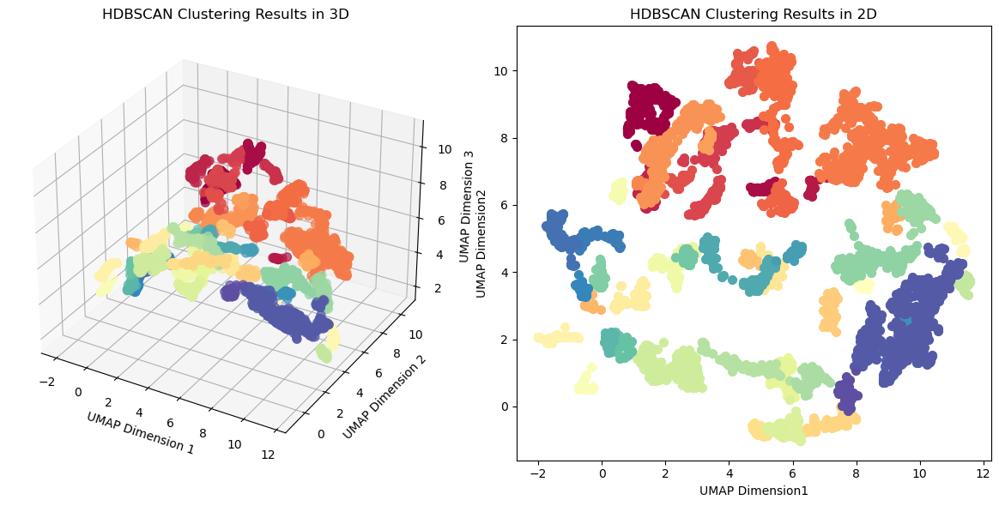

In [35]:
min_samples      = 31 # The amount of neighbors a point needs to be a 'core point'. Set higher to get less clusters but too high will cluster everything together
min_cluster_size = 31 # The minimum amount needed to form a cluster. Set this higher to get less clusters but too high will cluster everything together

# Set a directory to save the fitted UMAP model for later use
save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"

clusterer, color_mapping = cluster_and_visualize_umap(dim_reduction, subset, min_samples, min_cluster_size, save_dir, rnn_latents=True)

The following function will plot the trajectories in lines between successive frames. \
You can change the parameters below to limit the plot to the first X amount of seconds or to turn the order numbers on or off.

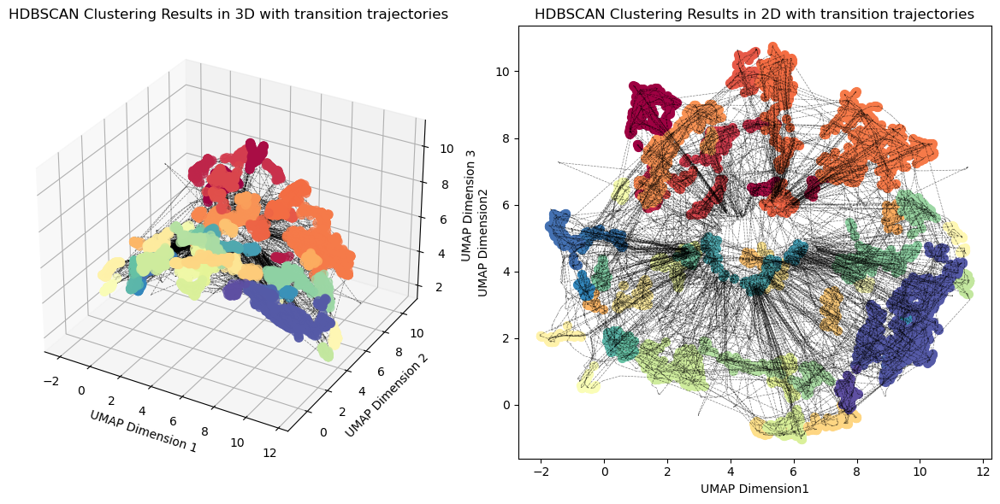

In [36]:
show_order = True # Set this to true to show the order of the frames in numbers in the plot
limit = 10 # The amount of seconds you want to show in the plot. 

plot_trajectories(clusterer, dim_reduction, limit=None, show_order=False, color_mapping = color_mapping)

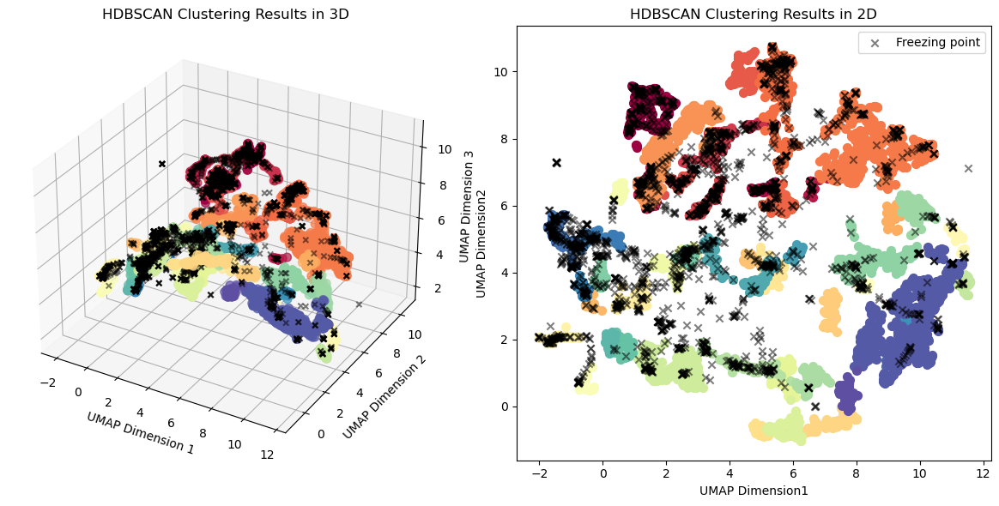

In [37]:
cluster_labels = clusterer.labels_

# 3D plot
fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(121, projection='3d')

# Extract unique cluster labels (excluding noise points)
unique_clusters = np.unique(cluster_labels[cluster_labels != -1])

# Assign different colors to clusters
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_clusters)))

for cluster_label, color in color_mapping.items():
    cluster_indices = np.where(cluster_labels == cluster_label)
    ax.scatter(
        dim_reduction[cluster_indices, 0], 
        dim_reduction[cluster_indices, 1], 
        dim_reduction[cluster_indices, 2], 
        c=[color], 
        s=50,
        alpha=0.7
    )

highlighted_points = np.where(latents_df['Freezing_label'] == 1)[0]
ax.scatter(dim_reduction[highlighted_points, 0], dim_reduction[highlighted_points, 1], dim_reduction[highlighted_points, 2], c='black', marker='x', label='Freezing point', alpha=0.5)

# Add labels and title
ax.set_xlabel('UMAP Dimension 1')
ax.set_ylabel('UMAP Dimension 2')
ax.set_zlabel('UMAP Dimension 3')
ax.set_title('HDBSCAN Clustering Results in 3D')

ax2 = fig.add_subplot(122)
for cluster_label, color in color_mapping.items():
    cluster_indices = np.where(cluster_labels == cluster_label)
    ax2.scatter(dim_reduction[cluster_indices, 0], dim_reduction[cluster_indices, 1], c=[color], s=50)

highlighted_points = np.where(latents_df['Freezing_label'] == 1)[0]
ax2.scatter(dim_reduction[highlighted_points, 0], dim_reduction[highlighted_points, 1], c='black', marker='x', label='Freezing point', alpha=0.5)    

ax2.set_xlabel('UMAP Dimension1')
ax2.set_ylabel('UMAP Dimension2')
ax2.set_title('HDBSCAN Clustering Results in 2D')

plt.tight_layout()
plt.legend()
plt.show()

The following function will plot only the largest clusters. \
You can set the amount of largest clusters you want to plot below.

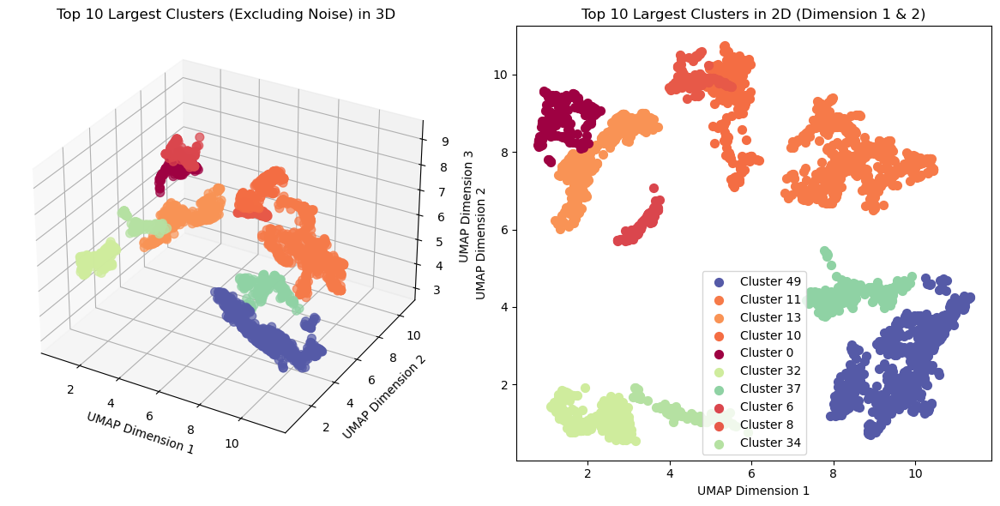

In [38]:
num_clusters_to_plot = 10 # Change this to choose how many of the largest clusters you want to show.

largest_clusters = plot_top_hdbscan_clusters(clusterer, dim_reduction, num_clusters_to_plot, color_mapping)

In [39]:
# Load in original MouseCentric coords
pose_data = pd.read_csv(main_folder + f"/Datasets/MouseCentric/{str(mouse_no)}_MouseCentric_data.csv")
pose_data = pose_data.iloc[:-50, 1:-2]
pose_data['cluster_label'] = clusterer.labels_
grouped_data = pose_data.groupby('cluster_label')
average_poses = grouped_data.mean()

In [38]:
average_poses.to_csv(f'../Poses/{str(mouse_no)}_AveragePoses_RNN_{datatype}Data.csv')

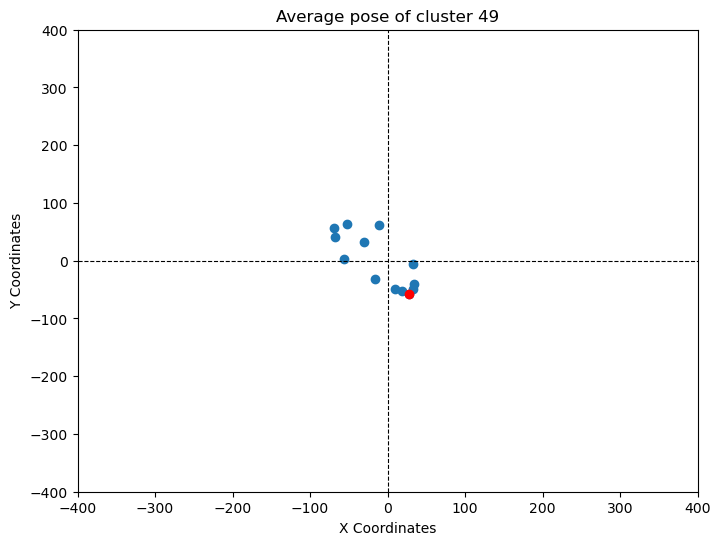

In [40]:
cluster_label = 49

x_coord = average_poses.iloc[cluster_label+1, ::3]
y_coord = average_poses.iloc[cluster_label+1, 1::3]

plt.figure(figsize=(8,6))

plt.scatter(x_coord, y_coord, label='Mouse 203.3')
plt.xlabel('X Coordinates')
plt.ylabel('Y Coordinates')
plt.title(f'Average pose of cluster {cluster_label}')
plt.xlim(-400, 400)  # Set x-axis limits from 0 to 200
plt.ylim(-400, 400)  # Set y-axis limits from 200 to 0
plt.axhline(0, color='black', linewidth=0.8, linestyle='--')
plt.axvline(0, color='black', linewidth=0.8, linestyle='--')
plt.scatter(x_coord.iloc[0], y_coord.iloc[0], c='red')

# average_poses_1 = pd.read_csv('../Poses/11.6_AveragePoses_RNN_MouseDirectionalData.csv')
# cluster_label = 1

# x_coord = average_poses_1.iloc[cluster_label+1, 1::3]
# y_coord = average_poses_1.iloc[cluster_label+1, 2::3]


# plt.scatter(x_coord, y_coord, c='orange', label='Mouse 11.6')

# plt.scatter(x_coord.iloc[0], y_coord.iloc[0], c='red')
# plt.legend()

plt.show()

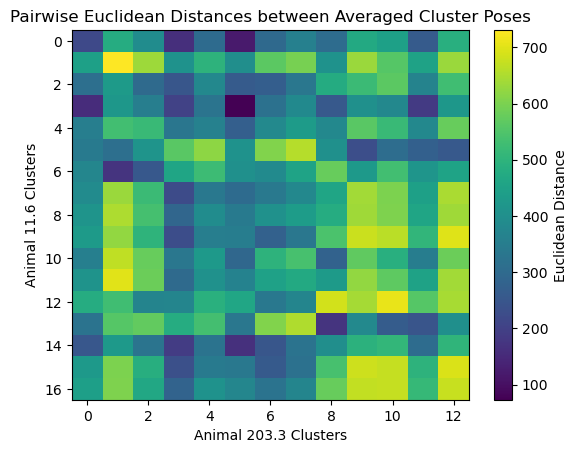

In [45]:
from scipy.spatial.distance import cdist
import glob

average_poses_1 = pd.read_csv('../Poses/11.6_AveragePoses_RNN_MouseDirectionalData.csv', index_col = 'cluster_label')
average_poses_2 = pd.read_csv('../Poses/203.3_AveragePoses_RNN_MouseDirectionalData.csv', index_col = 'cluster_label')
mouse_no_1 = 11.6
mouse_no_2 = 203.3

coordinates_columns = [col for col in average_poses.columns if 'x' in col or 'y' in col]
average_poses_1 = average_poses_1[coordinates_columns]
average_poses_2 = average_poses_2[coordinates_columns]

# Calculate pairwise Euclidean distances
distances = cdist(average_poses_1.values, average_poses_2.values)

# Plot the heatmap of distances
plt.imshow(distances, cmap='viridis', aspect='auto')
plt.colorbar(label='Euclidean Distance')
plt.xlabel(f'Animal {str(mouse_no_2)} Clusters')
plt.ylabel(f'Animal {str(mouse_no_1)} Clusters')
plt.title('Pairwise Euclidean Distances between Averaged Cluster Poses')
plt.show()

The following function will select the frames of each of the largest clusters from the video and save them by their cluster. \
You can set the input and output directory as desired.

In [209]:
latent_frames = subset.iloc[:-50].copy()

# Add the cluster labels to our data
latent_frames['cluster_label'] = clusterer.labels_

# Set parameters for saving frames
 # Input path, this should point to the directory containing all the mouse videos (the filtered_labeled videos).
input_video_path = "C:/Users/Kieran/Documents/Master Thesis Data/labelled_videos"
 # Output path, this is the path where you want to save the frames. Subfolders will be made for each cluster.
output_directory = "C:/Users/Kieran/Documents/Master Thesis Data/Frames/RNN"

# Saves the frames to the specified directory
save_frames_for_clusters(input_video_path, output_directory, largest_clusters, latent_frames, datatype, n_components)

This will plot a timeline for each cluster, indicating where in the video the frames of the cluster belongs:

In [41]:
# Example usage:
latent_frames = subset.iloc[:-50].copy()

# Add the cluster labels to our data
latent_frames['cluster_label'] = clusterer.labels_

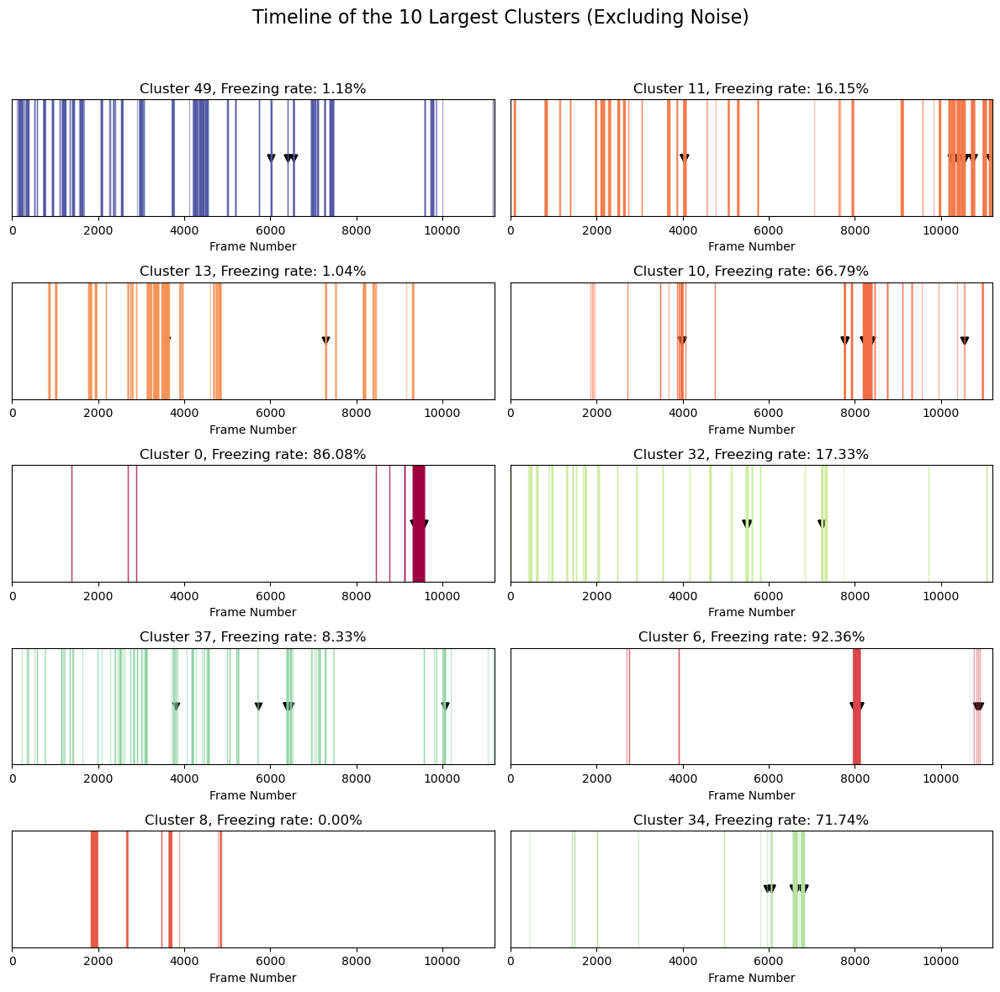

In [42]:
plot_timeline_for_largest_clusters(latent_frames, largest_clusters, color_mapping)

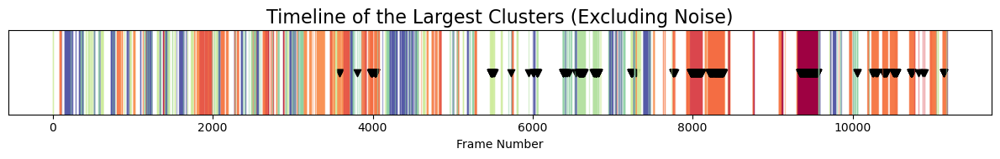

In [43]:
plot_single_timeline_for_largest_clusters(latent_frames, largest_clusters, color_mapping)

The code below will generate an interactive Chord diagram, to show the connections between each of the clusters. \
The connections represent successive frames. Note that the noise cluster (denoted as -1) and the frames in it have been excluded from this plot.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
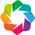

:Chord   [source,target]   (value)

In [44]:
create_chord_diagram(latent_frames)

The frames of each cluster are saved in corresponding folders, but to visualise them in a GIF run the code below

C:\Users\Kieran\AppData\Local\Temp\ipykernel_24316\675692504.py:23: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(img_path))


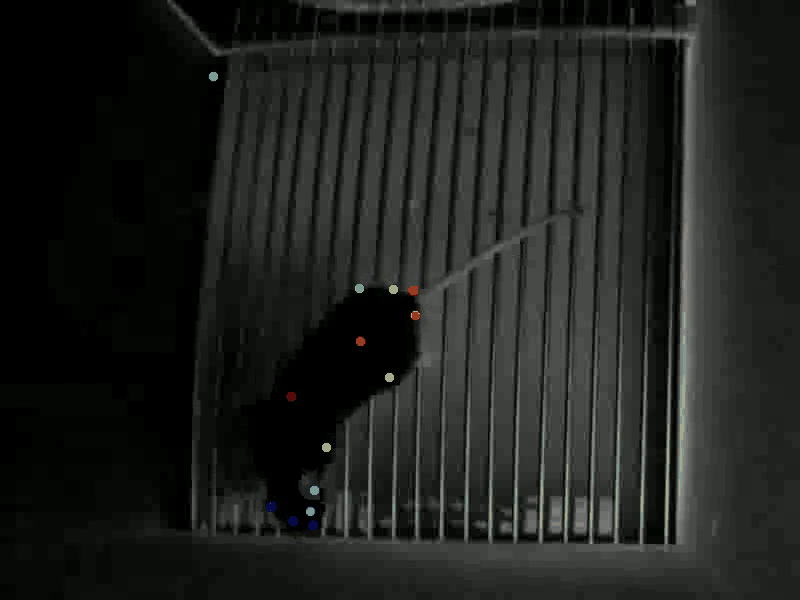

In [67]:
import imageio
import random
import os
 
# Define the directory where your images are stored
mouse_no = subset['mouse_no'].unique().item()
image_folder = main_folder + f"/Frames/RNN/clustered_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}/cluster_79"
 

    
# Get a list of image file names
image_files = [img for img in os.listdir(image_folder) if img.endswith(('.png', '.jpg', '.jpeg'))]
 
# Randomly select 20 images
selected_images = random.sample(image_files, 50)
 
# Create a list to hold the images
images = []
 
# Read each image file and append to the images list
for filename in selected_images:
    img_path = os.path.join(image_folder, filename)
    images.append(imageio.imread(img_path))
    
# Save the images as a GIF
gif_path = os.path.join(image_folder, 'my_animated.gif')
imageio.mimsave(gif_path, images, duration=0.2)  # duration controls the time between frames in seconds
 
# Display the GIF in Jupyter Notebook
from IPython.display import Image
Image(url=gif_path)

from IPython.display import Image, display
 
# Assuming gif_path contains the path to the saved GIF
gif_path = os.path.join(image_folder, 'my_animated.gif')
 
# Use the Image function to display the GIF
display(Image(filename=gif_path))

#### Supervised UMAP results

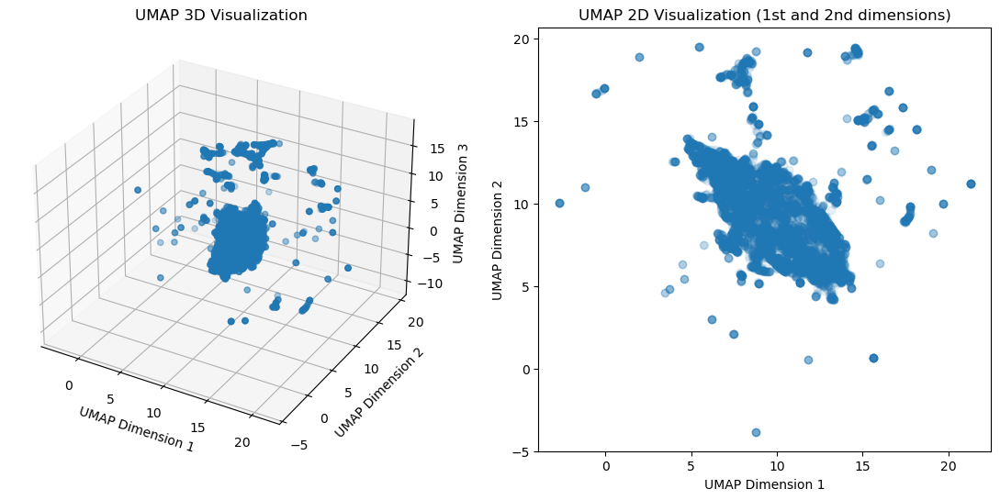

In [45]:
dim_reduction = visualize_umap(latents_df, n_neighbors, min_dist, n_components, save_dir, rnn_latents=True, supervised=True)

Number of clusters: 21


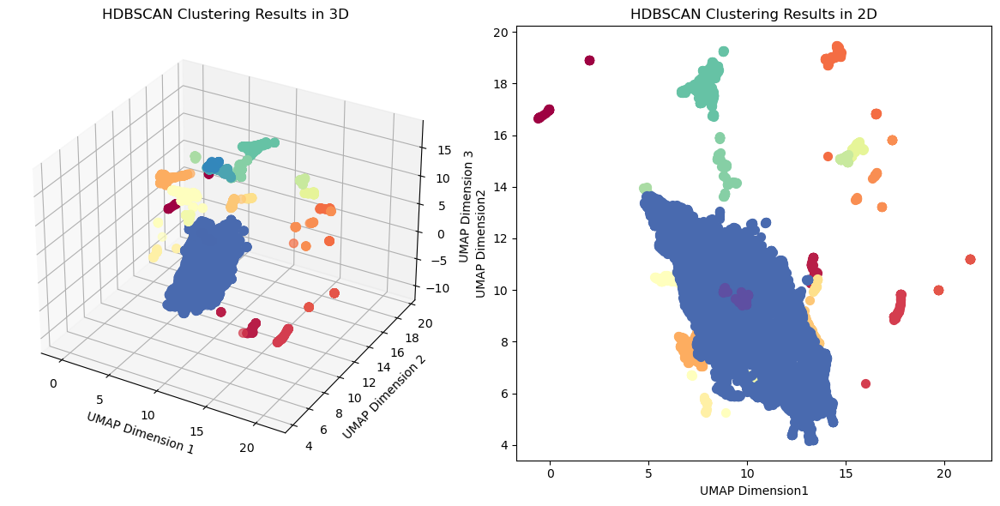

In [46]:
min_samples      = 30 # The amount of neighbors a point needs to be a 'core point'. Set higher to get less clusters but too high will cluster everything together
min_cluster_size = 30 # The minimum amount needed to form a cluster. Set this higher to get less clusters but too high will cluster everything together

# Set a directory to save the fitted UMAP model for later use
save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"

clusterer, color_mapping = cluster_and_visualize_umap(dim_reduction, subset, min_samples, min_cluster_size, save_dir, rnn_latents=True)

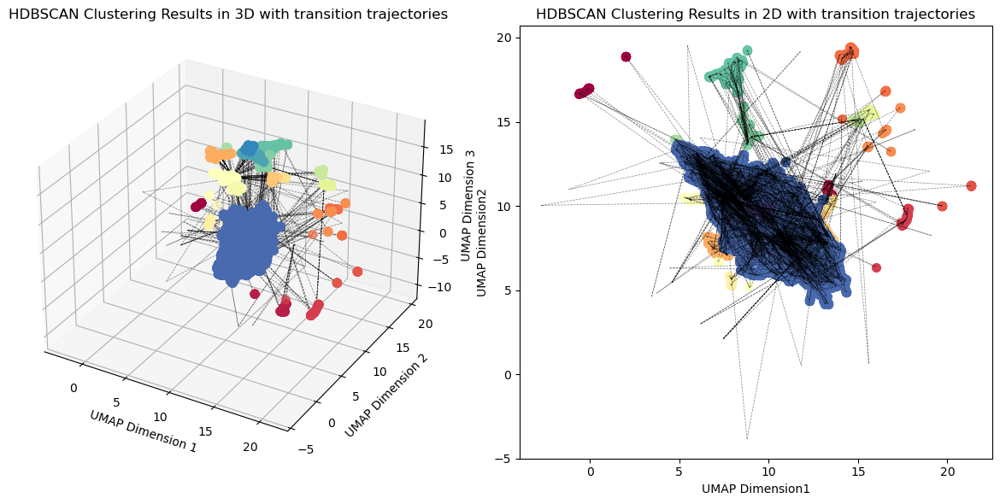

In [47]:
show_order = True # Set this to true to show the order of the frames in numbers in the plot
limit = 10 # The amount of seconds you want to show in the plot. 

plot_trajectories(clusterer, dim_reduction, limit=None, show_order=False, color_mapping = color_mapping)

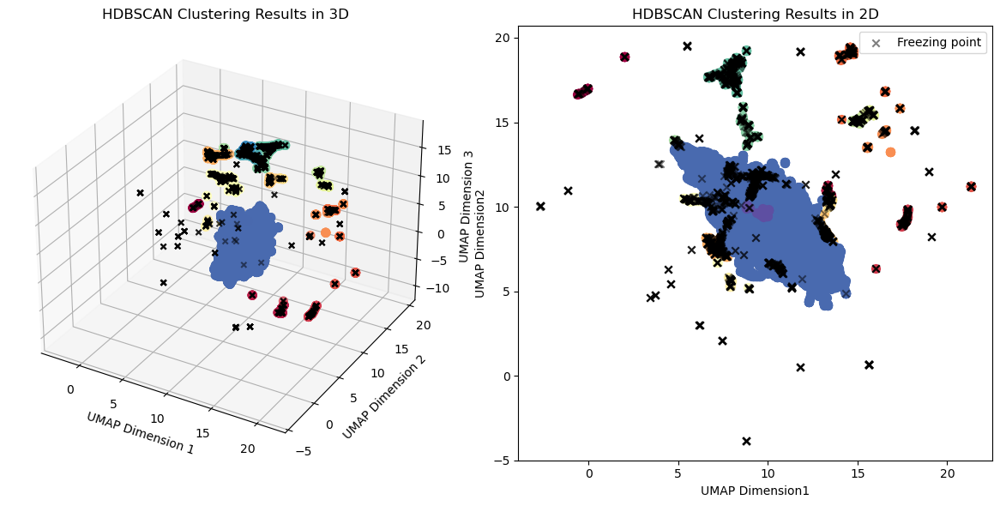

In [48]:
cluster_labels = clusterer.labels_

# 3D plot
fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(121, projection='3d')

# Extract unique cluster labels (excluding noise points)
unique_clusters = np.unique(cluster_labels[cluster_labels != -1])

# Assign different colors to clusters
colors = plt.cm.Spectral(np.linspace(0, 1, len(unique_clusters)))

for cluster_label, color in color_mapping.items():
    cluster_indices = np.where(cluster_labels == cluster_label)
    ax.scatter(
        dim_reduction[cluster_indices, 0], 
        dim_reduction[cluster_indices, 1], 
        dim_reduction[cluster_indices, 2], 
        c=[color], 
        s=50,
        alpha=0.7
    )

highlighted_points = np.where(latents_df['Freezing_label'] == 1)[0]
ax.scatter(dim_reduction[highlighted_points, 0], dim_reduction[highlighted_points, 1], dim_reduction[highlighted_points, 2], c='black', marker='x', label='Freezing point', alpha=0.5)

# Add labels and title
ax.set_xlabel('UMAP Dimension 1')
ax.set_ylabel('UMAP Dimension 2')
ax.set_zlabel('UMAP Dimension 3')
ax.set_title('HDBSCAN Clustering Results in 3D')

ax2 = fig.add_subplot(122)
for cluster_label, color in color_mapping.items():
    cluster_indices = np.where(cluster_labels == cluster_label)
    ax2.scatter(dim_reduction[cluster_indices, 0], dim_reduction[cluster_indices, 1], c=[color], s=50)

highlighted_points = np.where(latents_df['Freezing_label'] == 1)[0]
ax2.scatter(dim_reduction[highlighted_points, 0], dim_reduction[highlighted_points, 1], c='black', marker='x', label='Freezing point', alpha=0.5)    

ax2.set_xlabel('UMAP Dimension1')
ax2.set_ylabel('UMAP Dimension2')
ax2.set_title('HDBSCAN Clustering Results in 2D')

plt.tight_layout()
plt.legend()
plt.show()

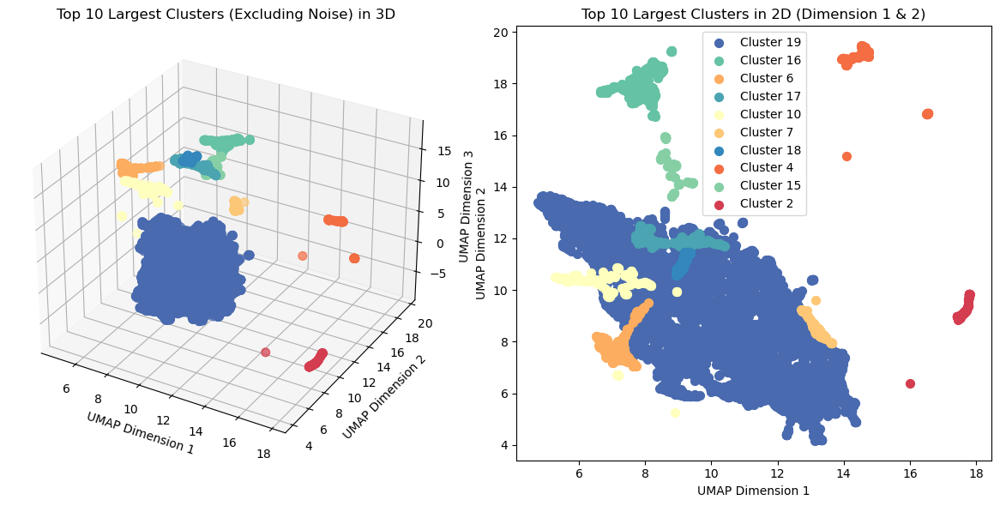

In [49]:
num_clusters_to_plot = 10 # Change this to choose how many of the largest clusters you want to show.

largest_clusters = plot_top_hdbscan_clusters(clusterer, dim_reduction, num_clusters_to_plot, color_mapping)

In [50]:
# Load in original MouseCentric coords
pose_data = pd.read_csv(main_folder + f"/Datasets/MouseCentric/{str(mouse_no)}_MouseCentric_data.csv")
pose_data = pose_data.iloc[:-50, 1:-2]
pose_data['cluster_label'] = clusterer.labels_
grouped_data = pose_data.groupby('cluster_label')
average_poses = grouped_data.mean()

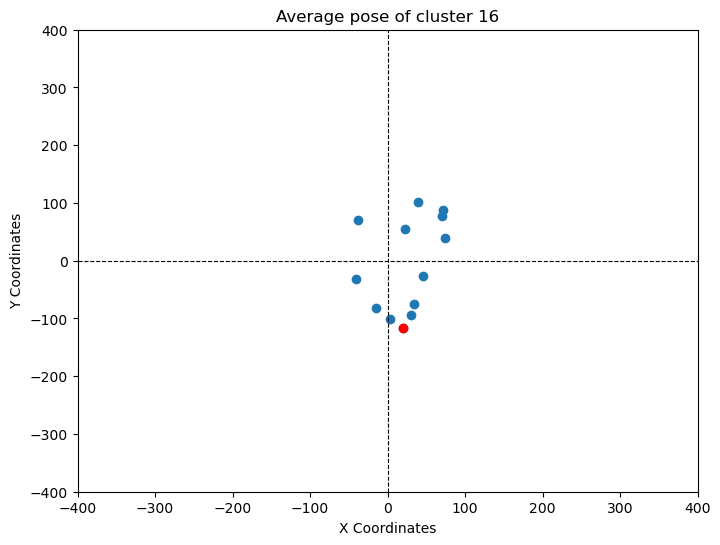

In [51]:
cluster_label = 16

x_coord = average_poses.iloc[cluster_label+1, ::3]
y_coord = average_poses.iloc[cluster_label+1, 1::3]

plt.figure(figsize=(8,6))

plt.scatter(x_coord, y_coord, label='Mouse 203.3')
plt.xlabel('X Coordinates')
plt.ylabel('Y Coordinates')
plt.title(f'Average pose of cluster {cluster_label}')
plt.xlim(-400, 400)  # Set x-axis limits from 0 to 200
plt.ylim(-400, 400)  # Set y-axis limits from 200 to 0
plt.axhline(0, color='black', linewidth=0.8, linestyle='--')
plt.axvline(0, color='black', linewidth=0.8, linestyle='--')
plt.scatter(x_coord.iloc[0], y_coord.iloc[0], c='red')

# average_poses_1 = pd.read_csv('../Poses/11.6_AveragePoses_RNN_MouseDirectionalData.csv')
# cluster_label = 1

# x_coord = average_poses_1.iloc[cluster_label+1, 1::3]
# y_coord = average_poses_1.iloc[cluster_label+1, 2::3]


# plt.scatter(x_coord, y_coord, c='orange', label='Mouse 11.6')

# plt.scatter(x_coord.iloc[0], y_coord.iloc[0], c='red')
# plt.legend()

plt.show()

In [52]:
# Example usage:
latent_frames = subset.iloc[:-50].copy()

# Add the cluster labels to our data
latent_frames['cluster_label'] = clusterer.labels_

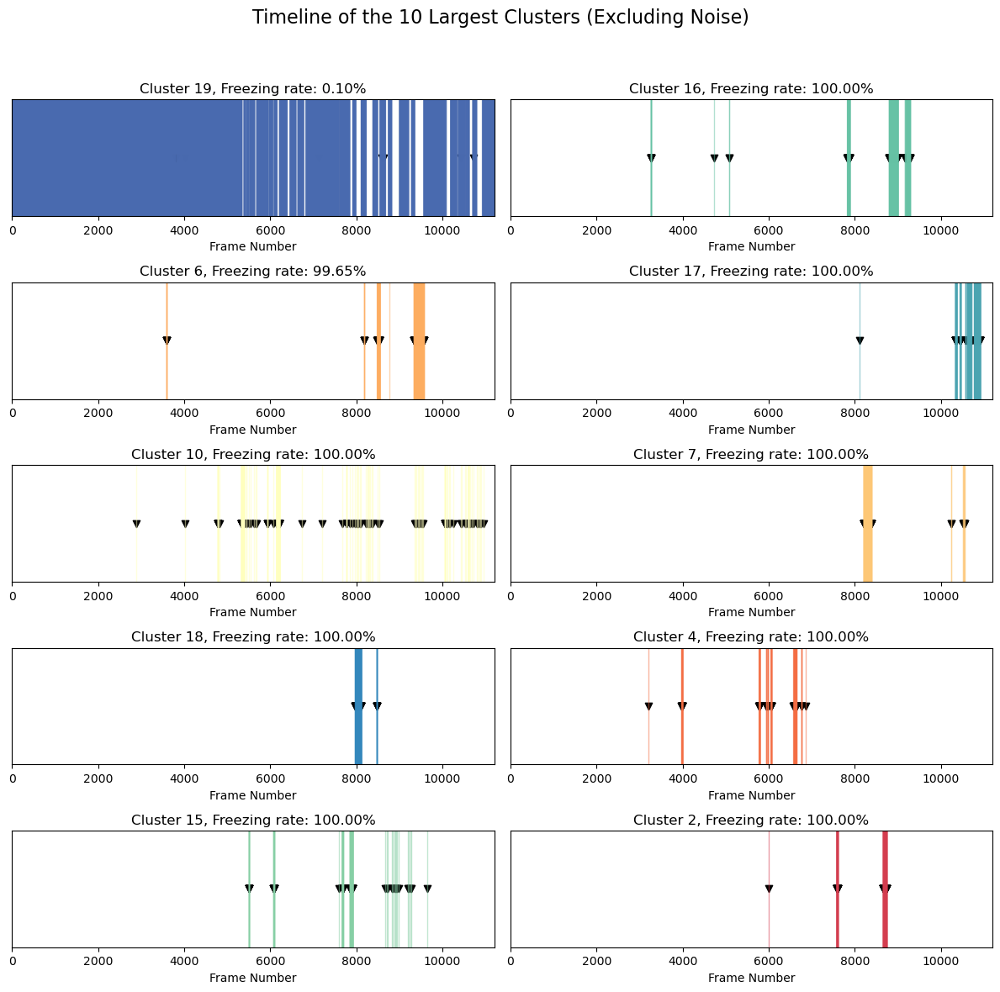

In [53]:
plot_timeline_for_largest_clusters(latent_frames, largest_clusters, color_mapping)

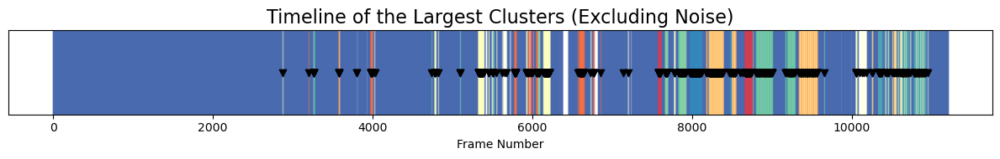

In [54]:
plot_single_timeline_for_largest_clusters(latent_frames, largest_clusters, color_mapping)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
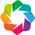

:Chord   [source,target]   (value)

In [55]:
create_chord_diagram(latent_frames)

### GSBS

#### Downsample the data
This cell will downsample the data so that GSBS can be (feasibly) run on it.

In [76]:
latents_df_downsampled = latents_df[::step_size].copy()
time_series = latents_df_downsampled.iloc[:,1:-2].values

In [27]:
step_size = 20 # step_size denotes how many frames to skip over in order to downsample
time_series = downsample_data(subset, step_size)
print(f"Downsampled to {len(time_series)} frames.")

TypeError: argument of type 'int' is not iterable

#### Correlation matrix of the downsampled data

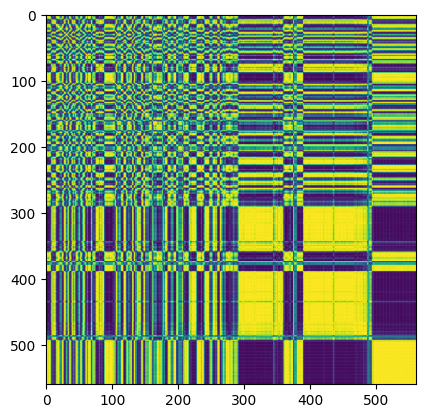

In [77]:
corr = np.corrcoef(time_series)
plt.imshow(corr)

#### Fitting the GSBS model

In [78]:
GSBS_model = GSBS(x=time_series, kmax=int(len(time_series) * 0.5), statewise_detection=True)
GSBS_model.fit()

280it [04:04,  1.14it/s]                                                                                               


#### Analysis plots

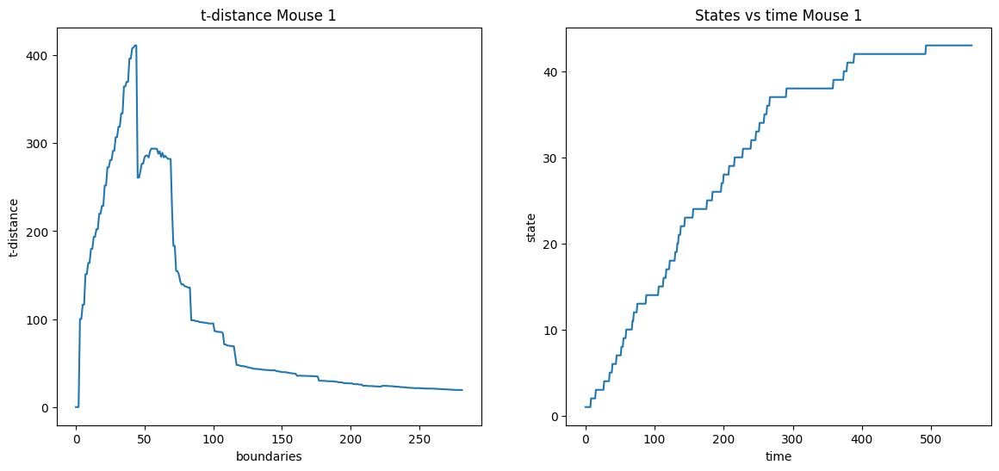

In [79]:
#plot results
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(14,6))
ax1.plot(GSBS_model.tdists)
ax1.set_ylabel('t-distance')
ax1.set_xlabel('boundaries')
ax1.set_title('t-distance Mouse 1')
ax2.plot(GSBS_model.states)
ax2.set_ylabel('state')
ax2.set_xlabel('time')
ax2.set_title('States vs time Mouse 1')
plt.show()

In [80]:
result = np.argmax([v if i > 10 else -float('inf') for i, v in enumerate(GSBS_model.tdists)])

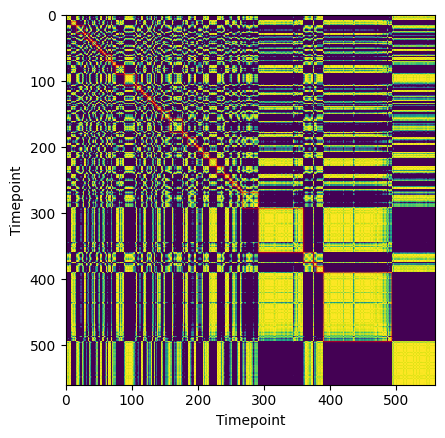

In [81]:
plot_corr_states(GSBS_model, time_series, result)

In [82]:
patterns = GSBS_model.get_state_patterns(result)

(array([112., 118., 130.,  68.,  58.,  34.,  36.,  30.,  40.,  14.,  20.,
         28.,  24.,  24.,  18.,  20.,  16.,   6.,  22.,  16.,  22.,  28.,
         12.,  10.,  14.,  10.,   6.,  16.,   8.,  16.,  26.,   8.,  18.,
         24.,  16.,  12.,  14.,  20.,  32.,  28.,  24.,  26.,  36.,  18.,
         48.,  54.,  42.,  62., 112., 210.]),
 array([-0.9179151 , -0.87957457, -0.84123404, -0.80289351, -0.76455298,
        -0.72621245, -0.68787192, -0.64953139, -0.61119086, -0.57285033,
        -0.5345098 , -0.49616927, -0.45782874, -0.41948821, -0.38114768,
        -0.34280715, -0.30446662, -0.26612609, -0.22778556, -0.18944503,
        -0.1511045 , -0.11276397, -0.07442344, -0.03608291,  0.00225762,
         0.04059815,  0.07893868,  0.11727921,  0.15561974,  0.19396026,
         0.23230079,  0.27064132,  0.30898185,  0.34732238,  0.38566291,
         0.42400344,  0.46234397,  0.5006845 ,  0.53902503,  0.57736556,
         0.61570609,  0.65404662,  0.69238715,  0.73072768,  0.76906821,
 

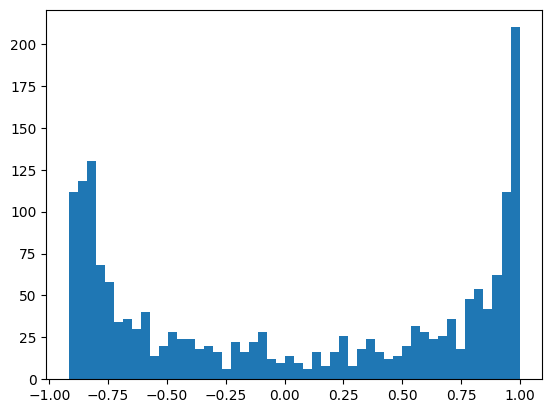

In [83]:
corr = np.corrcoef(patterns)[np.where(~np.eye(patterns.shape[0],dtype=bool))]
plt.hist(corr,bins=50)

C:\Users\Kieran\anaconda3\lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\Kieran\anaconda3\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


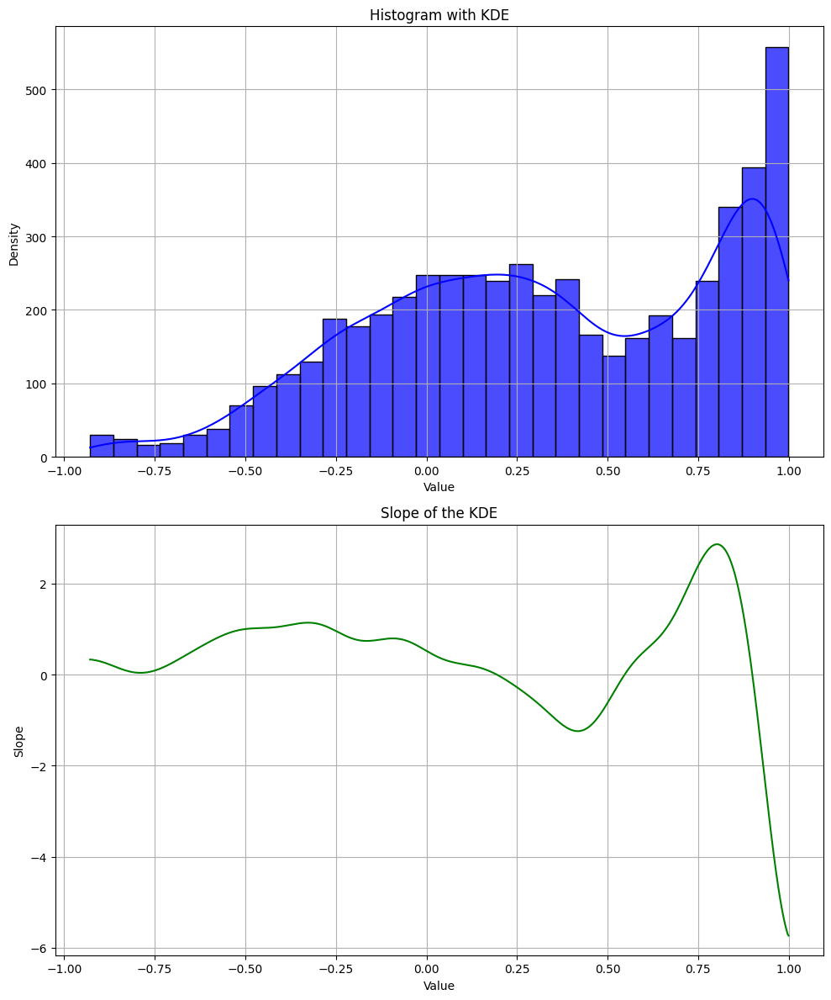

In [167]:
from scipy.stats import gaussian_kde
import numpy as np
import seaborn as sns

# Estimating the KDE
kde = gaussian_kde(corr)
x_values = np.linspace(min(corr), max(corr), 1000)
kde_values = kde(x_values)

# Calculating the slope (derivative) of the KDE curve
kde_slope = np.gradient(kde_values, x_values)

# Plotting the histogram, KDE, and the slope of the KDE
# Creating subplots: one for the histogram with KDE, and one for the slope of the KDE

fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 12))

# Histogram with KDE
sns.histplot(corr, bins=30, kde=True, color='blue', alpha=0.7, ax=axes[0])
axes[0].set_title("Histogram with KDE")
axes[0].set_xlabel("Value")
axes[0].set_ylabel("Density")
axes[0].grid(True)

# Slope of the KDE
axes[1].plot(x_values, kde_slope, color='green')
axes[1].set_title("Slope of the KDE")
axes[1].set_xlabel("Value")
axes[1].set_ylabel("Slope")
axes[1].grid(True)

plt.tight_layout()
plt.show()

C:\Users\Kieran\anaconda3\lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\Kieran\anaconda3\lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


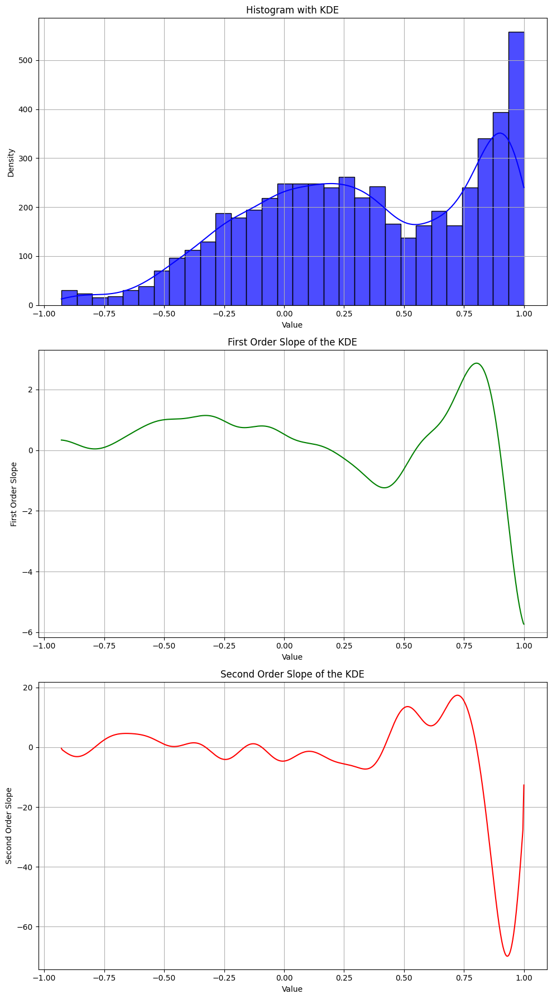

In [168]:
# Calculating the second order slope (second derivative) of the KDE curve
second_order_slope = np.gradient(kde_slope, x_values)

# Creating subplots: one for the histogram with KDE, one for the first order slope, and one for the second order slope
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(10, 18))

# Histogram with KDE
sns.histplot(corr, bins=30, kde=True, color='blue', alpha=0.7, ax=axes[0])
axes[0].set_title("Histogram with KDE")
axes[0].set_xlabel("Value")
axes[0].set_ylabel("Density")
axes[0].grid(True)

# First order slope of the KDE
axes[1].plot(x_values, kde_slope, color='green')
axes[1].set_title("First Order Slope of the KDE")
axes[1].set_xlabel("Value")
axes[1].set_ylabel("First Order Slope")
axes[1].grid(True)

# Second order slope of the KDE
axes[2].plot(x_values, second_order_slope, color='red')
axes[2].set_title("Second Order Slope of the KDE")
axes[2].set_xlabel("Value")
axes[2].set_ylabel("Second Order Slope")
axes[2].grid(True)

plt.tight_layout()
plt.show()

In [84]:
merged_states = merge_similar_states(patterns, threshold=0.97)

Reduced the number of unique states from 43 to 15


In [85]:
states = GSBS_model.states
states = states - 1
unique_arrays, indices = np.unique(merged_states, axis=0, return_inverse=True)
state_labels = [indices[i] for i in states]

In [86]:
 # Downsample the data by only taking every step_size'th frame
downsampled = subset[::20].copy()

# Ensure the last frame is always included, even if it is skipped by the set step_size
if len(subset) % step_size != 0:
    last_frame = subset.iloc[[-1]].copy()
    downsampled = pd.concat([downsampled, last_frame], ignore_index=True)

downsampled['state_label'] = state_labels
downsampled

ValueError: Length of values (560) does not match length of index (564)

In [43]:
print_frames_per_state(downsampled)

Data for state '3': 
Start frame: 0, end frame: 140
Start frame: 1760, end frame: 2100
Start frame: 2880, end frame: 2880
Start frame: 4560, end frame: 4740
Start frame: 7180, end frame: 7460
Start frame: 9860, end frame: 11249

Data for state '9': 
Start frame: 160, end frame: 280
Start frame: 1500, end frame: 1740
Start frame: 2340, end frame: 2440
Start frame: 4820, end frame: 5180
Start frame: 6960, end frame: 7160

Data for state '1': 
Start frame: 300, end frame: 380
Start frame: 5200, end frame: 5240

Data for state '10': 
Start frame: 400, end frame: 480
Start frame: 920, end frame: 1040
Start frame: 2120, end frame: 2260
Start frame: 2460, end frame: 2540
Start frame: 3240, end frame: 3340
Start frame: 4000, end frame: 4140
Start frame: 4760, end frame: 4800

Data for state '4': 
Start frame: 500, end frame: 540
Start frame: 1060, end frame: 1120
Start frame: 2900, end frame: 3120

Data for state '13': 
Start frame: 560, end frame: 660
Start frame: 1140, end frame: 1180
Start 

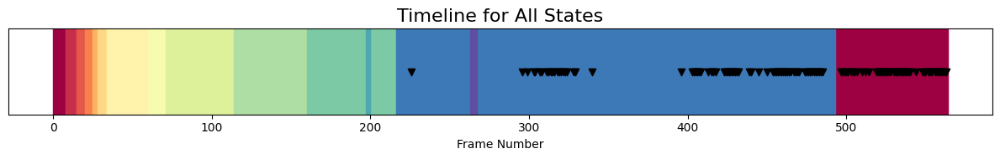

In [44]:
plot_timeline_for_all_states(downsampled)

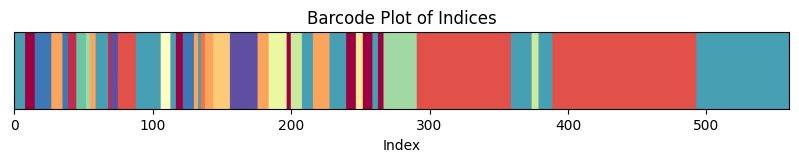

In [87]:
plot_barcode(state_labels)

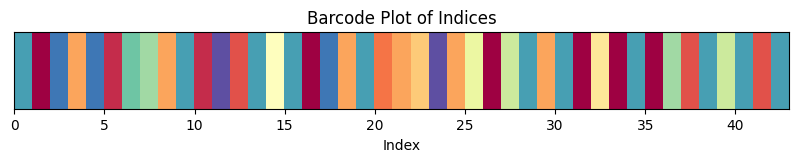

In [88]:
plot_barcode(merged_states)

In [89]:
unique_arrays, indices = np.unique(merged_states, axis=0, return_inverse=True)
# print(unique_arrays)
# print(indices)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
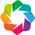

   source  target
0      12       0
1       0      13
2      13       4
3       4      13
4      13       1
5       1      11
6      11      10
7      10       4
8       4      12
9      12       1


C:\Users\Kieran\anaconda3\lib\site-packages\holoviews\core\data\pandas.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return dataset.data.dtypes[idx].type
C:\Users\Kieran\anaconda3\lib\site-packages\holoviews\core\data\pandas.py:27: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return dataset.data.dtypes[idx].type


:Chord   [source,target]

In [90]:
# Enable the Bokeh notebook extension
hv.extension('bokeh')
hv.output(size=200)

data = {'source': indices, 'target': np.roll(indices, -1)}
df = pd.DataFrame(data)
print(df.head(10))

chord = hv.Chord(df)

chord.opts(
    opts.Chord(cmap='Category20', edge_cmap='Category20', edge_color=hv.dim('source').str(), labels='source', node_color=dim('index').str()),
    opts.Labels(text_font_size='8pt'),
)

In [91]:
indices

array([12,  0, 13,  4, 13,  1, 11, 10,  4, 12,  1, 14,  2, 12,  7, 12,  0,
       13,  4, 12,  3,  4,  5, 14,  4,  8,  0,  9, 12,  4, 12,  0,  6,  0,
       12,  0, 10,  2, 12,  9, 12,  2, 12], dtype=int64)

In [99]:
import networkx as nx
def calculate_transition_matrix(timeseries):
    states = np.unique(timeseries)
    num_states = len(states)
    transition_matrix = np.zeros((num_states, num_states))

    state_index = {state: i for i, state in enumerate(states)}

    for (current_state, next_state) in zip(timeseries, timeseries[1:]):
        i = state_index[current_state]
        j = state_index[next_state]
        transition_matrix[i, j] += 1

    # Normalize to get probabilities
    transition_matrix = transition_matrix / np.sum(transition_matrix, axis=1, keepdims=True)

    return transition_matrix, states

def plot_transition_matrix(transition_matrix, states):
    plt.imshow(transition_matrix, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.xticks(np.arange(len(states)), states)
    plt.yticks(np.arange(len(states)), states)
    plt.xlabel('Next State')
    plt.ylabel('Current State')
    plt.title('State Transition Matrix')
    plt.show()

def build_transition_graph(transition_matrix, states):
    G = nx.DiGraph()
    for i, state1 in enumerate(states):
        for j, state2 in enumerate(states):
            if transition_matrix[i, j] > 0:
                G.add_edge(state1, state2, weight=transition_matrix[i, j])

    pos = nx.spring_layout(G)
    weights = nx.get_edge_attributes(G, 'weight')

    nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=2000, edge_color='black', linewidths=1, font_size=15)
    nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
    plt.title('State Transition Graph')
    plt.show()

# Example usage:
# timeseries_data = np.array([your_1d_numpy_array_here])  # Replace with your 1D NumPy array
transition_matrix, states = calculate_transition_matrix(indices)

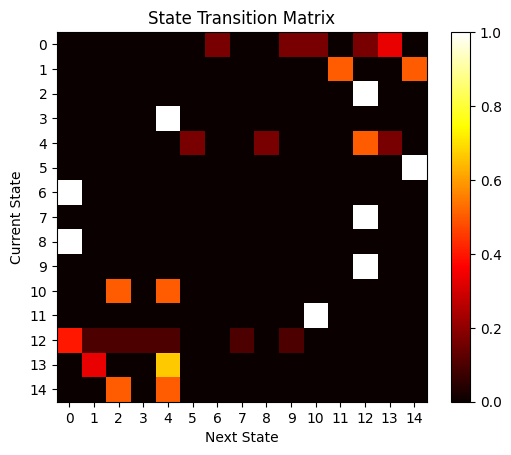

In [100]:
plot_transition_matrix(transition_matrix, states)

In [101]:
build_transition_graph(transition_matrix, states)

TypeError: '_AxesStack' object is not callable

<Figure size 640x480 with 0 Axes>

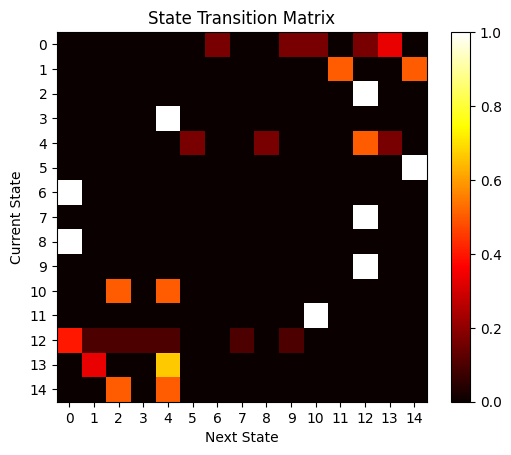

In [94]:
def calculate_transition_matrix(timeseries):
    states = np.unique(timeseries)
    num_states = len(states)
    transition_matrix = np.zeros((num_states, num_states))

    state_index = {state: i for i, state in enumerate(states)}

    for (current_state, next_state) in zip(timeseries, timeseries[1:]):
        i = state_index[current_state]
        j = state_index[next_state]
        transition_matrix[i, j] += 1

    # Normalize to get probabilities
    transition_matrix = transition_matrix / np.sum(transition_matrix, axis=1, keepdims=True)

    return transition_matrix, states

def plot_transition_matrix(transition_matrix, states):
    plt.imshow(transition_matrix, cmap='hot', interpolation='nearest')
    plt.colorbar()
    plt.xticks(np.arange(len(states)), states)
    plt.yticks(np.arange(len(states)), states)
    plt.xlabel('Next State')
    plt.ylabel('Current State')
    plt.title('State Transition Matrix')
    plt.show()

# Example usage:
# timeseries_data = np.array([your_1d_numpy_array_here])  # Replace with your 1D NumPy array
transition_matrix, states = calculate_transition_matrix(indices)
plot_transition_matrix(transition_matrix, states)

In [92]:
import numpy as np

def find_recurring_patterns(indices, pattern_length=4):
    patterns_dict = {}

    for j in range(2, pattern_length + 1):
        for i in range(len(indices) - j + 1):
            pattern = tuple(indices[i:i + j])

            if pattern in patterns_dict:
                if i not in patterns_dict[pattern]:
                    patterns_dict[pattern].append(i)
            else:
                pattern_indices = [p for p, x in enumerate(indices) if np.all(indices[p:p + j] == pattern)]
                if len(pattern_indices) > 1:
                    patterns_dict[pattern] = pattern_indices

    return patterns_dict

result = find_recurring_patterns(indices, pattern_length=10)

# Print the result in a nice way
for pattern, index in result.items():
    print(f"Pattern: {pattern}, Occurrences at indices: {index}")


Pattern: (12, 0), Occurrences at indices: [0, 15, 30, 34]
Pattern: (0, 13), Occurrences at indices: [1, 16]
Pattern: (13, 4), Occurrences at indices: [2, 17]
Pattern: (4, 12), Occurrences at indices: [8, 18, 29]
Pattern: (2, 12), Occurrences at indices: [12, 37, 41]
Pattern: (9, 12), Occurrences at indices: [27, 39]
Pattern: (12, 0, 13), Occurrences at indices: [0, 15]
Pattern: (0, 13, 4), Occurrences at indices: [1, 16]
Pattern: (12, 0, 13, 4), Occurrences at indices: [0, 15]


C:\Users\Kieran\AppData\Local\Temp\ipykernel_14192\3950788586.py:14: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  pattern_indices = [p for p, x in enumerate(indices) if np.all(indices[p:p + j] == pattern)]


In [ ]:
# Larger repeating sequences should only occur as the largest, not the smaller insides e.g.: If you have [10, 4, 13] repeating then don't have [10, 4] and [4, 13] etc
# Videos of repeating sequences (of every unique sequece instance)
# 

### Loop

In [52]:
# This cell sets which device to use. If a GPU is available it will choose that, otherwise it will select CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using", device)

Using cuda


In [60]:
for mouse_no in tqdm(dataset['mouse_no'].unique()):
    mouse_data = dataset[dataset['mouse_no'] == mouse_no]
    
    # Parameters for training the RNN
    dropout_prob   = 0.5
    epoch_num      = 10
    hidden_size    = 16 # This defines the size of the latent values
    layer_num      = 2
    learning_rate  = 1e-3
    seq_size       = 25 # The amount of frames inputted as one sequence, 25 frames is 1 second of video
    pred_window    = 25 # The amount of frames (after the input) the model predicts, 25 frames is 1 second of video
    shift_size     = 25 # By how many frames each new input for the model is shifted
    batch_size     = 64 # The batch size for the dataloaders

    # This function processes the data, splits it into train, test, and validation, normalizes it, and creates DataLoaders
    data_loader = preprocess_data(mouse_data, seq_size, pred_window, shift_size, batch_size, device)
    
    # Get the input and output size of our data
    input_size = next(iter(data_loader))[0][:, :, 1:-2].size(-1)
    output_size = next(iter(data_loader))[1][:, :, 1:-2].size(-1)

    # Create our model with our parameters and data sizes
    model = Model(dropout_prob, hidden_size, layer_num, input_size, output_size).to(device)

    # Create a loss function and optimizer for the model
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), learning_rate)
    
    # Set a save location for the model (including filename for the model)
    # mouse_no = mouse_data['mouse_no'].unique().item()
    save_dir = f"../Models/rnn_{datatype}_data_1l_mouse_nr_{str(mouse_no)}_hidden_size_{str(hidden_size)}.pt"

    train_model(model, epoch_num, optimizer, criterion, data_loader, save_dir)
    
    model.eval()
    
    latents_df = extract_latents(model, data_loader, criterion)
    
    n_neighbors  = 15
    min_dist     = 0.1
    n_components = 3 
    
    # Set a directory to save the fitted UMAP model for later use
    save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"
    
    umap_model = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, n_components=n_components)
    dim_reduction = umap_model.fit_transform(latents_df.iloc[:, 1:-2])
    
    joblib.dump(umap_model, save_dir+f"rnn_latents_umap_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
    
    min_samples_values      = np.arange(20, 80, 10) # The amount of neighbors a point needs to be a 'core point'. Set higher to get less clusters but too high will cluster everything together
    min_cluster_size_values = np.arange(20, 80, 10) # The minimum amount needed to form a cluster. Set this higher to get less clusters but too high will cluster everything together
    
    optimal_clusters = None
    optimal_params = None
    lowest_num_clusters = float('inf')  # Initialize with a high value

    for min_samples in min_samples_values:
        for min_cluster_size in min_cluster_size_values:
            # Set a directory to save the fitted UMAP model for later use
            save_dir = "C:/Users/Kieran/Documents/Master Thesis Data/Models/"

            # Create an HDBSCAN clusterer with optional parameters
            clusterer = HDBSCAN(min_samples=min_samples, min_cluster_size=min_cluster_size)

            # Fit the clusterer to the UMAP data
            cluster_labels = clusterer.fit_predict(dim_reduction)
            
            unique_clusters = np.unique(cluster_labels)
            filtered_clusters = [label for label in unique_clusters if label != -1]
            num_clusters = len(filtered_clusters)
            print(f"Number of clusters: {num_clusters}")
            if 10 <= num_clusters <= 20:
                optimal_clusterer = clusterer
                optimal_clusters = cluster_labels
                optimal_params = {'min_samples': min_samples, 'min_cluster_size': min_cluster_size}
                # print(f"Optimal number of clusters: {num_clusters}")
                break
            elif 20 <= num_clusters < lowest_num_clusters:
                lowest_num_clusters = num_clusters
                optimal_clusterer = clusterer
                optimal_clusters = cluster_labels
                optimal_params = {'min_samples': min_samples, 'min_cluster_size': min_cluster_size}
                # print(f"Optimal number of clusters: {num_clusters}")
                
    print("chosen amount of clusters: ", len(np.unique(optimal_clusterer.labels_)))
    
    joblib.dump(optimal_clusterer, save_dir+f"rnn_latents_hdbscan_model_{datatype}_data_{n_components}-dimensional_mouse_nr_{str(mouse_no)}.pkl")
    
    pose_data = pd.read_csv(main_folder + f"/Datasets/MouseCentric/{str(mouse_no)}_MouseCentric_data.csv")
    pose_data = pose_data.iloc[:-50, 1:-2]
    pose_data['cluster_label'] = optimal_clusterer.labels_
    
    # Filter on only top 10 largest clusters
    cluster_sizes = pose_data['cluster_label'].value_counts()
    top_clusters = cluster_sizes[cluster_sizes.index != -1].nlargest(10).index
    pose_data_top_clusters = pose_data[pose_data['cluster_label'].isin(top_clusters)]
    
    grouped_data = pose_data_top_clusters.groupby('cluster_label')
    average_poses = grouped_data.mean()
    
    average_poses.to_csv(f'../Poses/{str(mouse_no)}_AveragePoses_RNN_{datatype}Data.csv')

Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.18it/s]


Train loss: 1.0524



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.28it/s]


Train loss: 1.0336



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 1.0202



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 1.0088



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.95it/s]


Train loss: 0.9982



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.30it/s]


Train loss: 0.9885



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 0.9782



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.61it/s]


Train loss: 0.9703



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.26it/s]


Train loss: 0.9607



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.14it/s]


Train loss: 0.9540



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Number of clusters: 131
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


  1%|▊                                                                                  | 1/98 [00:25<42:01, 25.99s/it]

Number of clusters: 3
chosen amount of clusters:  132



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.78it/s]


Train loss: 1.0709



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 1.0475



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 1.0284



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 1.0163



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0051



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9945



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9854



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.59it/s]


Train loss: 0.9763



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 0.9667



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 0.9592



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Number of clusters: 160
Number of clusters: 105
Number of clusters: 81
Number of clusters: 65
Number of clusters: 54
Number of clusters: 47
Number of clusters: 92
Number of clusters: 85
Number of clusters: 57
Number of clusters: 43
Number of clusters: 38
Number of clusters: 32
Number of clusters: 76
Number of clusters: 70
Number of clusters: 49
Number of clusters: 34
Number of clusters: 26
Number of clusters: 25
Number of clusters: 33
Number of clusters: 28
Number of clusters: 28
Number of clusters: 28
Number of clusters: 26
Number of clusters: 24
Number of clusters: 26
Number of clusters: 26
Number of clusters: 25
Number of clusters: 25
Number of clusters: 24
Number of clusters: 22
Number of clusters: 25
Number of clusters: 25
Number of clusters: 25
Number of clusters: 24
Number of clusters: 23


  2%|█▋                                                                                 | 2/98 [00:50<40:01, 25.01s/it]

Number of clusters: 25
chosen amount of clusters:  23



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 1.0540



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 1.0332



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.98it/s]


Train loss: 1.0147



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.28it/s]


Train loss: 0.9993



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.17it/s]


Train loss: 0.9859



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 36.84it/s]


Train loss: 0.9746



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.18it/s]


Train loss: 0.9620



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9491



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9392



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 14.24it/s]


Train loss: 0.9290



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Number of clusters: 136
Number of clusters: 94
Number of clusters: 75
Number of clusters: 59
Number of clusters: 49
Number of clusters: 47
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 50
Number of clusters: 48
Number of clusters: 45
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 48
Number of clusters: 45
Number of clusters: 35
Number of clusters: 52
Number of clusters: 50
Number of clusters: 46
Number of clusters: 43
Number of clusters: 39
Number of clusters: 31
Number of clusters: 44
Number of clusters: 43
Number of clusters: 41
Number of clusters: 39
Number of clusters: 36
Number of clusters: 30
Number of clusters: 41
Number of clusters: 39
Number of clusters: 36
Number of clusters: 25


  3%|██▌                                                                                | 3/98 [01:15<39:25, 24.91s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.59it/s]


Train loss: 1.0449



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 1.0236



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.55it/s]


Train loss: 1.0079



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 0.9932



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.01it/s]


Train loss: 0.9776



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9651



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9523



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.94it/s]


Train loss: 0.9371



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.18it/s]


Train loss: 0.9259



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.36it/s]


Train loss: 0.9155



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.76it/s]


Number of clusters: 123
Number of clusters: 86
Number of clusters: 68
Number of clusters: 57
Number of clusters: 52
Number of clusters: 44
Number of clusters: 84
Number of clusters: 73
Number of clusters: 56
Number of clusters: 49
Number of clusters: 45
Number of clusters: 40
Number of clusters: 53
Number of clusters: 50
Number of clusters: 47
Number of clusters: 40
Number of clusters: 9
Number of clusters: 9
Number of clusters: 44
Number of clusters: 42
Number of clusters: 38
Number of clusters: 37
Number of clusters: 7
Number of clusters: 7
Number of clusters: 38
Number of clusters: 35
Number of clusters: 34
Number of clusters: 30
Number of clusters: 28
Number of clusters: 21
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


  4%|███▍                                                                               | 4/98 [01:41<39:50, 25.44s/it]

Number of clusters: 3
chosen amount of clusters:  22



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.30it/s]


Train loss: 1.0407



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 1.0216



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 1.0062



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.21it/s]


Train loss: 0.9948



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9846



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.08it/s]


Train loss: 0.9739



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.53it/s]


Train loss: 0.9648



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.51it/s]


Train loss: 0.9565



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 0.9484



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Train loss: 0.9419



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.36it/s]


Number of clusters: 132
Number of clusters: 91
Number of clusters: 60
Number of clusters: 51
Number of clusters: 2
Number of clusters: 2
Number of clusters: 86
Number of clusters: 77
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 57
Number of clusters: 52
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 52
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 43
Number of clusters: 37
Number of clusters: 29
Number of clusters: 27
Number of clusters: 26
Number of clusters: 24
Number of clusters: 36
Number of clusters: 30
Number of clusters: 30
Number of clusters: 3
Number of clusters: 3


  5%|████▏                                                                              | 5/98 [02:07<39:34, 25.53s/it]

Number of clusters: 2
chosen amount of clusters:  25



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.07it/s]


Train loss: 1.0749



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.98it/s]


Train loss: 1.0372



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.90it/s]


Train loss: 1.0091



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 36.65it/s]


Train loss: 0.9855



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.09it/s]


Train loss: 0.9629



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.90it/s]


Train loss: 0.9430



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.67it/s]


Train loss: 0.9252



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.94it/s]


Train loss: 0.9103



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.25it/s]


Train loss: 0.8956



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.18it/s]


Train loss: 0.8837



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Number of clusters: 114
Number of clusters: 79
Number of clusters: 65
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


  6%|█████                                                                              | 6/98 [02:32<39:04, 25.49s/it]

Number of clusters: 2
chosen amount of clusters:  66



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.78it/s]


Train loss: 1.0410



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 1.0173



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.96it/s]


Train loss: 0.9964



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9772



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.75it/s]


Train loss: 0.9586



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 0.9430



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.05it/s]


Train loss: 0.9255



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.95it/s]


Train loss: 0.9115



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.68it/s]


Train loss: 0.8950



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.8838



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.67it/s]


Number of clusters: 120
Number of clusters: 72
Number of clusters: 60
Number of clusters: 44
Number of clusters: 39
Number of clusters: 33
Number of clusters: 61
Number of clusters: 55
Number of clusters: 36
Number of clusters: 36
Number of clusters: 34
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


  7%|█████▉                                                                             | 7/98 [02:58<39:06, 25.79s/it]

Number of clusters: 2
chosen amount of clusters:  34



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.84it/s]


Train loss: 1.0345



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.81it/s]


Train loss: 1.0139



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.53it/s]


Train loss: 0.9978



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 16.09it/s]


Train loss: 0.9850



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.81it/s]


Train loss: 0.9721



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9600



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9478



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.70it/s]


Train loss: 0.9357



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9259



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9167



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 71.43it/s]


Number of clusters: 132
Number of clusters: 90
Number of clusters: 72
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


  8%|██████▊                                                                            | 8/98 [03:24<38:25, 25.61s/it]

Number of clusters: 2
chosen amount of clusters:  73



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.75it/s]


Train loss: 1.0442



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 34.85it/s]


Train loss: 1.0273



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 1.0147



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.56it/s]


Train loss: 1.0039



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.42it/s]


Train loss: 0.9935



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.94it/s]


Train loss: 0.9838



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.53it/s]


Train loss: 0.9729



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.59it/s]


Train loss: 0.9625



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9521



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.28it/s]


Train loss: 0.9434



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.67it/s]


Number of clusters: 107
Number of clusters: 4
Number of clusters: 4
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


  9%|███████▌                                                                           | 9/98 [03:49<37:58, 25.60s/it]

Number of clusters: 2
chosen amount of clusters:  108



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 34.83it/s]


Train loss: 1.0422



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 1.0191



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 1.0034



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.67it/s]


Train loss: 0.9881



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 0.9739



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.39it/s]


Train loss: 0.9615



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9489



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.43it/s]


Train loss: 0.9372



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9266



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.38it/s]


Train loss: 0.9153



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.25it/s]


Number of clusters: 4
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 4
Number of clusters: 4
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 29
Number of clusters: 25
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 32
Number of clusters: 31
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 43
Number of clusters: 28
Number of clusters: 27
Number of clusters: 26
Number of clusters: 25
Number of clusters: 2
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 3


 10%|████████▎                                                                         | 10/98 [04:16<38:04, 25.96s/it]

Number of clusters: 2
chosen amount of clusters:  26



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.39it/s]


Train loss: 1.0394



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0140



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.18it/s]


Train loss: 0.9964



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 0.9786



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9642



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9487



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.71it/s]


Train loss: 0.9342



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9240



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.09it/s]


Train loss: 0.9093



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 0.8979



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Number of clusters: 123
Number of clusters: 92
Number of clusters: 67
Number of clusters: 61
Number of clusters: 53
Number of clusters: 43
Number of clusters: 82
Number of clusters: 75
Number of clusters: 57
Number of clusters: 47
Number of clusters: 6
Number of clusters: 5
Number of clusters: 62
Number of clusters: 58
Number of clusters: 56
Number of clusters: 48
Number of clusters: 6
Number of clusters: 5
Number of clusters: 54
Number of clusters: 51
Number of clusters: 45
Number of clusters: 41
Number of clusters: 4
Number of clusters: 4
Number of clusters: 29
Number of clusters: 26
Number of clusters: 22
Number of clusters: 22
Number of clusters: 4
Number of clusters: 4
Number of clusters: 5
Number of clusters: 5
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


 11%|█████████▏                                                                        | 11/98 [04:41<37:10, 25.64s/it]

Number of clusters: 4
chosen amount of clusters:  23



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 1.0552



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0333



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 1.0173



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.94it/s]


Train loss: 1.0029



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.72it/s]


Train loss: 0.9909



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9788



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.27it/s]


Train loss: 0.9662



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9532



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9405



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.32it/s]


Train loss: 0.9265



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.77it/s]


Number of clusters: 132
Number of clusters: 90
Number of clusters: 73
Number of clusters: 64
Number of clusters: 47
Number of clusters: 43
Number of clusters: 89
Number of clusters: 76
Number of clusters: 63
Number of clusters: 51
Number of clusters: 40
Number of clusters: 41
Number of clusters: 59
Number of clusters: 54
Number of clusters: 53
Number of clusters: 40
Number of clusters: 35
Number of clusters: 35
Number of clusters: 49
Number of clusters: 44
Number of clusters: 38
Number of clusters: 37
Number of clusters: 33
Number of clusters: 34
Number of clusters: 40
Number of clusters: 37
Number of clusters: 36
Number of clusters: 33
Number of clusters: 32
Number of clusters: 31
Number of clusters: 36
Number of clusters: 33
Number of clusters: 35
Number of clusters: 32
Number of clusters: 31


 12%|██████████                                                                        | 12/98 [05:06<36:33, 25.50s/it]

Number of clusters: 29
chosen amount of clusters:  30



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 1.0424



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.17it/s]


Train loss: 1.0180



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.36it/s]


Train loss: 0.9990



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9804



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.73it/s]


Train loss: 0.9639



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.77it/s]


Train loss: 0.9471



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 0.9326



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9203



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.42it/s]


Train loss: 0.9061



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.8935



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Number of clusters: 131
Number of clusters: 82
Number of clusters: 61
Number of clusters: 38
Number of clusters: 35
Number of clusters: 30
Number of clusters: 73
Number of clusters: 60
Number of clusters: 53
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 51
Number of clusters: 48
Number of clusters: 39
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 13%|██████████▉                                                                       | 13/98 [05:31<36:01, 25.44s/it]

Number of clusters: 2
chosen amount of clusters:  31



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 1.0406



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 1.0237



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0128



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.84it/s]


Train loss: 1.0015



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 0.9922



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9845



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.71it/s]


Train loss: 0.9776



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.30it/s]


Train loss: 0.9715



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 0.9645



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 0.9595



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.68it/s]


Number of clusters: 2
Number of clusters: 72
Number of clusters: 62
Number of clusters: 47
Number of clusters: 38
Number of clusters: 33
Number of clusters: 67
Number of clusters: 61
Number of clusters: 50
Number of clusters: 38
Number of clusters: 31
Number of clusters: 28
Number of clusters: 50
Number of clusters: 47
Number of clusters: 42
Number of clusters: 2
Number of clusters: 26
Number of clusters: 25
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 21
Number of clusters: 19
Number of clusters: 2
Number of clusters: 24
Number of clusters: 20


 14%|███████████▋                                                                      | 14/98 [05:52<33:38, 24.03s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 32.56it/s]


Train loss: 1.0264



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.03it/s]


Train loss: 1.0147



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 1.0059



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 32.79it/s]


Train loss: 0.9977



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.36it/s]


Train loss: 0.9890



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 0.9798



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.92it/s]


Train loss: 0.9718



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.43it/s]


Train loss: 0.9642



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.42it/s]


Train loss: 0.9562



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.18it/s]


Train loss: 0.9478



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Number of clusters: 111
Number of clusters: 50
Number of clusters: 40
Number of clusters: 30
Number of clusters: 26
Number of clusters: 23
Number of clusters: 49
Number of clusters: 43
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 15%|████████████▌                                                                     | 15/98 [06:18<33:54, 24.52s/it]

Number of clusters: 2
chosen amount of clusters:  24



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.18it/s]


Train loss: 1.0530



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.98it/s]


Train loss: 1.0344



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 30.70it/s]


Train loss: 1.0201



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.75it/s]


Train loss: 1.0087



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.17it/s]


Train loss: 0.9991



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 33.82it/s]


Train loss: 0.9896



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 0.9820



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 0.9740



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.00it/s]


Train loss: 0.9665



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 0.9593



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.96it/s]


Number of clusters: 112
Number of clusters: 75
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 39
Number of clusters: 6
Number of clusters: 5
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 6
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


 16%|█████████████▍                                                                    | 16/98 [06:44<34:17, 25.10s/it]

Number of clusters: 4
chosen amount of clusters:  40



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 33.98it/s]


Train loss: 1.0627



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.97it/s]


Train loss: 1.0400



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.74it/s]


Train loss: 1.0230



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.00it/s]


Train loss: 1.0095



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 0.9972



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9840



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 0.9725



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.46it/s]


Train loss: 0.9593



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9492



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.67it/s]


Train loss: 0.9379



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.73it/s]


Number of clusters: 127
Number of clusters: 89
Number of clusters: 67
Number of clusters: 61
Number of clusters: 53
Number of clusters: 48
Number of clusters: 85
Number of clusters: 76
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 28
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 22
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 14
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 20
Number of clusters: 22


 17%|██████████████▏                                                                   | 17/98 [07:07<33:01, 24.46s/it]

Number of clusters: 17
chosen amount of clusters:  18



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.11it/s]


Train loss: 1.0318



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.59it/s]


Train loss: 1.0131



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.86it/s]


Train loss: 1.0007



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.67it/s]


Train loss: 0.9879



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.43it/s]


Train loss: 0.9770



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.9690



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 0.9599



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.72it/s]


Train loss: 0.9512



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 0.9458



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.02it/s]


Train loss: 0.9396



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.42it/s]


Number of clusters: 119
Number of clusters: 82
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 18%|███████████████                                                                   | 18/98 [07:33<32:58, 24.73s/it]

Number of clusters: 2
chosen amount of clusters:  83



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 1.0613



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.84it/s]


Train loss: 1.0343



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 1.0148



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9983



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 0.9830



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.30it/s]


Train loss: 0.9678



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 0.9542



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.45it/s]


Train loss: 0.9409



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.10it/s]


Train loss: 0.9282



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.73it/s]


Train loss: 0.9162



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.96it/s]


Number of clusters: 140
Number of clusters: 85
Number of clusters: 67
Number of clusters: 58
Number of clusters: 49
Number of clusters: 44
Number of clusters: 81
Number of clusters: 71
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


 19%|███████████████▉                                                                  | 19/98 [07:57<32:30, 24.69s/it]

Number of clusters: 4
chosen amount of clusters:  45



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.70it/s]


Train loss: 1.0432



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.07it/s]


Train loss: 1.0231



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 1.0083



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.75it/s]


Train loss: 0.9943



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.30it/s]


Train loss: 0.9819



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9712



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.37it/s]


Train loss: 0.9593



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.67it/s]


Train loss: 0.9494



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 13.81it/s]


Train loss: 0.9362



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.42it/s]


Train loss: 0.9249



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.67it/s]


Number of clusters: 131
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


 20%|████████████████▋                                                                 | 20/98 [08:23<32:38, 25.11s/it]

Number of clusters: 3
chosen amount of clusters:  132



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.30it/s]


Train loss: 1.0450



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 1.0260



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.30it/s]


Train loss: 1.0114



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.25it/s]


Train loss: 0.9991



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9869



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.97it/s]


Train loss: 0.9757



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9649



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9545



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.54it/s]


Train loss: 0.9466



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.43it/s]


Train loss: 0.9385



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Number of clusters: 109
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 21%|█████████████████▌                                                                | 21/98 [08:48<32:17, 25.16s/it]

Number of clusters: 2
chosen amount of clusters:  110



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.61it/s]


Train loss: 1.0465



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.85it/s]


Train loss: 1.0192



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.42it/s]


Train loss: 0.9968



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.42it/s]


Train loss: 0.9759



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9589



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9445



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9277



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 0.9150



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.98it/s]


Train loss: 0.9010



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.8893



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.26it/s]


Number of clusters: 146
Number of clusters: 104
Number of clusters: 81
Number of clusters: 70
Number of clusters: 57
Number of clusters: 3
Number of clusters: 102
Number of clusters: 90
Number of clusters: 64
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 72
Number of clusters: 62
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 22%|██████████████████▍                                                               | 22/98 [09:14<31:58, 25.24s/it]

Number of clusters: 2
chosen amount of clusters:  58



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.28it/s]


Train loss: 1.0369



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.95it/s]


Train loss: 1.0210



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.18it/s]


Train loss: 1.0111



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.17it/s]


Train loss: 1.0013



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.85it/s]


Train loss: 0.9917



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9834



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 0.9757



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 0.9666



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 0.9584



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9502



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.42it/s]


Number of clusters: 117
Number of clusters: 79
Number of clusters: 61
Number of clusters: 47
Number of clusters: 34
Number of clusters: 30
Number of clusters: 70
Number of clusters: 61
Number of clusters: 43
Number of clusters: 33
Number of clusters: 9
Number of clusters: 8
Number of clusters: 50
Number of clusters: 43
Number of clusters: 37
Number of clusters: 26
Number of clusters: 23
Number of clusters: 21
Number of clusters: 39
Number of clusters: 35
Number of clusters: 27
Number of clusters: 7
Number of clusters: 6
Number of clusters: 5
Number of clusters: 8
Number of clusters: 8
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 5
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 5


 23%|███████████████████▏                                                              | 23/98 [09:40<31:47, 25.43s/it]

Number of clusters: 12
chosen amount of clusters:  13



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.79it/s]


Train loss: 1.0440



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.31it/s]


Train loss: 1.0259



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.56it/s]


Train loss: 1.0113



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.63it/s]


Train loss: 0.9988



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.48it/s]


Train loss: 0.9878



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.67it/s]


Train loss: 0.9771



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 0.9680



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.30it/s]


Train loss: 0.9628



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 0.9559



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.42it/s]


Train loss: 0.9493



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.85it/s]


Number of clusters: 118
Number of clusters: 85
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 78
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 19
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 24%|████████████████████                                                              | 24/98 [10:05<31:17, 25.37s/it]

Number of clusters: 19
chosen amount of clusters:  20



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 1.0229



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 1.0062



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.67it/s]


Train loss: 0.9908



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Train loss: 0.9766



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9656



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 14.58it/s]


Train loss: 0.9514



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9401



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9335



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Train loss: 0.9223



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.30it/s]


Train loss: 0.9154



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Number of clusters: 118
Number of clusters: 80
Number of clusters: 56
Number of clusters: 46
Number of clusters: 42
Number of clusters: 37
Number of clusters: 87
Number of clusters: 75
Number of clusters: 55
Number of clusters: 45
Number of clusters: 41
Number of clusters: 2
Number of clusters: 60
Number of clusters: 50
Number of clusters: 47
Number of clusters: 40
Number of clusters: 30
Number of clusters: 2
Number of clusters: 36
Number of clusters: 34
Number of clusters: 33
Number of clusters: 29
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5


 26%|████████████████████▉                                                             | 25/98 [10:30<30:46, 25.30s/it]

Number of clusters: 5
chosen amount of clusters:  30



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.35it/s]


Train loss: 1.0425



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 1.0177



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9994



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 0.9829



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.69it/s]


Train loss: 0.9682



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9531



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 0.9407



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 0.9286



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9176



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9074



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Number of clusters: 110
Number of clusters: 77
Number of clusters: 60
Number of clusters: 50
Number of clusters: 47
Number of clusters: 41
Number of clusters: 72
Number of clusters: 66
Number of clusters: 62
Number of clusters: 48
Number of clusters: 40
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 27%|█████████████████████▊                                                            | 26/98 [10:55<30:19, 25.27s/it]

Number of clusters: 2
chosen amount of clusters:  41



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.37it/s]


Train loss: 1.0433



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 1.0195



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 1.0012



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9860



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.9708



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.45it/s]


Train loss: 0.9575



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9463



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 33.21it/s]


Train loss: 0.9350



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.54it/s]


Train loss: 0.9247



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.9165



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Number of clusters: 111
Number of clusters: 80
Number of clusters: 64
Number of clusters: 60
Number of clusters: 53
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 28%|██████████████████████▌                                                           | 27/98 [11:21<30:03, 25.40s/it]

Number of clusters: 2
chosen amount of clusters:  54



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 1.0333



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.10it/s]


Train loss: 1.0202



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.10it/s]


Train loss: 1.0098



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.73it/s]


Train loss: 1.0008



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9928



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9857



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.41it/s]


Train loss: 0.9796



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.10it/s]


Train loss: 0.9717



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 0.9661



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9592



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 69.31it/s]


Number of clusters: 5
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 29%|███████████████████████▍                                                          | 28/98 [11:46<29:31, 25.31s/it]

Number of clusters: 2
chosen amount of clusters:  54



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 1.0480



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0255



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.67it/s]


Train loss: 1.0075



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.30it/s]


Train loss: 0.9955



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9813



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9697



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.09it/s]


Train loss: 0.9593



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.26it/s]


Train loss: 0.9520



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.17it/s]


Train loss: 0.9426



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Train loss: 0.9341



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.76it/s]


Number of clusters: 130
Number of clusters: 72
Number of clusters: 64
Number of clusters: 45
Number of clusters: 41
Number of clusters: 35
Number of clusters: 74
Number of clusters: 55
Number of clusters: 44
Number of clusters: 37
Number of clusters: 29
Number of clusters: 23
Number of clusters: 58
Number of clusters: 46
Number of clusters: 41
Number of clusters: 32
Number of clusters: 27
Number of clusters: 22
Number of clusters: 42
Number of clusters: 36
Number of clusters: 34
Number of clusters: 27
Number of clusters: 26
Number of clusters: 23
Number of clusters: 32
Number of clusters: 30
Number of clusters: 26
Number of clusters: 26
Number of clusters: 22
Number of clusters: 19
Number of clusters: 23
Number of clusters: 22


 30%|████████████████████████▎                                                         | 29/98 [12:11<28:53, 25.12s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 1.0420



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 14.43it/s]


Train loss: 1.0235



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.48it/s]


Train loss: 1.0081



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.9925



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 0.9789



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9663



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.64it/s]


Train loss: 0.9545



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 0.9423



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9328



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.85it/s]


Train loss: 0.9224



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Number of clusters: 133
Number of clusters: 97
Number of clusters: 73
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 93
Number of clusters: 76
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 9
Number of clusters: 9
Number of clusters: 9
Number of clusters: 8
Number of clusters: 8


 31%|█████████████████████████                                                         | 30/98 [12:36<28:31, 25.16s/it]

Number of clusters: 8
chosen amount of clusters:  74



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0571



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.84it/s]


Train loss: 1.0318



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0128



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9982



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9844



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9743



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9639



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9555



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9490



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.50it/s]


Train loss: 0.9424



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.95it/s]


Number of clusters: 121
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 32%|█████████████████████████▉                                                        | 31/98 [13:01<27:59, 25.07s/it]

Number of clusters: 2
chosen amount of clusters:  122



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Train loss: 1.0288



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.67it/s]


Train loss: 1.0067



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9893



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Train loss: 0.9750



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.31it/s]


Train loss: 0.9614



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Train loss: 0.9499



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.67it/s]


Train loss: 0.9384



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.96it/s]


Train loss: 0.9282



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9156



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Train loss: 0.9084



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 73.31it/s]


Number of clusters: 147
Number of clusters: 93
Number of clusters: 74
Number of clusters: 61
Number of clusters: 51
Number of clusters: 40
Number of clusters: 97
Number of clusters: 81
Number of clusters: 59
Number of clusters: 53
Number of clusters: 43
Number of clusters: 33
Number of clusters: 57
Number of clusters: 54
Number of clusters: 49
Number of clusters: 42
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 33%|██████████████████████████▊                                                       | 32/98 [13:26<27:26, 24.95s/it]

Number of clusters: 2
chosen amount of clusters:  34



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0461



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0244



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0052



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9909



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9770



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 0.9641



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9541



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9432



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.89it/s]


Train loss: 0.9332



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9258



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.00it/s]


Number of clusters: 105
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 6
Number of clusters: 6
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 34%|███████████████████████████▌                                                      | 33/98 [13:51<27:12, 25.12s/it]

Number of clusters: 2
chosen amount of clusters:  106



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.50it/s]


Train loss: 1.0401



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 1.0209



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 1.0061



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9929



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9817



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9713



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9612



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.81it/s]


Train loss: 0.9514



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9410



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9320



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 73.68it/s]


Number of clusters: 128
Number of clusters: 82
Number of clusters: 66
Number of clusters: 55
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


 35%|████████████████████████████▍                                                     | 34/98 [14:16<26:42, 25.04s/it]

Number of clusters: 3
chosen amount of clusters:  56



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0395



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0239



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.07it/s]


Train loss: 1.0116



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0021



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9930



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9831



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.63it/s]


Train loss: 0.9745



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9671



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9586



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.64it/s]


Train loss: 0.9480



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 15.09it/s]


Number of clusters: 142
Number of clusters: 99
Number of clusters: 73
Number of clusters: 56
Number of clusters: 47
Number of clusters: 40
Number of clusters: 99
Number of clusters: 88
Number of clusters: 52
Number of clusters: 46
Number of clusters: 37
Number of clusters: 29
Number of clusters: 57
Number of clusters: 51
Number of clusters: 40
Number of clusters: 36
Number of clusters: 30
Number of clusters: 25
Number of clusters: 42
Number of clusters: 42
Number of clusters: 41
Number of clusters: 33
Number of clusters: 29
Number of clusters: 25
Number of clusters: 33
Number of clusters: 27
Number of clusters: 26
Number of clusters: 22
Number of clusters: 21
Number of clusters: 21
Number of clusters: 30
Number of clusters: 28
Number of clusters: 26
Number of clusters: 26
Number of clusters: 26


 36%|█████████████████████████████▎                                                    | 35/98 [14:41<26:07, 24.88s/it]

Number of clusters: 22
chosen amount of clusters:  22



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0646



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0334



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.33it/s]


Train loss: 1.0100



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9886



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9708



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9531



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.81it/s]


Train loss: 0.9353



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9195



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.49it/s]


Train loss: 0.9026



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.46it/s]


Train loss: 0.8867



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.63it/s]


Number of clusters: 127
Number of clusters: 90
Number of clusters: 75
Number of clusters: 60
Number of clusters: 2
Number of clusters: 2
Number of clusters: 88
Number of clusters: 75
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 37%|██████████████████████████████                                                    | 36/98 [15:05<25:38, 24.82s/it]

Number of clusters: 2
chosen amount of clusters:  61



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0326



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.45it/s]


Train loss: 1.0097



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 0.9920



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.62it/s]


Train loss: 0.9769



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 27.45it/s]


Train loss: 0.9630



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9515



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.00it/s]


Train loss: 0.9404



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9303



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Train loss: 0.9203



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 0.9111



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.01it/s]


Number of clusters: 140
Number of clusters: 90
Number of clusters: 74
Number of clusters: 5
Number of clusters: 5
Number of clusters: 4
Number of clusters: 81
Number of clusters: 74
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 38%|██████████████████████████████▉                                                   | 37/98 [15:31<25:35, 25.17s/it]

Number of clusters: 2
chosen amount of clusters:  75



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0489



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0282



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0098



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9927



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9764



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.80it/s]


Train loss: 0.9603



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9456



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.29it/s]


Train loss: 0.9308



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9168



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.41it/s]


Train loss: 0.9058



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 42
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 36
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 33
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 26
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 23
Number of clusters: 31
Number of clusters: 28
Number of clusters: 25
Number of clusters: 23
Number of clusters: 21


 39%|███████████████████████████████▊                                                  | 38/98 [15:56<25:06, 25.11s/it]

Number of clusters: 21
chosen amount of clusters:  22



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0406



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0209



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 1.0073



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.89it/s]


Train loss: 0.9959



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9850



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9750



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9659



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.27it/s]


Train loss: 0.9595



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9503



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.22it/s]


Train loss: 0.9430



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 124
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 36
Number of clusters: 33
Number of clusters: 4
Number of clusters: 4
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 40%|████████████████████████████████▋                                                 | 39/98 [16:21<24:40, 25.10s/it]

Number of clusters: 2
chosen amount of clusters:  34



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 1.0429



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 1.0250



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0121



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0021



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9943



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9874



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9781



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Train loss: 0.9716



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9651



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.27it/s]


Train loss: 0.9578



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 108
Number of clusters: 72
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 33
Number of clusters: 66
Number of clusters: 58
Number of clusters: 48
Number of clusters: 2
Number of clusters: 2
Number of clusters: 28
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 22
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 22
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 14
Number of clusters: 24


 41%|█████████████████████████████████▍                                                | 40/98 [16:45<23:54, 24.72s/it]

Number of clusters: 18
chosen amount of clusters:  19



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.98it/s]


Train loss: 1.0177



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.48it/s]


Train loss: 0.9987



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 0.9837



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.72it/s]


Train loss: 0.9712



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.68it/s]


Train loss: 0.9588



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9495



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.89it/s]


Train loss: 0.9399



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 0.9316



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.95it/s]


Train loss: 0.9238



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.36it/s]


Train loss: 0.9164



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Number of clusters: 128
Number of clusters: 85
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 79
Number of clusters: 73
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 42%|██████████████████████████████████▎                                               | 41/98 [17:11<23:43, 24.98s/it]

Number of clusters: 2
chosen amount of clusters:  74



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0847



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0575



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0386



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0216



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.07it/s]


Train loss: 1.0080



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9955



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9826



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.81it/s]


Train loss: 0.9714



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.27it/s]


Train loss: 0.9601



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9468



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.31it/s]


Number of clusters: 132
Number of clusters: 84
Number of clusters: 4
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 79
Number of clusters: 70
Number of clusters: 4
Number of clusters: 21
Number of clusters: 14
Number of clusters: 22
Number of clusters: 21
Number of clusters: 21
Number of clusters: 3
Number of clusters: 13
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 10
Number of clusters: 9
Number of clusters: 8
Number of clusters: 8
Number of clusters: 8
Number of clusters: 8


 43%|███████████████████████████████████▏                                              | 42/98 [17:32<22:14, 23.83s/it]

Number of clusters: 8
chosen amount of clusters:  11



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 1.0519



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 13.91it/s]


Train loss: 1.0288



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Train loss: 1.0091



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Train loss: 0.9915



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.83it/s]


Train loss: 0.9747



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Train loss: 0.9583



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9449



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.80it/s]


Train loss: 0.9284



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Train loss: 0.9132



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.8989



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.69it/s]


Number of clusters: 132
Number of clusters: 82
Number of clusters: 64
Number of clusters: 54
Number of clusters: 48
Number of clusters: 44
Number of clusters: 72
Number of clusters: 67
Number of clusters: 54
Number of clusters: 46
Number of clusters: 41
Number of clusters: 36
Number of clusters: 54
Number of clusters: 52
Number of clusters: 50
Number of clusters: 46
Number of clusters: 37
Number of clusters: 29
Number of clusters: 41
Number of clusters: 39
Number of clusters: 38
Number of clusters: 37
Number of clusters: 31
Number of clusters: 26
Number of clusters: 39
Number of clusters: 36
Number of clusters: 34
Number of clusters: 30
Number of clusters: 26
Number of clusters: 25
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 44%|███████████████████████████████████▉                                              | 43/98 [17:57<22:20, 24.37s/it]

Number of clusters: 2
chosen amount of clusters:  26



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0389



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0136



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9954



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9809



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.04it/s]


Train loss: 0.9656



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9515



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9388



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9260



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9108



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.07it/s]


Train loss: 0.8986



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 130
Number of clusters: 96
Number of clusters: 73
Number of clusters: 59
Number of clusters: 49
Number of clusters: 44
Number of clusters: 93
Number of clusters: 85
Number of clusters: 63
Number of clusters: 53
Number of clusters: 3
Number of clusters: 2
Number of clusters: 68
Number of clusters: 65
Number of clusters: 58
Number of clusters: 49
Number of clusters: 35
Number of clusters: 2
Number of clusters: 63
Number of clusters: 56
Number of clusters: 50
Number of clusters: 41
Number of clusters: 25
Number of clusters: 23
Number of clusters: 42
Number of clusters: 36
Number of clusters: 30
Number of clusters: 24
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 45%|████████████████████████████████████▊                                             | 44/98 [18:22<22:03, 24.52s/it]

Number of clusters: 2
chosen amount of clusters:  24



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0407



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.10it/s]


Train loss: 1.0192



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.83it/s]


Train loss: 1.0012



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.63it/s]


Train loss: 0.9869



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9725



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9619



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.07it/s]


Train loss: 0.9488



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Train loss: 0.9378



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.43it/s]


Train loss: 0.9257



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9138



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 71.43it/s]


Number of clusters: 116
Number of clusters: 80
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 46%|█████████████████████████████████████▋                                            | 45/98 [18:47<21:49, 24.71s/it]

Number of clusters: 2
chosen amount of clusters:  81



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0499



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0288



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0132



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.41it/s]


Train loss: 0.9993



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9875



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9780



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9678



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.62it/s]


Train loss: 0.9564



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9457



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9365



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Number of clusters: 132
Number of clusters: 2
Number of clusters: 2
Number of clusters: 59
Number of clusters: 46
Number of clusters: 39
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 50
Number of clusters: 41
Number of clusters: 36
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 42
Number of clusters: 33
Number of clusters: 28
Number of clusters: 49
Number of clusters: 46
Number of clusters: 41
Number of clusters: 38
Number of clusters: 32
Number of clusters: 28
Number of clusters: 39
Number of clusters: 38
Number of clusters: 33
Number of clusters: 31
Number of clusters: 28
Number of clusters: 25
Number of clusters: 37
Number of clusters: 30
Number of clusters: 27
Number of clusters: 25
Number of clusters: 22


 47%|██████████████████████████████████████▍                                           | 46/98 [19:12<21:24, 24.69s/it]

Number of clusters: 2
chosen amount of clusters:  23



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0499



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0281



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 1.0122



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9980



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9853



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 0.9745



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.07it/s]


Train loss: 0.9637



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9541



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9439



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9341



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.64it/s]


Number of clusters: 125
Number of clusters: 88
Number of clusters: 69
Number of clusters: 53
Number of clusters: 6
Number of clusters: 6
Number of clusters: 89
Number of clusters: 78
Number of clusters: 56
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 61
Number of clusters: 50
Number of clusters: 43
Number of clusters: 35
Number of clusters: 5
Number of clusters: 5
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 48%|███████████████████████████████████████▎                                          | 47/98 [19:37<21:02, 24.75s/it]

Number of clusters: 2
chosen amount of clusters:  36



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0389



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.00it/s]


Train loss: 1.0149



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 13.01it/s]


Train loss: 0.9951



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9756



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9605



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9434



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.36it/s]


Train loss: 0.9298



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.57it/s]


Train loss: 0.9164



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9020



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.05it/s]


Train loss: 0.8896



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.61it/s]


Number of clusters: 133
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 49%|████████████████████████████████████████▏                                         | 48/98 [20:03<20:55, 25.10s/it]

Number of clusters: 2
chosen amount of clusters:  134



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0301



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 1.0193



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.03it/s]


Train loss: 1.0110



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.13it/s]


Train loss: 1.0057



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9991



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.94it/s]


Train loss: 0.9942



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.72it/s]


Train loss: 0.9887



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9825



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9758



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Train loss: 0.9692



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Number of clusters: 72
Number of clusters: 41
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 40
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 50%|█████████████████████████████████████████                                         | 49/98 [20:28<20:29, 25.08s/it]

Number of clusters: 2
chosen amount of clusters:  41



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0489



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.21it/s]


Train loss: 1.0337



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Train loss: 1.0220



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0127



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0048



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.23it/s]


Train loss: 0.9980



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9932



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9870



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9819



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.52it/s]


Train loss: 0.9776



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.96it/s]


Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 51%|█████████████████████████████████████████▊                                        | 50/98 [20:53<20:07, 25.16s/it]

Number of clusters: 2
chosen amount of clusters:  41



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 1.0404



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0166



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.9995



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.69it/s]


Train loss: 0.9842



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9703



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9573



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.66it/s]


Train loss: 0.9434



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 0.9309



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9173



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9051



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.36it/s]


Number of clusters: 120
Number of clusters: 87
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 88
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 52%|██████████████████████████████████████████▋                                       | 51/98 [21:18<19:43, 25.18s/it]

Number of clusters: 2
chosen amount of clusters:  88



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0477



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 36.84it/s]


Train loss: 1.0264



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0093



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9939



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.46it/s]


Train loss: 0.9809



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.10it/s]


Train loss: 0.9671



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9542



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.94it/s]


Train loss: 0.9421



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.87it/s]


Train loss: 0.9294



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9183



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Number of clusters: 124
Number of clusters: 93
Number of clusters: 65
Number of clusters: 53
Number of clusters: 42
Number of clusters: 38
Number of clusters: 83
Number of clusters: 70
Number of clusters: 57
Number of clusters: 49
Number of clusters: 42
Number of clusters: 35
Number of clusters: 54
Number of clusters: 48
Number of clusters: 48
Number of clusters: 42
Number of clusters: 38
Number of clusters: 32
Number of clusters: 40
Number of clusters: 37
Number of clusters: 36
Number of clusters: 31
Number of clusters: 30
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


 53%|███████████████████████████████████████████▌                                      | 52/98 [21:43<19:14, 25.10s/it]

Number of clusters: 4
chosen amount of clusters:  31



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0436



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.27it/s]


Train loss: 1.0299



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 1.0200



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0118



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 1.0039



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.57it/s]


Train loss: 0.9962



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9893



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9822



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9750



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.21it/s]


Train loss: 0.9696



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.65it/s]


Number of clusters: 125
Number of clusters: 74
Number of clusters: 57
Number of clusters: 48
Number of clusters: 37
Number of clusters: 35
Number of clusters: 63
Number of clusters: 55
Number of clusters: 45
Number of clusters: 37
Number of clusters: 35
Number of clusters: 32
Number of clusters: 46
Number of clusters: 37
Number of clusters: 35
Number of clusters: 30
Number of clusters: 29
Number of clusters: 28
Number of clusters: 36
Number of clusters: 35
Number of clusters: 33
Number of clusters: 30
Number of clusters: 28
Number of clusters: 12
Number of clusters: 31
Number of clusters: 31
Number of clusters: 31
Number of clusters: 30
Number of clusters: 26
Number of clusters: 24
Number of clusters: 29
Number of clusters: 28
Number of clusters: 28


 54%|████████████████████████████████████████████▎                                     | 53/98 [22:08<18:37, 24.83s/it]

Number of clusters: 10
chosen amount of clusters:  11



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.67it/s]


Train loss: 1.0495



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.18it/s]


Train loss: 1.0258



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0069



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.36it/s]


Train loss: 0.9872



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.08it/s]


Train loss: 0.9732



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9586



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9457



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.34it/s]


Train loss: 0.9345



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 0.9269



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 0.9163



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Number of clusters: 123
Number of clusters: 90
Number of clusters: 65
Number of clusters: 49
Number of clusters: 43
Number of clusters: 38
Number of clusters: 85
Number of clusters: 71
Number of clusters: 56
Number of clusters: 44
Number of clusters: 40
Number of clusters: 35
Number of clusters: 67
Number of clusters: 57
Number of clusters: 50
Number of clusters: 42
Number of clusters: 37
Number of clusters: 33
Number of clusters: 50
Number of clusters: 46
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 3
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


 55%|█████████████████████████████████████████████▏                                    | 54/98 [22:33<18:14, 24.86s/it]

Number of clusters: 3
chosen amount of clusters:  34



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.18it/s]


Train loss: 1.0352



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.80it/s]


Train loss: 1.0186



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0072



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.83it/s]


Train loss: 0.9974



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.94it/s]


Train loss: 0.9903



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.49it/s]


Train loss: 0.9822



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9761



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9703



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.42it/s]


Train loss: 0.9633



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9586



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.67it/s]


Number of clusters: 118
Number of clusters: 78
Number of clusters: 2
Number of clusters: 56
Number of clusters: 48
Number of clusters: 40
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 47
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 56%|██████████████████████████████████████████████                                    | 55/98 [22:58<17:51, 24.92s/it]

Number of clusters: 2
chosen amount of clusters:  41



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.89it/s]


Train loss: 1.0525



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.97it/s]


Train loss: 1.0351



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0226



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 1.0121



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Train loss: 1.0037



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 12.89it/s]


Train loss: 0.9978



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9920



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9866



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.81it/s]


Train loss: 0.9816



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9766



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.63it/s]


Number of clusters: 134
Number of clusters: 88
Number of clusters: 63
Number of clusters: 49
Number of clusters: 42
Number of clusters: 38
Number of clusters: 81
Number of clusters: 69
Number of clusters: 54
Number of clusters: 35
Number of clusters: 31
Number of clusters: 31
Number of clusters: 57
Number of clusters: 49
Number of clusters: 43
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 48
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 57%|██████████████████████████████████████████████▊                                   | 56/98 [23:23<17:32, 25.06s/it]

Number of clusters: 2
chosen amount of clusters:  32



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 1.0319



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.00it/s]


Train loss: 1.0181



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0096



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0008



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 0.9939



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.40it/s]


Train loss: 0.9882



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9820



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9770



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.28it/s]


Train loss: 0.9728



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.09it/s]


Train loss: 0.9682



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 138
Number of clusters: 84
Number of clusters: 67
Number of clusters: 54
Number of clusters: 44
Number of clusters: 36
Number of clusters: 87
Number of clusters: 81
Number of clusters: 54
Number of clusters: 42
Number of clusters: 40
Number of clusters: 38
Number of clusters: 53
Number of clusters: 49
Number of clusters: 43
Number of clusters: 32
Number of clusters: 30
Number of clusters: 27
Number of clusters: 46
Number of clusters: 41
Number of clusters: 36
Number of clusters: 32
Number of clusters: 29
Number of clusters: 17
Number of clusters: 27
Number of clusters: 23
Number of clusters: 22
Number of clusters: 22
Number of clusters: 21
Number of clusters: 18
Number of clusters: 27
Number of clusters: 24
Number of clusters: 23
Number of clusters: 21


 58%|███████████████████████████████████████████████▋                                  | 57/98 [23:47<16:56, 24.79s/it]

Number of clusters: 14
chosen amount of clusters:  15



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.94it/s]


Train loss: 1.0421



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0230



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.11it/s]


Train loss: 1.0094



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9993



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9906



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9842



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9774



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.70it/s]


Train loss: 0.9717



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.51it/s]


Train loss: 0.9661



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9603



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.91it/s]


Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 45
Number of clusters: 37
Number of clusters: 29
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 37
Number of clusters: 33
Number of clusters: 31
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 32
Number of clusters: 30
Number of clusters: 28
Number of clusters: 36
Number of clusters: 36
Number of clusters: 35
Number of clusters: 32
Number of clusters: 25
Number of clusters: 22
Number of clusters: 31
Number of clusters: 30
Number of clusters: 23
Number of clusters: 18
Number of clusters: 21


 59%|████████████████████████████████████████████████▌                                 | 58/98 [24:10<16:10, 24.26s/it]

Number of clusters: 16
chosen amount of clusters:  17



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.67it/s]


Train loss: 1.0494



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0312



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0194



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.70it/s]


Train loss: 1.0100



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0015



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9940



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9877



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.75it/s]


Train loss: 0.9826



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9760



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.61it/s]


Train loss: 0.9704



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Number of clusters: 107
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 60%|█████████████████████████████████████████████████▎                                | 59/98 [24:36<15:59, 24.60s/it]

Number of clusters: 2
chosen amount of clusters:  108



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.59it/s]


Train loss: 1.0411



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 1.0269



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0173



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.84it/s]


Train loss: 1.0096



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.46it/s]


Train loss: 1.0037



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9978



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9922



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9878



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.08it/s]


Train loss: 0.9832



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9790



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.63it/s]


Number of clusters: 120
Number of clusters: 89
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 61%|██████████████████████████████████████████████████▏                               | 60/98 [25:01<15:40, 24.75s/it]

Number of clusters: 2
chosen amount of clusters:  90



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 1.0451



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0304



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0185



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.48it/s]


Train loss: 1.0089



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 1.0013



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9944



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9886



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.42it/s]


Train loss: 0.9820



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.62it/s]


Train loss: 0.9754



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.39it/s]


Train loss: 0.9700



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.67it/s]


Number of clusters: 126
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 62%|███████████████████████████████████████████████████                               | 61/98 [25:27<15:32, 25.21s/it]

Number of clusters: 2
chosen amount of clusters:  127



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0349



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.03it/s]


Train loss: 1.0185



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 1.0059



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9929



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9827



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9738



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.98it/s]


Train loss: 0.9644



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9563



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.81it/s]


Train loss: 0.9494



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.30it/s]


Train loss: 0.9431



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Number of clusters: 119
Number of clusters: 2
Number of clusters: 53
Number of clusters: 50
Number of clusters: 42
Number of clusters: 39
Number of clusters: 2
Number of clusters: 2
Number of clusters: 45
Number of clusters: 38
Number of clusters: 31
Number of clusters: 28
Number of clusters: 52
Number of clusters: 47
Number of clusters: 42
Number of clusters: 40
Number of clusters: 29
Number of clusters: 24
Number of clusters: 45
Number of clusters: 39
Number of clusters: 38
Number of clusters: 37
Number of clusters: 27
Number of clusters: 22
Number of clusters: 34
Number of clusters: 28
Number of clusters: 29
Number of clusters: 27
Number of clusters: 21
Number of clusters: 21


 63%|███████████████████████████████████████████████████▉                              | 62/98 [25:49<14:36, 24.34s/it]

Number of clusters: 19
chosen amount of clusters:  20



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0463



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.16it/s]


Train loss: 1.0289



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0155



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.23it/s]


Train loss: 1.0052



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9964



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9890



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.27it/s]


Train loss: 0.9833



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 0.9780



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9724



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9684



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.72it/s]


Number of clusters: 130
Number of clusters: 72
Number of clusters: 55
Number of clusters: 48
Number of clusters: 40
Number of clusters: 32
Number of clusters: 63
Number of clusters: 54
Number of clusters: 47
Number of clusters: 44
Number of clusters: 34
Number of clusters: 30
Number of clusters: 47
Number of clusters: 46
Number of clusters: 41
Number of clusters: 37
Number of clusters: 33
Number of clusters: 29
Number of clusters: 47
Number of clusters: 43
Number of clusters: 43
Number of clusters: 36
Number of clusters: 30
Number of clusters: 24
Number of clusters: 40
Number of clusters: 39
Number of clusters: 29
Number of clusters: 24
Number of clusters: 23
Number of clusters: 21
Number of clusters: 33
Number of clusters: 32
Number of clusters: 23
Number of clusters: 22
Number of clusters: 22


 64%|████████████████████████████████████████████████████▋                             | 63/98 [26:14<14:20, 24.58s/it]

Number of clusters: 15
chosen amount of clusters:  16



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0487



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.37it/s]


Train loss: 1.0340



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.17it/s]


Train loss: 1.0221



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0124



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0042



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.61it/s]


Train loss: 0.9961



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 0.9895



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9828



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9761



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.30it/s]


Train loss: 0.9716



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 13.13it/s]


Number of clusters: 124
Number of clusters: 92
Number of clusters: 68
Number of clusters: 55
Number of clusters: 42
Number of clusters: 38
Number of clusters: 87
Number of clusters: 73
Number of clusters: 57
Number of clusters: 44
Number of clusters: 39
Number of clusters: 35
Number of clusters: 59
Number of clusters: 57
Number of clusters: 46
Number of clusters: 40
Number of clusters: 34
Number of clusters: 34
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


 65%|█████████████████████████████████████████████████████▌                            | 64/98 [26:41<14:12, 25.08s/it]

Number of clusters: 4
chosen amount of clusters:  35



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.18it/s]


Train loss: 1.0559



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.03it/s]


Train loss: 1.0390



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0270



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.38it/s]


Train loss: 1.0182



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 1.0109



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.38it/s]


Train loss: 1.0056



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.07it/s]


Train loss: 1.0016



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 0.9977



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 0.9943



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9905



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.00it/s]


Number of clusters: 118
Number of clusters: 78
Number of clusters: 58
Number of clusters: 46
Number of clusters: 41
Number of clusters: 38
Number of clusters: 72
Number of clusters: 60
Number of clusters: 40
Number of clusters: 35
Number of clusters: 5
Number of clusters: 4
Number of clusters: 47
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 4
Number of clusters: 4
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 3
Number of clusters: 3
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 4
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


 66%|██████████████████████████████████████████████████████▍                           | 65/98 [27:06<13:48, 25.11s/it]

Number of clusters: 3
chosen amount of clusters:  36



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.98it/s]


Train loss: 1.0415



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0271



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 36.46it/s]


Train loss: 1.0166



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 1.0091



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 1.0016



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 0.9958



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.48it/s]


Train loss: 0.9901



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9851



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 0.9806



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.05it/s]


Train loss: 0.9756



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.25it/s]


Number of clusters: 117
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 89
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 67%|███████████████████████████████████████████████████████▏                          | 66/98 [27:31<13:23, 25.09s/it]

Number of clusters: 2
chosen amount of clusters:  90



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 1.0282



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 1.0162



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.92it/s]


Train loss: 1.0079



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 1.0015



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9949



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 13.22it/s]


Train loss: 0.9888



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 0.9825



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 0.9766



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9716



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9672



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Number of clusters: 143
Number of clusters: 93
Number of clusters: 55
Number of clusters: 46
Number of clusters: 33
Number of clusters: 25
Number of clusters: 79
Number of clusters: 65
Number of clusters: 46
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 54
Number of clusters: 45
Number of clusters: 42
Number of clusters: 25
Number of clusters: 23
Number of clusters: 18
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 68%|████████████████████████████████████████████████████████                          | 67/98 [27:54<12:43, 24.62s/it]

Number of clusters: 11
chosen amount of clusters:  12



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 1.0401



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.03it/s]


Train loss: 1.0273



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.31it/s]


Train loss: 1.0174



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.17it/s]


Train loss: 1.0086



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0011



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.95it/s]


Train loss: 0.9942



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.30it/s]


Train loss: 0.9875



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9824



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9777



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.59it/s]


Train loss: 0.9731



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Number of clusters: 106
Number of clusters: 71
Number of clusters: 53
Number of clusters: 46
Number of clusters: 40
Number of clusters: 30
Number of clusters: 2
Number of clusters: 2
Number of clusters: 33
Number of clusters: 31
Number of clusters: 25
Number of clusters: 24
Number of clusters: 44
Number of clusters: 33
Number of clusters: 32
Number of clusters: 24
Number of clusters: 22
Number of clusters: 17
Number of clusters: 33
Number of clusters: 31
Number of clusters: 25
Number of clusters: 22
Number of clusters: 20
Number of clusters: 26
Number of clusters: 25
Number of clusters: 24
Number of clusters: 21
Number of clusters: 19
Number of clusters: 24
Number of clusters: 23


 69%|████████████████████████████████████████████████████████▉                         | 68/98 [28:17<11:59, 23.99s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 1.0381



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 1.0250



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Train loss: 1.0146



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0068



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9992



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 0.9924



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.09it/s]


Train loss: 0.9859



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9781



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.14it/s]


Train loss: 0.9726



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.61it/s]


Train loss: 0.9646



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Number of clusters: 120
Number of clusters: 78
Number of clusters: 59
Number of clusters: 47
Number of clusters: 37
Number of clusters: 29
Number of clusters: 69
Number of clusters: 63
Number of clusters: 50
Number of clusters: 41
Number of clusters: 32
Number of clusters: 30
Number of clusters: 52
Number of clusters: 49
Number of clusters: 42
Number of clusters: 32
Number of clusters: 28
Number of clusters: 30
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 31
Number of clusters: 29
Number of clusters: 27
Number of clusters: 25
Number of clusters: 17
Number of clusters: 29
Number of clusters: 26
Number of clusters: 22
Number of clusters: 22


 70%|█████████████████████████████████████████████████████████▋                        | 69/98 [28:42<11:44, 24.29s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 1.0708



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.69it/s]


Train loss: 1.0461



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.94it/s]


Train loss: 1.0250



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0097



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9951



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.85it/s]


Train loss: 0.9837



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.88it/s]


Train loss: 0.9707



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9616



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9522



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.59it/s]


Train loss: 0.9456



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Number of clusters: 151
Number of clusters: 101
Number of clusters: 73
Number of clusters: 62
Number of clusters: 52
Number of clusters: 4
Number of clusters: 76
Number of clusters: 70
Number of clusters: 61
Number of clusters: 54
Number of clusters: 5
Number of clusters: 4
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 54
Number of clusters: 51
Number of clusters: 47
Number of clusters: 44
Number of clusters: 38
Number of clusters: 4
Number of clusters: 43
Number of clusters: 38
Number of clusters: 38
Number of clusters: 35
Number of clusters: 33
Number of clusters: 32
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 31
Number of clusters: 3


 71%|██████████████████████████████████████████████████████████▌                       | 70/98 [29:07<11:31, 24.69s/it]

Number of clusters: 3
chosen amount of clusters:  32



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.26it/s]


Train loss: 1.0372



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.17it/s]


Train loss: 1.0226



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0113



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.34it/s]


Train loss: 1.0015



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.36it/s]


Train loss: 0.9931



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 48.95it/s]


Train loss: 0.9865



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 0.9808



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9753



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.81it/s]


Train loss: 0.9711



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9674



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.63it/s]


Number of clusters: 126
Number of clusters: 81
Number of clusters: 65
Number of clusters: 49
Number of clusters: 43
Number of clusters: 38
Number of clusters: 75
Number of clusters: 66
Number of clusters: 55
Number of clusters: 44
Number of clusters: 39
Number of clusters: 35
Number of clusters: 56
Number of clusters: 48
Number of clusters: 47
Number of clusters: 41
Number of clusters: 35
Number of clusters: 33
Number of clusters: 45
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5
Number of clusters: 5


 72%|███████████████████████████████████████████████████████████▍                      | 71/98 [29:32<11:07, 24.74s/it]

Number of clusters: 5
chosen amount of clusters:  34



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0430



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0297



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.23it/s]


Train loss: 1.0198



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0127



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0059



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0000



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.30it/s]


Train loss: 0.9930



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9889



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.67it/s]


Train loss: 0.9820



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Train loss: 0.9763



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Number of clusters: 139
Number of clusters: 77
Number of clusters: 60
Number of clusters: 50
Number of clusters: 36
Number of clusters: 32
Number of clusters: 80
Number of clusters: 66
Number of clusters: 49
Number of clusters: 41
Number of clusters: 31
Number of clusters: 30
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 73%|████████████████████████████████████████████████████████████▏                     | 72/98 [29:58<10:48, 24.95s/it]

Number of clusters: 2
chosen amount of clusters:  31



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0417



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.08it/s]


Train loss: 1.0255



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.16it/s]


Train loss: 1.0133



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 1.0030



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 0.9964



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9878



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.67it/s]


Train loss: 0.9803



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9750



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9683



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.81it/s]


Train loss: 0.9615



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.45it/s]


Number of clusters: 114
Number of clusters: 84
Number of clusters: 67
Number of clusters: 53
Number of clusters: 46
Number of clusters: 40
Number of clusters: 82
Number of clusters: 72
Number of clusters: 59
Number of clusters: 46
Number of clusters: 36
Number of clusters: 34
Number of clusters: 61
Number of clusters: 52
Number of clusters: 46
Number of clusters: 14
Number of clusters: 47
Number of clusters: 44
Number of clusters: 43
Number of clusters: 29
Number of clusters: 6
Number of clusters: 6
Number of clusters: 31
Number of clusters: 30
Number of clusters: 28
Number of clusters: 26
Number of clusters: 24
Number of clusters: 21
Number of clusters: 28
Number of clusters: 23
Number of clusters: 23
Number of clusters: 7
Number of clusters: 7


 74%|█████████████████████████████████████████████████████████████                     | 73/98 [30:23<10:22, 24.91s/it]

Number of clusters: 7
chosen amount of clusters:  22



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.77it/s]


Train loss: 1.0412



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 1.0178



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9992



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 0.9821



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 0.9657



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9515



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.82it/s]


Train loss: 0.9365



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.80it/s]


Train loss: 0.9214



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 0.9089



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.92it/s]


Train loss: 0.8951



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Number of clusters: 140
Number of clusters: 95
Number of clusters: 72
Number of clusters: 62
Number of clusters: 48
Number of clusters: 45
Number of clusters: 86
Number of clusters: 75
Number of clusters: 56
Number of clusters: 48
Number of clusters: 42
Number of clusters: 35
Number of clusters: 53
Number of clusters: 41
Number of clusters: 39
Number of clusters: 39
Number of clusters: 36
Number of clusters: 32
Number of clusters: 43
Number of clusters: 41
Number of clusters: 40
Number of clusters: 38
Number of clusters: 31
Number of clusters: 29
Number of clusters: 41
Number of clusters: 39
Number of clusters: 36
Number of clusters: 32
Number of clusters: 19


 76%|█████████████████████████████████████████████████████████████▉                    | 74/98 [30:44<09:34, 23.95s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0493



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 1.0317



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.21it/s]


Train loss: 1.0171



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.35it/s]


Train loss: 1.0066



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9960



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9872



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.17it/s]


Train loss: 0.9787



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9696



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.56it/s]


Train loss: 0.9614



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9540



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.30it/s]


Number of clusters: 134
Number of clusters: 93
Number of clusters: 68
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 93
Number of clusters: 81
Number of clusters: 58
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 62
Number of clusters: 55
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 77%|██████████████████████████████████████████████████████████████▊                   | 75/98 [31:10<09:21, 24.41s/it]

Number of clusters: 2
chosen amount of clusters:  56



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.62it/s]


Train loss: 1.0515



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.30it/s]


Train loss: 1.0368



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.21it/s]


Train loss: 1.0271



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 1.0188



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0121



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0059



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.23it/s]


Train loss: 1.0017



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9973



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9933



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9896



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.03it/s]


Number of clusters: 114
Number of clusters: 70
Number of clusters: 57
Number of clusters: 50
Number of clusters: 40
Number of clusters: 3
Number of clusters: 66
Number of clusters: 58
Number of clusters: 49
Number of clusters: 41
Number of clusters: 3
Number of clusters: 3
Number of clusters: 56
Number of clusters: 42
Number of clusters: 39
Number of clusters: 29
Number of clusters: 3
Number of clusters: 3
Number of clusters: 39
Number of clusters: 34
Number of clusters: 28
Number of clusters: 26
Number of clusters: 3
Number of clusters: 3
Number of clusters: 7
Number of clusters: 7
Number of clusters: 7
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 6
Number of clusters: 6
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


 78%|███████████████████████████████████████████████████████████████▌                  | 76/98 [31:36<09:06, 24.83s/it]

Number of clusters: 3
chosen amount of clusters:  27



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 37.94it/s]


Train loss: 1.0401



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.04it/s]


Train loss: 1.0269



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0170



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 1.0092



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.73it/s]


Train loss: 1.0012



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9934



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9874



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.48it/s]


Train loss: 0.9799



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 0.9742



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9676



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.67it/s]


Number of clusters: 117
Number of clusters: 84
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 74
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 79%|████████████████████████████████████████████████████████████████▍                 | 77/98 [32:01<08:45, 25.02s/it]

Number of clusters: 2
chosen amount of clusters:  75



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.33it/s]


Train loss: 1.0550



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0339



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0198



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0085



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 40.49it/s]


Train loss: 1.0002



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9920



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9847



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9780



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 11.41it/s]


Train loss: 0.9736



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9687



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.00it/s]


Number of clusters: 137
Number of clusters: 90
Number of clusters: 69
Number of clusters: 52
Number of clusters: 34
Number of clusters: 30
Number of clusters: 85
Number of clusters: 82
Number of clusters: 58
Number of clusters: 48
Number of clusters: 40
Number of clusters: 29
Number of clusters: 62
Number of clusters: 57
Number of clusters: 39
Number of clusters: 37
Number of clusters: 26
Number of clusters: 23
Number of clusters: 37
Number of clusters: 36
Number of clusters: 36
Number of clusters: 34
Number of clusters: 25
Number of clusters: 23
Number of clusters: 25
Number of clusters: 24
Number of clusters: 23
Number of clusters: 19
Number of clusters: 22
Number of clusters: 22


 80%|█████████████████████████████████████████████████████████████████▎                | 78/98 [32:24<08:07, 24.37s/it]

Number of clusters: 19
chosen amount of clusters:  20



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 1.0610



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 1.0409



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.95it/s]


Train loss: 1.0274



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0162



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0068



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.75it/s]


Train loss: 1.0007



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9940



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.55it/s]


Train loss: 0.9873



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 65.42it/s]


Train loss: 0.9836



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.68it/s]


Train loss: 0.9774



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Number of clusters: 115
Number of clusters: 73
Number of clusters: 55
Number of clusters: 46
Number of clusters: 39
Number of clusters: 34
Number of clusters: 75
Number of clusters: 61
Number of clusters: 43
Number of clusters: 36
Number of clusters: 30
Number of clusters: 26
Number of clusters: 46
Number of clusters: 42
Number of clusters: 37
Number of clusters: 31
Number of clusters: 21
Number of clusters: 19
Number of clusters: 28
Number of clusters: 25
Number of clusters: 23
Number of clusters: 20
Number of clusters: 18
Number of clusters: 7
Number of clusters: 7
Number of clusters: 6
Number of clusters: 6
Number of clusters: 6


 81%|██████████████████████████████████████████████████████████████████                | 79/98 [32:45<07:24, 23.38s/it]

Number of clusters: 6
chosen amount of clusters:  19



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 1.0504



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 1.0315



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.76it/s]


Train loss: 1.0171



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0064



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9965



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9878



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9801



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 0.9740



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9666



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9600



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.93it/s]


Number of clusters: 125
Number of clusters: 90
Number of clusters: 76
Number of clusters: 64
Number of clusters: 51
Number of clusters: 43
Number of clusters: 91
Number of clusters: 85
Number of clusters: 71
Number of clusters: 52
Number of clusters: 41
Number of clusters: 32
Number of clusters: 73
Number of clusters: 67
Number of clusters: 63
Number of clusters: 51
Number of clusters: 2
Number of clusters: 33
Number of clusters: 57
Number of clusters: 50
Number of clusters: 46
Number of clusters: 44
Number of clusters: 2
Number of clusters: 29
Number of clusters: 45
Number of clusters: 40
Number of clusters: 37
Number of clusters: 31
Number of clusters: 29
Number of clusters: 26
Number of clusters: 34
Number of clusters: 32
Number of clusters: 30
Number of clusters: 27
Number of clusters: 27


 82%|██████████████████████████████████████████████████████████████████▉               | 80/98 [33:10<07:07, 23.77s/it]

Number of clusters: 24
chosen amount of clusters:  25



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0321



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0234



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.45it/s]


Train loss: 1.0173



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0120



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.64it/s]


Train loss: 1.0069



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0021



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9980



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9933



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9891



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9849



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 67.96it/s]


Number of clusters: 3
Number of clusters: 3
Number of clusters: 62
Number of clusters: 47
Number of clusters: 34
Number of clusters: 31
Number of clusters: 3
Number of clusters: 3
Number of clusters: 36
Number of clusters: 34
Number of clusters: 24
Number of clusters: 22
Number of clusters: 55
Number of clusters: 43
Number of clusters: 38
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 20
Number of clusters: 16


 83%|███████████████████████████████████████████████████████████████████▊              | 81/98 [33:26<06:06, 21.55s/it]

Number of clusters: 14
chosen amount of clusters:  15



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0658



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.10it/s]


Train loss: 1.0442



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0263



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0126



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0011



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9902



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9802



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9702



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9627



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9539



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 72.16it/s]


Number of clusters: 126
Number of clusters: 90
Number of clusters: 75
Number of clusters: 49
Number of clusters: 45
Number of clusters: 41
Number of clusters: 82
Number of clusters: 74
Number of clusters: 63
Number of clusters: 47
Number of clusters: 43
Number of clusters: 38
Number of clusters: 65
Number of clusters: 60
Number of clusters: 55
Number of clusters: 46
Number of clusters: 34
Number of clusters: 29
Number of clusters: 39
Number of clusters: 35
Number of clusters: 35
Number of clusters: 33
Number of clusters: 30
Number of clusters: 28
Number of clusters: 33
Number of clusters: 30
Number of clusters: 27
Number of clusters: 25
Number of clusters: 22
Number of clusters: 22
Number of clusters: 31
Number of clusters: 26
Number of clusters: 23
Number of clusters: 22
Number of clusters: 21


 84%|████████████████████████████████████████████████████████████████████▌             | 82/98 [33:51<05:59, 22.47s/it]

Number of clusters: 21
chosen amount of clusters:  22



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.18it/s]


Train loss: 1.0337



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.66it/s]


Train loss: 1.0197



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 1.0106



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 1.0019



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9954



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9890



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9824



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 0.9754



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.22it/s]


Train loss: 0.9686



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9633



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 127
Number of clusters: 105
Number of clusters: 76
Number of clusters: 56
Number of clusters: 51
Number of clusters: 43
Number of clusters: 95
Number of clusters: 86
Number of clusters: 61
Number of clusters: 53
Number of clusters: 46
Number of clusters: 35
Number of clusters: 70
Number of clusters: 62
Number of clusters: 57
Number of clusters: 44
Number of clusters: 38
Number of clusters: 32
Number of clusters: 47
Number of clusters: 44
Number of clusters: 40
Number of clusters: 38
Number of clusters: 33
Number of clusters: 26
Number of clusters: 42
Number of clusters: 36
Number of clusters: 34
Number of clusters: 29
Number of clusters: 30
Number of clusters: 27
Number of clusters: 38
Number of clusters: 32
Number of clusters: 32
Number of clusters: 30
Number of clusters: 29


 85%|█████████████████████████████████████████████████████████████████████▍            | 83/98 [34:16<05:48, 23.26s/it]

Number of clusters: 27
chosen amount of clusters:  27



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0337



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0219



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0133



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0047



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9978



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9921



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9861



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Train loss: 0.9795



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.82it/s]


Train loss: 0.9755



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.12it/s]


Train loss: 0.9695



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 126
Number of clusters: 85
Number of clusters: 63
Number of clusters: 55
Number of clusters: 2
Number of clusters: 2
Number of clusters: 70
Number of clusters: 64
Number of clusters: 54
Number of clusters: 42
Number of clusters: 23
Number of clusters: 20
Number of clusters: 55
Number of clusters: 44
Number of clusters: 40
Number of clusters: 29
Number of clusters: 2
Number of clusters: 2
Number of clusters: 48
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 4
Number of clusters: 30
Number of clusters: 28
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


 86%|██████████████████████████████████████████████████████████████████████▎           | 84/98 [34:40<05:30, 23.64s/it]

Number of clusters: 4
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0509



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.47it/s]


Train loss: 1.0346



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0219



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0125



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0042



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9979



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9904



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.75it/s]


Train loss: 0.9858



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9824



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9773



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 37
Number of clusters: 29
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 27
Number of clusters: 20
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 23
Number of clusters: 15
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 87%|███████████████████████████████████████████████████████████████████████           | 85/98 [35:06<05:13, 24.13s/it]

Number of clusters: 2
chosen amount of clusters:  16



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0307



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.53it/s]


Train loss: 1.0119



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9984



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9859



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9767



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9681



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9599



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9529



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9480



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9412



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 125
Number of clusters: 92
Number of clusters: 2
Number of clusters: 55
Number of clusters: 43
Number of clusters: 35
Number of clusters: 89
Number of clusters: 71
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 88%|███████████████████████████████████████████████████████████████████████▉          | 86/98 [35:31<04:53, 24.46s/it]

Number of clusters: 2
chosen amount of clusters:  36



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.44it/s]


Train loss: 1.0524



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0374



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.20it/s]


Train loss: 1.0245



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0143



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0052



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9984



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9908



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.41it/s]


Train loss: 0.9820



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9746



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9681



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 68.67it/s]


Number of clusters: 134
Number of clusters: 89
Number of clusters: 63
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3
Number of clusters: 3


 89%|████████████████████████████████████████████████████████████████████████▊         | 87/98 [35:55<04:29, 24.50s/it]

Number of clusters: 3
chosen amount of clusters:  64



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0314



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 1.0152



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0035



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9933



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9859



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9783



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.19it/s]


Train loss: 0.9705



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9645



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9591



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9513



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.00it/s]


Number of clusters: 137
Number of clusters: 90
Number of clusters: 69
Number of clusters: 57
Number of clusters: 36
Number of clusters: 28
Number of clusters: 88
Number of clusters: 75
Number of clusters: 47
Number of clusters: 35
Number of clusters: 30
Number of clusters: 28
Number of clusters: 52
Number of clusters: 42
Number of clusters: 38
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 40
Number of clusters: 34
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 90%|█████████████████████████████████████████████████████████████████████████▋        | 88/98 [36:20<04:05, 24.59s/it]

Number of clusters: 2
chosen amount of clusters:  29



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0430



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0304



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0198



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0127



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0059



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.82it/s]


Train loss: 0.9998



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.16it/s]


Train loss: 0.9943



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9905



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9843



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9820



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 69.31it/s]


Number of clusters: 2
Number of clusters: 69
Number of clusters: 57
Number of clusters: 40
Number of clusters: 31
Number of clusters: 2
Number of clusters: 64
Number of clusters: 48
Number of clusters: 32
Number of clusters: 30
Number of clusters: 27
Number of clusters: 2
Number of clusters: 49
Number of clusters: 44
Number of clusters: 33
Number of clusters: 27
Number of clusters: 24
Number of clusters: 2
Number of clusters: 2
Number of clusters: 34
Number of clusters: 27
Number of clusters: 25
Number of clusters: 23
Number of clusters: 2
Number of clusters: 33
Number of clusters: 25
Number of clusters: 22
Number of clusters: 22
Number of clusters: 20
Number of clusters: 25
Number of clusters: 24
Number of clusters: 23


 91%|██████████████████████████████████████████████████████████████████████████▍       | 89/98 [36:44<03:38, 24.29s/it]

Number of clusters: 13
chosen amount of clusters:  14



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.05it/s]


Train loss: 1.0454



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0238



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 1.0089



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9973



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.67it/s]


Train loss: 0.9865



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9757



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9668



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 0.9591



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.18it/s]


Train loss: 0.9516



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9457



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 66.04it/s]


Number of clusters: 125
Number of clusters: 78
Number of clusters: 58
Number of clusters: 47
Number of clusters: 33
Number of clusters: 28
Number of clusters: 84
Number of clusters: 69
Number of clusters: 2
Number of clusters: 38
Number of clusters: 33
Number of clusters: 30
Number of clusters: 56
Number of clusters: 51
Number of clusters: 39
Number of clusters: 19
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 10
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 92%|███████████████████████████████████████████████████████████████████████████▎      | 90/98 [37:07<03:12, 24.03s/it]

Number of clusters: 2
chosen amount of clusters:  11



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.64it/s]


Train loss: 1.0467



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.00it/s]


Train loss: 1.0310



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 1.0192



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 1.0102



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 1.0012



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9929



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9854



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9783



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9712



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9658



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.78it/s]


Number of clusters: 116
Number of clusters: 81
Number of clusters: 68
Number of clusters: 60
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 93%|████████████████████████████████████████████████████████████████████████████▏     | 91/98 [37:32<02:49, 24.18s/it]

Number of clusters: 2
chosen amount of clusters:  61



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0386



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0174



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 1.0007



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9851



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.95it/s]


Train loss: 0.9714



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.55it/s]


Train loss: 0.9581



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 63.06it/s]


Train loss: 0.9460



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 0.9360



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9249



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 12.95it/s]


Train loss: 0.9132



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 70.71it/s]


Number of clusters: 131
Number of clusters: 98
Number of clusters: 2
Number of clusters: 59
Number of clusters: 48
Number of clusters: 41
Number of clusters: 98
Number of clusters: 75
Number of clusters: 2
Number of clusters: 42
Number of clusters: 37
Number of clusters: 34
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 39
Number of clusters: 35
Number of clusters: 33
Number of clusters: 46
Number of clusters: 42
Number of clusters: 39
Number of clusters: 37
Number of clusters: 28
Number of clusters: 27
Number of clusters: 34
Number of clusters: 30
Number of clusters: 27
Number of clusters: 27
Number of clusters: 24
Number of clusters: 23
Number of clusters: 31
Number of clusters: 29
Number of clusters: 28
Number of clusters: 26
Number of clusters: 24


 94%|████████████████████████████████████████████████████████████████████████████▉     | 92/98 [37:58<02:28, 24.79s/it]

Number of clusters: 20
chosen amount of clusters:  21



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.24it/s]


Train loss: 1.0388



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.17it/s]


Train loss: 1.0201



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.09it/s]


Train loss: 1.0047



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.81it/s]


Train loss: 0.9932



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.00it/s]


Train loss: 0.9800



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.10it/s]


Train loss: 0.9709



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.76it/s]


Train loss: 0.9608



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.61it/s]


Train loss: 0.9514



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 32.52it/s]


Train loss: 0.9425



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.32it/s]


Train loss: 0.9358



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 71.39it/s]


Number of clusters: 124
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 36
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 95%|█████████████████████████████████████████████████████████████████████████████▊    | 93/98 [38:24<02:05, 25.13s/it]

Number of clusters: 2
chosen amount of clusters:  37



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 1.0398



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0196



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 1.0056



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9916



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.42it/s]


Train loss: 0.9813



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 54.58it/s]


Train loss: 0.9688



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.00it/s]


Train loss: 0.9603



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.35it/s]


Train loss: 0.9507



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.16it/s]


Train loss: 0.9421



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.83it/s]


Train loss: 0.9340



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 50.72it/s]


Number of clusters: 2
Number of clusters: 85
Number of clusters: 56
Number of clusters: 44
Number of clusters: 37
Number of clusters: 33
Number of clusters: 77
Number of clusters: 61
Number of clusters: 49
Number of clusters: 40
Number of clusters: 36
Number of clusters: 30
Number of clusters: 52
Number of clusters: 49
Number of clusters: 26
Number of clusters: 22
Number of clusters: 18
Number of clusters: 23
Number of clusters: 22
Number of clusters: 22
Number of clusters: 20
Number of clusters: 16


 96%|██████████████████████████████████████████████████████████████████████████████▋   | 94/98 [38:42<01:31, 22.96s/it]

Number of clusters: 15
chosen amount of clusters:  16



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 61.40it/s]


Train loss: 1.0490



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Train loss: 1.0306



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0170



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.34it/s]


Train loss: 1.0067



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 0.9979



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 12.45it/s]


Train loss: 0.9907



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 59.32it/s]


Train loss: 0.9840



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.85it/s]


Train loss: 0.9771



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 0.9713



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 62.50it/s]


Train loss: 0.9661



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 58.33it/s]


Number of clusters: 101
Number of clusters: 2
Number of clusters: 44
Number of clusters: 35
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 40
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 50
Number of clusters: 41
Number of clusters: 37
Number of clusters: 32
Number of clusters: 30
Number of clusters: 29
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2


 97%|███████████████████████████████████████████████████████████████████████████████▍  | 95/98 [39:07<01:11, 23.77s/it]

Number of clusters: 2
chosen amount of clusters:  30



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 34.65it/s]


Train loss: 1.0422



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 39.33it/s]


Train loss: 1.0227



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 38.34it/s]


Train loss: 1.0078



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.92it/s]


Train loss: 0.9952



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.42it/s]


Train loss: 0.9848



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 46.24it/s]


Train loss: 0.9745



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Train loss: 0.9649



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Train loss: 0.9562



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.24it/s]


Train loss: 0.9473



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 52.63it/s]


Train loss: 0.9385



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Number of clusters: 123
Number of clusters: 75
Number of clusters: 2
Number of clusters: 38
Number of clusters: 33
Number of clusters: 30
Number of clusters: 71
Number of clusters: 55
Number of clusters: 2
Number of clusters: 34
Number of clusters: 29
Number of clusters: 28
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 27
Number of clusters: 23
Number of clusters: 18
Number of clusters: 34
Number of clusters: 33
Number of clusters: 28
Number of clusters: 23
Number of clusters: 22
Number of clusters: 16
Number of clusters: 28
Number of clusters: 23
Number of clusters: 21
Number of clusters: 20
Number of clusters: 23
Number of clusters: 22


 98%|████████████████████████████████████████████████████████████████████████████████▎ | 96/98 [39:31<00:47, 23.82s/it]

Number of clusters: 18
chosen amount of clusters:  19



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 35.04it/s]


Train loss: 1.0500



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.67it/s]


Train loss: 1.0300



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.67it/s]


Train loss: 1.0144



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 41.02it/s]


Train loss: 1.0021



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 42.17it/s]


Train loss: 0.9906



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 43.75it/s]


Train loss: 0.9817



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.30it/s]


Train loss: 0.9711



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 44.87it/s]


Train loss: 0.9633



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 49.65it/s]


Train loss: 0.9551



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.44it/s]


Train loss: 0.9453



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Number of clusters: 3
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 41
Number of clusters: 35
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 31
Number of clusters: 27
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 30
Number of clusters: 17
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 2
Number of clusters: 24
Number of clusters: 20
Number of clusters: 29
Number of clusters: 28
Number of clusters: 26
Number of clusters: 26
Number of clusters: 16
Number of clusters: 26
Number of clusters: 25
Number of clusters: 22


 99%|█████████████████████████████████████████████████████████████████████████████████▏| 97/98 [39:56<00:24, 24.10s/it]

Number of clusters: 17
chosen amount of clusters:  18



Epoch 0/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 1.0274



Epoch 1/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 53.85it/s]


Train loss: 1.0131



Epoch 2/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 57.38it/s]


Train loss: 1.0032



Epoch 3/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 51.47it/s]


Train loss: 0.9946



Epoch 4/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 45.75it/s]


Train loss: 0.9869



Epoch 5/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.12it/s]


Train loss: 0.9806



Epoch 6/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 56.91it/s]


Train loss: 0.9736



Epoch 7/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 47.62it/s]


Train loss: 0.9675



Epoch 8/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 60.87it/s]


Train loss: 0.9615



Epoch 9/10: 100%|████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 55.56it/s]


Train loss: 0.9557



100%|████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 64.49it/s]


Number of clusters: 128
Number of clusters: 83
Number of clusters: 67
Number of clusters: 54
Number of clusters: 5
Number of clusters: 4
Number of clusters: 78
Number of clusters: 72
Number of clusters: 54
Number of clusters: 47
Number of clusters: 5
Number of clusters: 4
Number of clusters: 65
Number of clusters: 54
Number of clusters: 47
Number of clusters: 43
Number of clusters: 37
Number of clusters: 4
Number of clusters: 50
Number of clusters: 43
Number of clusters: 42
Number of clusters: 36
Number of clusters: 32
Number of clusters: 5
Number of clusters: 39
Number of clusters: 35
Number of clusters: 32
Number of clusters: 31
Number of clusters: 6
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4
Number of clusters: 4


100%|██████████████████████████████████████████████████████████████████████████████████| 98/98 [40:21<00:00, 24.71s/it]

Number of clusters: 4
chosen amount of clusters:  32


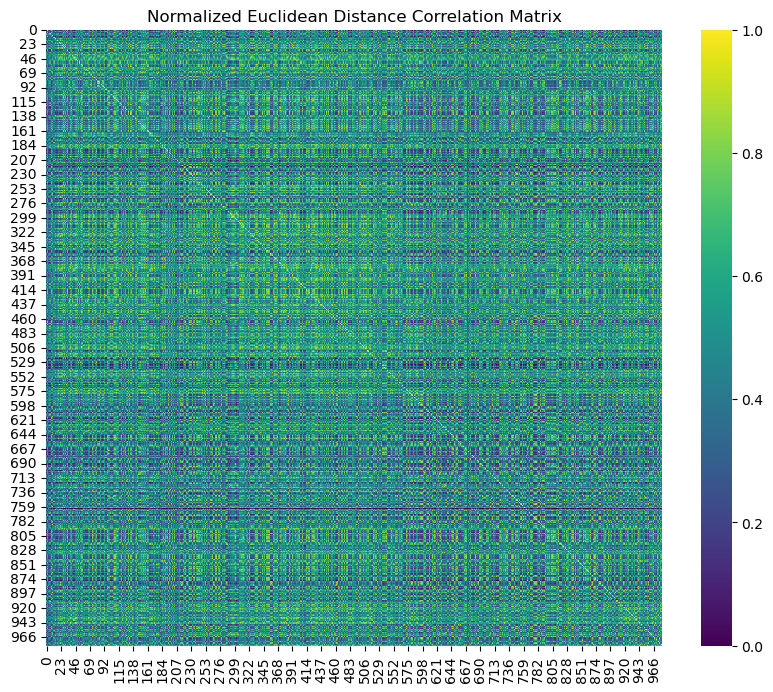

In [66]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import MinMaxScaler

# Step 1: Load all average poses into a single DataFrame
folder_path = "../Poses"  # Change this to the path of your folder
files = os.listdir(folder_path)

average_poses = pd.DataFrame()

for file in files:
    if file.endswith(".csv"):
        mouse_name = file.split("_")[0]  # Extract mouse name from the file name
        df = pd.read_csv(os.path.join(folder_path, file), index_col = 'cluster_label')
        df['Mouse'] = mouse_name
        average_poses = pd.concat([average_poses, df])
        
average_poses

# Step 2: Calculate Euclidean distances
pose_data = average_poses.drop(columns=['Mouse'])
distances = pairwise_distances(pose_data, metric='euclidean')

# Step 3: Normalize distances between 0 and 1
scaler = MinMaxScaler()
normalized_distances = scaler.fit_transform(distances)

# Step 4: Create a correlation matrix based on the normalized distances
correlation_matrix = 1 - normalized_distances

# Step 5: Plot the correlation matrix with borders
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, cmap='viridis', annot=False, cbar=True, square=True)
plt.title('Normalized Euclidean Distance Correlation Matrix')
plt.show()


## Epilogue
Currently the clustering works well for single mice. \
The latent space gets a bit too crowded and uniform when using all mice. We expect this is because the latent spaces of different mice need to be matched. \
Should you wish to perform UMAP dimensionality reduction and the HDBSCAN clustering on all mice, simply skip the [Extracting subset from the data](#Extracting-subset-from-the-data) section and use the original loaded `dataset` instead of `subset` in the rest of the notebook.